In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t45p45.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los45.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

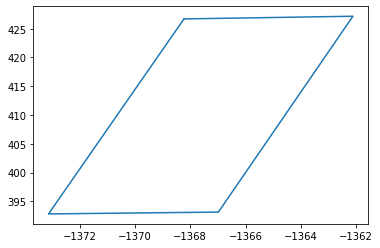

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

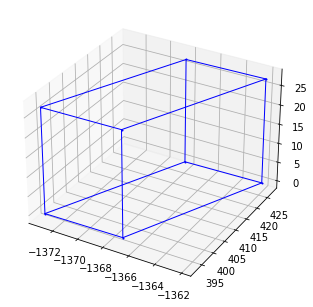

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 59/8644 [00:00<00:43, 197.26it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 512.31it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
# class BS:
#   def __init__(self, radius, max_height, carr_freq, interference_type):
#     self.radius = radius
#     self.max_height = max_height
#     self.carr_freq = carr_freq
#     self.interference_type = interference_type
#     self.base_heights = {
#         'UMi': 10,
#         'UMa': 25,
#         'RMa': 35,
#         None: random.randint(10, 35)
#     }
#     self.BS_x = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_y = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_z = self.base_heights[self.interference_type]

#   def BS_random_co_ordinates(self):
#     return self.BS_x, self.BS_y, self.BS_z
 
#   def UE_random_co_ordinates(self):
#     UE_x = random.randint(-4000,4000) + 1000*random.random()
#     UE_y = random.randint(-4000,4000) + 1000*random.random()
#     UE_z = random.uniform(0,1.5)
    
#     return UE_x, UE_y, UE_z

# # Creating the FSS class
#   def FSS_random_co_ordinates(self):

#     FSS_x = random.randint(-4000,4000) + 1000*random.random()
#     FSS_y = random.randint(-4000,4000) + 1000*random.random()
#     FSS_z = random.choice([1.5,4.5])
    
#     return FSS_x, FSS_y, FSS_z


In [21]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+ 21*math.log10(d_3D)+ 20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [22]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [23]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=4.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [24]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= -6.77     #8- 10* math.log10(30) #N=30, for 38dbm=8db
#         LBuildingLoss=1
        interface1=TXPower+ G_5G_R-pathloss_UMi- LBodyLoss + G_Rx_5G
        return interface1,pathloss_UMi

In [25]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface2=TXPower+ G_5G_R-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa

In [26]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface3=TXPower+ G_5G_R-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [27]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [28]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)

x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 8,
    'UMa': 48,
    'RMa': 5
}
  
exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, 0)
        FSS_Y = np.append(FSS_Y, 0)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 10)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                    
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

                    theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    theta_tilt=10
                    
                    
#                     x, y, z = BS_X[i]-FSS_X[j], BS_Y[i]-FSS_Y[j], (10-4.5)
#                     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#                     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#                     Angle_interferences_beam = (phi_bs_ue + phi_bs_es) 
#                     print("Angle between interference axis and Beams:",  Angle_interferences_beam )
#                     if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j],theta_tilt,phi_scan)
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference uma:", interfaceuma, "pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference rma:", interfacerma, "pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)

        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10)))
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10)))
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10)))
    
    
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight

In [29]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
    if coarse:
        theta = round(theta, rounding_precision)
        phi = round(phi, rounding_precision)
    if (theta, phi) in saved_tp:
        # print(f'match found for ({theta}, {phi}), using that')
        return saved_tp.get((theta, phi))
    
    
    
    # return max_parameters
    # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
    result = optimize.brute(
        lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
        # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
        ranges = [(-90, 90), (-180, 180)]
        
    )
    saved_tp[(theta, phi)] = tuple(x for x in result)
    
    return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
    summation = 0
    # weighting multiplied by the superposition vector
    for n in range(1, rows+1):
        for m in range(1, cols+1):
            # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
            summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

    return abs(summation)**2

# antenna gain of 5G base station (represented by a single beam i)
def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
    beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

    return gain_antenna_element(theta, phi) + \
           10 * math.log10(beam_pattern)

# space refers to D/λ
def get_phi_min(space) -> float:
    # Rec. ITU-R S.465-6
    if space >= 50:
        return max(1.0, 100 * (1 / space))
    else:
        return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
def gain_fss_s1428(phi, phi_min) -> float:

    if 0 < phi < phi_min:
        return 32 - 25 * math.log10(phi_min)
    elif phi_min <= phi < 48:
        return 32 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -10

    # This function is only defined where phi is within (0, 180]
    raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [30]:
# from tqdm import tqdm
# distance_RMa, I_N_RMa_W, I_N_RMa_noAverage, distance_UMa, I_N_UMa_W, I_N_UMa_noAverage, distance_UMi, I_N_UMi_W, I_N_UMi_noAverage, line_of_sight = [np.empty([0]) for x in range(10)]
# simulation_count = 10
# for i in tqdm(range(simulation_count)):
#    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)

#    distance_RMa = np.append(distance_RMa, distance_RMa_single)
#    # print(I_N_RMa_single_W)
#    I_N_RMa_W = np.append(I_N_RMa_W, I_N_RMa_single_W)
#    I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
   
#    distance_UMa = np.append(distance_UMa, distance_UMa_single)
#    I_N_UMa_W = np.append(I_N_UMa_W, I_N_UMa_single_W)
#    I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))

#    distance_UMi = np.append(distance_UMi, distance_UMi_single)
#    I_N_UMi_W = np.append(I_N_UMi_W, I_N_UMi_single_W)
#    I_N_UMi_noAverage = np.append(I_N_UMi_noAverage, 10 * np.log10(I_N_UMi_single_W))
    
#    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     arr[arr == -np.inf]=0
    
# I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
# I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))
# I_N_UMi = 10 * np.log10(np.average(I_N_UMi_W))

# pairs = {
#   'RMa': (np.average(distance_RMa), I_N_RMa),
#   'UMa': (np.average(distance_UMa), I_N_UMa),
#   'UMi': (np.average(distance_UMi), I_N_UMi)
# }

# pairs_noAverage = {
#   'RMa': (distance_RMa, I_N_RMa_noAverage),
#   'UMa': (distance_UMa, I_N_UMa_noAverage),
#   'UMi': (distance_UMi, I_N_UMi_noAverage)
# }


In [31]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 39%|██████████████████████████████▏                                              | 3205/8177 [00:07<00:13, 357.18it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6937/8177 [00:15<00:03, 408.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.50it/s]

 27%|████████████████████▌                                                        | 2187/8177 [00:05<00:14, 403.35it/s]


 72%|███████████████████████████████████████████████████████                      | 5851/8177 [00:12<00:04, 502.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.98it/s]

 14%|██████████▊                                                                  | 1145/8177 [00:02<00:15, 449.37it/s]


 59%|█████████████████████████████████████████████▍                               | 4821/8177 [00:10<00:06, 504.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.40it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:26, 297.95it/s]


 46%|███████████████████████████████████▍                                         | 3766/8177 [00:08<00:07, 583.66it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:15<00:01, 504.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.66it/s]

 34%|██████████████████████████▌                                                  | 2818/8177 [00:06<00:10, 489.92it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6513/8177 [00:13<00:03, 511.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.97it/s]

 23%|█████████████████▌                                                           | 1866/8177 [00:04<00:12, 525.71it/s]


 68%|████████████████████████████████████████████████████▏                        | 5545/8177 [00:11<00:04, 555.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.20it/s]

  9%|███████                                                                       | 735/8177 [00:02<00:16, 463.80it/s]


 53%|█████████████████████████████████████████                                    | 4364/8177 [00:09<00:07, 531.08it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7890/8177 [00:17<00:00, 425.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.59it/s]

 38%|████████████████████████████▉                                                | 3067/8177 [00:07<00:13, 384.27it/s]


 82%|███████████████████████████████████████████████████████████████              | 6693/8177 [00:14<00:02, 496.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.59it/s]

 23%|█████████████████▌                                                           | 1868/8177 [00:04<00:12, 496.25it/s]


 66%|██████████████████████████████████████████████████▍                          | 5356/8177 [00:11<00:06, 456.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.98it/s]

  7%|█████▎                                                                        | 554/8177 [00:01<00:22, 332.65it/s]


 50%|██████████████████████████████████████▋                                      | 4113/8177 [00:09<00:07, 532.36it/s]


 94%|████████████████████████████████████████████████████████████████████████▊    | 7726/8177 [00:16<00:01, 317.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.53it/s]

 35%|███████████████████████████▎                                                 | 2901/8177 [00:06<00:12, 422.93it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6462/8177 [00:14<00:03, 513.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.17it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:04<00:24, 286.66it/s]


 51%|███████████████████████████████████████▎                                     | 4175/8177 [00:11<00:10, 373.55it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7255/8177 [00:19<00:02, 449.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:21<00:00, 373.89it/s]

 21%|███████████████▊                                                             | 1678/8177 [00:05<00:13, 468.13it/s]


 60%|██████████████████████████████████████████████                               | 4886/8177 [00:13<00:07, 455.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:20<00:00, 405.90it/s]

  1%|▊                                                                              | 78/8177 [00:00<00:40, 198.73it/s]


 42%|████████████████████████████████                                             | 3402/8177 [00:08<00:10, 439.36it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7056/8177 [00:15<00:02, 379.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.51it/s]

 27%|████████████████████▍                                                        | 2169/8177 [00:05<00:13, 431.87it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5698/8177 [00:12<00:04, 536.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.87it/s]

 10%|████████▏                                                                     | 854/8177 [00:02<00:15, 460.95it/s]


 54%|█████████████████████████████████████████▌                                   | 4409/8177 [00:10<00:07, 529.60it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8044/8177 [00:17<00:00, 444.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.72it/s]

 38%|█████████████████████████████▏                                               | 3093/8177 [00:07<00:12, 395.43it/s]


 82%|███████████████████████████████████████████████████████████████▌             | 6746/8177 [00:14<00:02, 507.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.91it/s]

 23%|█████████████████▍                                                           | 1852/8177 [00:04<00:13, 481.49it/s]


 65%|██████████████████████████████████████████████████▎                          | 5344/8177 [00:12<00:05, 503.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.58it/s]

  6%|████▊                                                                         | 500/8177 [00:01<00:22, 338.43it/s]


 49%|█████████████████████████████████████▌                                       | 3985/8177 [00:09<00:08, 519.22it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7585/8177 [00:16<00:01, 484.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 449.81it/s]

 32%|████████████████████████▊                                                    | 2636/8177 [00:06<00:11, 484.21it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6198/8177 [00:13<00:03, 539.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.69it/s]

 17%|████████████▋                                                                | 1352/8177 [00:03<00:14, 485.98it/s]


 59%|█████████████████████████████████████████████▌                               | 4843/8177 [00:11<00:06, 478.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 443.70it/s]

  1%|▋                                                                              | 77/8177 [00:00<00:41, 193.93it/s]


 42%|████████████████████████████████▍                                            | 3442/8177 [00:08<00:10, 434.98it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7134/8177 [00:15<00:02, 379.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.52it/s]

 29%|██████████████████████▎                                                      | 2374/8177 [00:05<00:18, 314.99it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6002/8177 [00:13<00:04, 516.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.74it/s]

 15%|███████████▎                                                                 | 1200/8177 [00:03<00:15, 442.68it/s]


 59%|█████████████████████████████████████████████▌                               | 4832/8177 [00:10<00:06, 506.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.57it/s]

  1%|█                                                                             | 113/8177 [00:00<00:33, 237.99it/s]


 42%|████████████████████████████████▍                                            | 3450/8177 [00:08<00:10, 447.05it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7140/8177 [00:15<00:02, 393.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.78it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:13, 444.06it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5864/8177 [00:12<00:04, 493.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.18it/s]

 13%|█████████▋                                                                   | 1035/8177 [00:02<00:12, 585.97it/s]


 57%|████████████████████████████████████████████                                 | 4685/8177 [00:10<00:06, 555.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.15it/s]

  1%|▌                                                                              | 58/8177 [00:00<00:32, 252.70it/s]


 41%|███████████████████████████████▋                                             | 3362/8177 [00:08<00:12, 397.61it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6957/8177 [00:15<00:02, 493.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.74it/s]

 26%|████████████████████                                                         | 2137/8177 [00:05<00:12, 470.56it/s]


 68%|████████████████████████████████████████████████████▌                        | 5579/8177 [00:12<00:05, 519.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 449.42it/s]

  8%|██████▍                                                                       | 673/8177 [00:02<00:19, 393.43it/s]


 52%|████████████████████████████████████████                                     | 4255/8177 [00:09<00:07, 515.83it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7787/8177 [00:17<00:01, 357.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.84it/s]

 35%|██████████████████████████▊                                                  | 2844/8177 [00:06<00:11, 449.26it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6284/8177 [00:14<00:03, 525.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 444.27it/s]

 17%|████████████▉                                                                | 1377/8177 [00:03<00:14, 477.04it/s]


 58%|████████████████████████████████████████████▍                                | 4720/8177 [00:11<00:07, 484.22it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8093/8177 [00:18<00:00, 492.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 428.75it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:07<00:13, 382.91it/s]


 81%|██████████████████████████████████████████████████████████████               | 6593/8177 [00:14<00:03, 413.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 441.17it/s]

 22%|████████████████▊                                                            | 1781/8177 [00:04<00:11, 536.51it/s]


 63%|████████████████████████████████████████████████▋                            | 5174/8177 [00:11<00:05, 506.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.99it/s]

  5%|████▎                                                                         | 448/8177 [00:01<00:20, 370.36it/s]


 50%|██████████████████████████████████████▍                                      | 4083/8177 [00:09<00:08, 495.18it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7803/8177 [00:17<00:00, 381.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.57it/s]

 38%|████████████████████████████▉                                                | 3072/8177 [00:07<00:13, 392.39it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6872/8177 [00:14<00:02, 541.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.40it/s]

 27%|████████████████████▊                                                        | 2206/8177 [00:05<00:15, 391.61it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5806/8177 [00:12<00:04, 480.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.17it/s]

 14%|██████████▋                                                                  | 1129/8177 [00:02<00:16, 414.99it/s]


 60%|██████████████████████████████████████████████                               | 4898/8177 [00:10<00:06, 488.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.26it/s]

  3%|██▌                                                                           | 275/8177 [00:00<00:21, 368.54it/s]


 48%|████████████████████████████████████▉                                        | 3927/8177 [00:08<00:07, 556.13it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7686/8177 [00:16<00:01, 320.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.85it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:06<00:11, 472.93it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6549/8177 [00:14<00:03, 489.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.73it/s]

 23%|█████████████████▍                                                           | 1853/8177 [00:04<00:12, 503.91it/s]


 67%|███████████████████████████████████████████████████▍                         | 5465/8177 [00:12<00:04, 551.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.66it/s]

  8%|██████                                                                        | 635/8177 [00:01<00:21, 350.90it/s]


 53%|████████████████████████████████████████▉                                    | 4348/8177 [00:09<00:07, 508.52it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8043/8177 [00:17<00:00, 462.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.03it/s]

 39%|██████████████████████████████                                               | 3194/8177 [00:07<00:13, 359.55it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6924/8177 [00:15<00:02, 521.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.69it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:04<00:12, 472.77it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5761/8177 [00:12<00:04, 511.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.48it/s]

 11%|████████▎                                                                     | 872/8177 [00:02<00:16, 440.86it/s]


 56%|██████████████████████████████████████████▉                                  | 4561/8177 [00:10<00:06, 563.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.27it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 41%|███████████████████████████████▌                                             | 3353/8177 [00:08<00:12, 400.69it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7099/8177 [00:15<00:02, 376.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.58it/s]

 29%|██████████████████████▎                                                      | 2366/8177 [00:05<00:17, 330.26it/s]


 73%|████████████████████████████████████████████████████████                     | 5955/8177 [00:13<00:04, 484.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.05it/s]

 14%|███████████▏                                                                 | 1185/8177 [00:03<00:15, 442.19it/s]


 60%|█████████████████████████████████████████████▊                               | 4867/8177 [00:10<00:06, 473.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.29it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:29, 272.41it/s]


 46%|███████████████████████████████████▌                                         | 3781/8177 [00:08<00:08, 529.27it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7538/8177 [00:16<00:01, 482.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.13it/s]

 34%|█████████████████████████▉                                                   | 2755/8177 [00:06<00:10, 532.77it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6397/8177 [00:13<00:03, 536.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.79it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:04<00:12, 514.96it/s]


 65%|██████████████████████████████████████████████████▏                          | 5332/8177 [00:11<00:06, 460.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.57it/s]

  7%|█████▎                                                                        | 556/8177 [00:01<00:23, 329.82it/s]


 53%|████████████████████████████████████████▉                                    | 4341/8177 [00:09<00:07, 510.45it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8045/8177 [00:17<00:00, 458.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.73it/s]

 39%|██████████████████████████████▏                                              | 3207/8177 [00:07<00:14, 347.25it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7017/8177 [00:14<00:02, 452.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.14it/s]

 28%|█████████████████████▋                                                       | 2304/8177 [00:05<00:13, 449.99it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6008/8177 [00:13<00:04, 505.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.99it/s]

 17%|████████████▋                                                                | 1351/8177 [00:03<00:13, 508.07it/s]


 61%|███████████████████████████████████████████████▏                             | 5016/8177 [00:11<00:06, 511.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.39it/s]

  5%|███▌                                                                          | 371/8177 [00:01<00:20, 385.04it/s]


 48%|█████████████████████████████████████▏                                       | 3955/8177 [00:09<00:07, 533.16it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7748/8177 [00:16<00:01, 331.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.94it/s]

 36%|████████████████████████████                                                 | 2983/8177 [00:07<00:14, 370.25it/s]


 81%|██████████████████████████████████████████████████████████████               | 6588/8177 [00:14<00:03, 450.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.87it/s]

 21%|████████████████▏                                                            | 1714/8177 [00:04<00:13, 493.18it/s]


 63%|████████████████████████████████████████████████▍                            | 5148/8177 [00:12<00:06, 458.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 437.03it/s]

  4%|███▍                                                                          | 361/8177 [00:01<00:20, 387.84it/s]


 47%|███████████████████████████████████▊                                         | 3805/8177 [00:09<00:08, 508.43it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7278/8177 [00:16<00:02, 442.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 441.00it/s]

 29%|██████████████████████▎                                                      | 2372/8177 [00:05<00:19, 303.90it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5776/8177 [00:13<00:05, 470.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 440.52it/s]

  9%|██████▉                                                                       | 728/8177 [00:02<00:16, 450.44it/s]


 53%|████████████████████████████████████████▍                                    | 4300/8177 [00:09<00:07, 542.94it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7855/8177 [00:17<00:00, 419.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.56it/s]

 36%|████████████████████████████                                                 | 2984/8177 [00:07<00:15, 330.47it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6494/8177 [00:14<00:03, 473.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 449.72it/s]

 20%|███████████████▊                                                             | 1676/8177 [00:04<00:13, 482.16it/s]


 64%|█████████████████████████████████████████████████▎                           | 5241/8177 [00:11<00:05, 494.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.83it/s]

  5%|████▏                                                                         | 442/8177 [00:01<00:21, 367.15it/s]


 49%|█████████████████████████████████████▌                                       | 3991/8177 [00:09<00:08, 514.16it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7703/8177 [00:16<00:01, 313.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.18it/s]

 36%|███████████████████████████▍                                                 | 2913/8177 [00:06<00:13, 396.25it/s]


 78%|████████████████████████████████████████████████████████████                 | 6376/8177 [00:14<00:03, 486.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.22it/s]

 17%|█████████████▏                                                               | 1396/8177 [00:03<00:12, 534.86it/s]


 61%|██████████████████████████████████████████████▌                              | 4951/8177 [00:11<00:06, 496.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.33it/s]

  3%|██                                                                            | 215/8177 [00:00<00:25, 312.25it/s]


 44%|██████████████████████████████████▏                                          | 3631/8177 [00:08<00:08, 554.32it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7173/8177 [00:15<00:02, 412.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.05it/s]

 28%|█████████████████████▋                                                       | 2309/8177 [00:05<00:13, 429.31it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5809/8177 [00:13<00:04, 481.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.26it/s]

 11%|████████▏                                                                     | 859/8177 [00:02<00:16, 439.44it/s]


 55%|██████████████████████████████████████████                                   | 4462/8177 [00:10<00:06, 552.63it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8030/8177 [00:17<00:00, 430.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.81it/s]

 38%|█████████████████████████████▏                                               | 3098/8177 [00:07<00:12, 391.42it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6730/8177 [00:14<00:02, 501.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 454.11it/s]

 23%|█████████████████▋                                                           | 1875/8177 [00:04<00:12, 507.35it/s]


 66%|██████████████████████████████████████████████████▉                          | 5408/8177 [00:12<00:05, 500.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.11it/s]

  7%|█████                                                                         | 537/8177 [00:01<00:23, 320.24it/s]


 50%|██████████████████████████████████████▌                                      | 4095/8177 [00:09<00:07, 518.13it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7737/8177 [00:17<00:01, 326.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 454.24it/s]

 35%|███████████████████████████▏                                                 | 2888/8177 [00:06<00:11, 470.47it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6429/8177 [00:14<00:03, 497.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.06it/s]

 18%|██████████████▏                                                              | 1503/8177 [00:03<00:12, 532.18it/s]


 63%|████████████████████████████████████████████████▏                            | 5118/8177 [00:11<00:06, 478.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.94it/s]

  4%|███▍                                                                          | 358/8177 [00:01<00:20, 387.09it/s]


 47%|████████████████████████████████████▎                                        | 3855/8177 [00:09<00:08, 520.00it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7484/8177 [00:16<00:01, 585.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.40it/s]

 32%|████████████████████████▋                                                    | 2622/8177 [00:06<00:11, 478.13it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6175/8177 [00:13<00:03, 541.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.86it/s]

 16%|████████████▋                                                                | 1342/8177 [00:03<00:13, 515.23it/s]


 60%|██████████████████████████████████████████████▍                              | 4938/8177 [00:11<00:06, 500.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.05it/s]

  2%|█▊                                                                            | 189/8177 [00:00<00:27, 288.73it/s]


 45%|██████████████████████████████████▍                                          | 3654/8177 [00:08<00:08, 564.53it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7244/8177 [00:15<00:02, 436.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.39it/s]

 30%|███████████████████████▏                                                     | 2466/8177 [00:05<00:14, 398.37it/s]


 74%|█████████████████████████████████████████████████████████                    | 6056/8177 [00:13<00:03, 547.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.20it/s]

 16%|████████████▌                                                                | 1331/8177 [00:03<00:12, 532.24it/s]


 60%|██████████████████████████████████████████████▏                              | 4905/8177 [00:10<00:06, 475.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.78it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:27, 291.31it/s]


 45%|██████████████████████████████████▊                                          | 3699/8177 [00:08<00:08, 553.41it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7432/8177 [00:15<00:01, 603.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.39it/s]

 32%|████████████████████████▋                                                    | 2622/8177 [00:06<00:11, 480.13it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6184/8177 [00:13<00:03, 547.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.23it/s]

 18%|█████████████▌                                                               | 1442/8177 [00:03<00:12, 537.89it/s]


 62%|███████████████████████████████████████████████▋                             | 5062/8177 [00:11<00:06, 517.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.72it/s]

  4%|███                                                                           | 321/8177 [00:01<00:19, 394.29it/s]


 47%|████████████████████████████████████▎                                        | 3851/8177 [00:08<00:07, 557.68it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7519/8177 [00:16<00:01, 517.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.83it/s]

 34%|█████████████████████████▊                                                   | 2746/8177 [00:06<00:10, 504.48it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6321/8177 [00:13<00:03, 553.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.01it/s]

 18%|██████████████                                                               | 1488/8177 [00:03<00:12, 553.57it/s]


 62%|███████████████████████████████████████████████▌                             | 5053/8177 [00:11<00:06, 505.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.47it/s]

  4%|███                                                                           | 320/8177 [00:00<00:20, 385.41it/s]


 47%|████████████████████████████████████▌                                        | 3884/8177 [00:08<00:07, 551.08it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7602/8177 [00:16<00:01, 478.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.79it/s]

 55%|██████████████████████████████████████████                                   | 4463/8177 [00:06<00:04, 858.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.45it/s]

 21%|███████████████▉                                                             | 1697/8177 [00:02<00:08, 776.67it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 686.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.58it/s]

 55%|██████████████████████████████████████████                                   | 4466/8177 [00:06<00:04, 866.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.07it/s]

 23%|█████████████████▋                                                           | 1884/8177 [00:02<00:07, 800.21it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7464/8177 [00:10<00:00, 858.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.52it/s]

 57%|████████████████████████████████████████████▏                                | 4687/8177 [00:06<00:03, 883.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.19it/s]

 25%|███████████████████                                                          | 2020/8177 [00:02<00:07, 779.15it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7729/8177 [00:10<00:00, 606.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 36%|████████████████████████████                                                 | 2982/8177 [00:07<00:14, 348.96it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6556/8177 [00:14<00:03, 503.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.08it/s]

 21%|████████████████▍                                                            | 1742/8177 [00:04<00:13, 494.75it/s]


 64%|█████████████████████████████████████████████████▎                           | 5232/8177 [00:11<00:06, 481.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.29it/s]

  5%|███▊                                                                          | 398/8177 [00:01<00:20, 373.90it/s]


 47%|████████████████████████████████████▍                                        | 3874/8177 [00:09<00:07, 538.01it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7415/8177 [00:16<00:01, 553.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 441.18it/s]

 32%|████████████████████████▎                                                    | 2585/8177 [00:06<00:12, 464.30it/s]


 75%|██████████████████████████████████████████████████████████                   | 6162/8177 [00:13<00:03, 533.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.40it/s]

 17%|█████████████                                                                | 1384/8177 [00:03<00:13, 506.58it/s]


 61%|███████████████████████████████████████████████                              | 5003/8177 [00:11<00:06, 467.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.89it/s]

  4%|███                                                                           | 323/8177 [00:01<00:20, 382.24it/s]


 46%|███████████████████████████████████▌                                         | 3779/8177 [00:08<00:08, 509.64it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7479/8177 [00:16<00:01, 573.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 449.05it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -188.0766476508776 / pathloss: 125.47617490800064
UE: 136 / interference umi: -199.2166751695732 / pathloss: 125.47617490800064
UE: 575 / interference umi: -189.3641151218339 / pathloss: 125.47617490800064
UE: 573 / interference umi: -192.97958282173298 / pathloss: 125.47617490800064
UE: 697 / interference umi: -192.45923839374302 / pathloss: 125.47617490800064
UE: 478 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 359 / interference umi: -187.75397485359514 / pathloss: 125.47617490800064
UE: 807 / interference umi: -188.44063996494873 / pathloss: 125.47617490800064
UE: 45 / interference umi: -187.6865837277192 / pathloss: 125.47617490800064
UE: 903 / interference umi: -175.8039186027831 / pathloss: 125.47617490800064
UE: 731 / interference umi: -218.5960797455619 / pathloss: 125.47617490800064
UE: 773 / interference umi: -207.6814502164664 / pathloss: 125.47617490800064
UE: 278 / interferenc

UE: 756 / interference umi: -170.15670796464352 / pathloss: 125.47617490800064
UE: 715 / interference umi: -172.50984082824863 / pathloss: 125.47617490800064
UE: 93 / interference umi: -182.460447331487 / pathloss: 125.47617490800064
UE: 609 / interference umi: -144.94637825117164 / pathloss: 125.47617490800064
UE: 676 / interference umi: -158.34100143882773 / pathloss: 125.47617490800064
UE: 702 / interference umi: -163.72079854053598 / pathloss: 125.47617490800064
UE: 137 / interference umi: -164.95026925702533 / pathloss: 125.47617490800064
UE: 215 / interference umi: -182.87990578636132 / pathloss: 125.47617490800064
UE: 370 / interference umi: -180.10444192066925 / pathloss: 125.47617490800064
UE: 826 / interference umi: -158.29787688766274 / pathloss: 125.47617490800064
UE: 31 / interference umi: -161.5589892403868 / pathloss: 125.47617490800064
UE: 260 / interference umi: -163.55584426831817 / pathloss: 125.47617490800064
UE: 169 / interference umi: -154.35507974046925 / pathlos

UE: 631 / interference umi: -159.79421470227012 / pathloss: 125.47617490800064
UE: 742 / interference umi: -160.03900254405045 / pathloss: 125.47617490800064
UE: 857 / interference umi: -166.446607779668 / pathloss: 125.47617490800064
UE: 189 / interference umi: -162.53375449221224 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 807 / interference umi: -181.38261772252554 / pathloss: 125.47617490800064
UE: 245 / interference umi: -199.39084649142382 / pathloss: 125.47617490800064
UE: 729 / interference umi: -199.97124294359514 / pathloss: 125.47617490800064
UE: 458 / interference umi: -203.18148859894322 / pathloss: 125.47617490800064
UE: 529 / interference umi: -197.05070259500508 / pathloss: 125.47617490800064
UE: 511 / interference umi: -200.1361982650038 / pathloss: 125.47617490800064
UE: 643 / interference umi: -178.0690255878443 / pathloss: 125.47617490800064
UE: 654 / interference umi: -197.4530176119764 / pathloss: 125.47617490800064
UE: 349 / interf

UE: 426 / interference umi: -188.9071154492051 / pathloss: 125.47617490800064
UE: 102 / interference umi: -164.32454245689252 / pathloss: 125.47617490800064
UE: 401 / interference umi: -186.42154806542925 / pathloss: 125.47617490800064
UE: 376 / interference umi: -202.78632094047913 / pathloss: 125.47617490800064
UE: 672 / interference umi: -192.2857123453907 / pathloss: 125.47617490800064
UE: 871 / interference umi: -183.5143713724563 / pathloss: 125.47617490800064
UE: 752 / interference umi: -185.8065125511933 / pathloss: 125.47617490800064
UE: 889 / interference umi: -185.92835070329062 / pathloss: 125.47617490800064
UE: 778 / interference umi: -179.5891434660511 / pathloss: 125.47617490800064
UE: 350 / interference umi: -183.75902449137976 / pathloss: 125.47617490800064
UE: 775 / interference umi: -187.69529152651467 / pathloss: 125.47617490800064
UE: 820 / interference umi: -189.2639696861101 / pathloss: 125.47617490800064
UE: 430 / interference umi: -194.10835009753544 / pathloss

UE: 325 / interference umi: -214.05473166041259 / pathloss: 125.47617490800064
UE: 594 / interference umi: -180.01605189148137 / pathloss: 125.47617490800064
UE: 47 / interference umi: -208.60627358729096 / pathloss: 125.47617490800064
UE: 847 / interference umi: -202.6632154498583 / pathloss: 125.47617490800064
UE: 810 / interference umi: -185.24097129568548 / pathloss: 125.47617490800064
UE: 265 / interference umi: -181.09436087006256 / pathloss: 125.47617490800064
UE: 771 / interference umi: -180.82590445784342 / pathloss: 125.47617490800064
UE: 872 / interference umi: -204.1050473578257 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 707 / interference umi: -169.79881024517573 / pathloss: 125.47617490800064
UE: 942 / interference umi: -152.99569038378172 / pathloss: 125.47617490800064
UE: 529 / interference umi: -155.09656461105587 / pathloss: 125.47617490800064
UE: 900 / interference umi: -191.87806024350124 / pathloss: 125.47617490800064
UE: 853 / int

UE: 281 / interference umi: -166.68730079562604 / pathloss: 125.47617490800064
UE: 71 / interference umi: -173.05495912979802 / pathloss: 125.47617490800064
UE: 834 / interference umi: -181.7872024391177 / pathloss: 125.47617490800064
UE: 416 / interference umi: -168.0656493338784 / pathloss: 125.47617490800064
UE: 12 / interference umi: -184.86160012243994 / pathloss: 125.47617490800064
UE: 872 / interference umi: -184.1956643951204 / pathloss: 125.47617490800064
UE: 19 / interference umi: -167.9854564528651 / pathloss: 125.47617490800064
UE: 671 / interference umi: -168.06565068601157 / pathloss: 125.47617490800064
UE: 386 / interference umi: -169.14941437685098 / pathloss: 125.47617490800064
UE: 197 / interference umi: -167.0469344667373 / pathloss: 125.47617490800064
UE: 124 / interference umi: -165.91739847425157 / pathloss: 125.47617490800064
UE: 899 / interference umi: -173.3469497564443 / pathloss: 125.47617490800064
UE: 543 / interference umi: -156.4168574801862 / pathloss: 12

UE: 279 / interference umi: -192.75704586455407 / pathloss: 125.47617490800064
UE: 75 / interference umi: -205.30937173076586 / pathloss: 125.47617490800064
UE: 282 / interference umi: -180.30061587613557 / pathloss: 125.47617490800064
UE: 138 / interference umi: -179.74801874913055 / pathloss: 125.47617490800064
UE: 125 / interference umi: -199.6515098803979 / pathloss: 125.47617490800064
UE: 532 / interference umi: -194.4574800931818 / pathloss: 125.47617490800064
UE: 546 / interference umi: -209.28675334891835 / pathloss: 125.47617490800064
UE: 950 / interference umi: -201.2897996677209 / pathloss: 125.47617490800064
UE: 38 / interference umi: -204.97410479062813 / pathloss: 125.47617490800064
UE: 965 / interference umi: -204.8545515418653 / pathloss: 125.47617490800064
UE: 786 / interference umi: -214.49677206358223 / pathloss: 125.47617490800064
UE: 61 / interference umi: -203.2608632767251 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 467 / interfer

UE: 658 / interference umi: -159.3462543727848 / pathloss: 125.47617490800064
UE: 344 / interference umi: -160.29032525661412 / pathloss: 125.47617490800064
UE: 837 / interference umi: -180.04794491615928 / pathloss: 125.47617490800064
UE: 932 / interference umi: -185.68015800067016 / pathloss: 125.47617490800064
UE: 229 / interference umi: -169.87013394349032 / pathloss: 125.47617490800064
UE: 445 / interference umi: -171.4523022872429 / pathloss: 125.47617490800064
UE: 503 / interference umi: -166.3805453821564 / pathloss: 125.47617490800064
UE: 224 / interference umi: -175.73532869377658 / pathloss: 125.47617490800064
UE: 100 / interference umi: -180.93577455419813 / pathloss: 125.47617490800064
UE: 268 / interference umi: -170.2622198436063 / pathloss: 125.47617490800064
UE: 783 / interference umi: -168.2984163829316 / pathloss: 125.47617490800064
UE: 440 / interference umi: -186.4773290283625 / pathloss: 125.47617490800064
UE: 415 / interference umi: -151.52922893543513 / pathloss

UE: 785 / interference umi: -183.1038746869662 / pathloss: 125.47617490800064
UE: 776 / interference umi: -198.24405749939444 / pathloss: 125.47617490800064
UE: 982 / interference umi: -186.17830986393002 / pathloss: 125.47617490800064
UE: 561 / interference umi: -179.98493082618464 / pathloss: 125.47617490800064
UE: 399 / interference umi: -186.97867662801457 / pathloss: 125.47617490800064
UE: 283 / interference umi: -182.24441896196677 / pathloss: 125.47617490800064
UE: 875 / interference umi: -182.7945177376263 / pathloss: 125.47617490800064
UE: 212 / interference umi: -181.11188605964117 / pathloss: 125.47617490800064
UE: 322 / interference umi: -189.44158564140764 / pathloss: 125.47617490800064
UE: 471 / interference umi: -191.56168839697628 / pathloss: 125.47617490800064
UE: 525 / interference umi: -181.5008288640709 / pathloss: 125.47617490800064
UE: 445 / interference umi: -183.95807563763023 / pathloss: 125.47617490800064
UE: 608 / interference umi: -186.53900113218862 / pathl

UE: 54 / interference umi: -157.15199777768152 / pathloss: 125.47617490800064
UE: 700 / interference umi: -176.62253971483727 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 757 / interference umi: -184.22625679210046 / pathloss: 125.47617490800064
UE: 182 / interference umi: -181.2030728372823 / pathloss: 125.47617490800064
UE: 741 / interference umi: -169.60486414631308 / pathloss: 125.47617490800064
UE: 103 / interference umi: -187.01338424361595 / pathloss: 125.47617490800064
UE: 457 / interference umi: -186.08138766553168 / pathloss: 125.47617490800064
UE: 187 / interference umi: -188.76052271655442 / pathloss: 125.47617490800064
UE: 518 / interference umi: -201.458779089682 / pathloss: 125.47617490800064
UE: 268 / interference umi: -184.6882038317304 / pathloss: 125.47617490800064
UE: 731 / interference umi: -188.38917810256333 / pathloss: 125.47617490800064
UE: 208 / interference umi: -184.73077551007577 / pathloss: 125.47617490800064
UE: 342 / inter

C:\Users\tniloy\AppData\Local\Temp\ipykernel_6648\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 64%|█████████████████████████████████████████████████▋                           | 5271/8177 [00:07<00:03, 801.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 725.13it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 636.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 714.48it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▊                        | 5611/8177 [00:07<00:02, 856.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.67it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 602.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.34it/s]

  7%|█████▏                                                                        | 541/8177 [00:01<00:13, 567.93it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6371/8177 [00:08<00:02, 875.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.13it/s]

 45%|██████████████████████████████████▍                                          | 3657/8177 [00:05<00:05, 849.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.67it/s]

 15%|███████████▎                                                                 | 1202/8177 [00:01<00:09, 732.47it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7158/8177 [00:09<00:01, 677.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.97it/s]

 56%|███████████████████████████████████████████▏                                 | 4585/8177 [00:06<00:03, 900.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.52it/s]

 25%|███████████████████                                                          | 2027/8177 [00:02<00:08, 749.91it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7884/8177 [00:10<00:00, 662.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.98it/s]

 64%|█████████████████████████████████████████████████▋                           | 5270/8177 [00:07<00:03, 815.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.82it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 801.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.26it/s]

  3%|██                                                                            | 210/8177 [00:00<00:16, 477.29it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5934/8177 [00:08<00:02, 749.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.87it/s]

 39%|██████████████████████████████▏                                              | 3201/8177 [00:04<00:08, 590.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.54it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:11, 661.34it/s]


 81%|██████████████████████████████████████████████████████████████               | 6595/8177 [00:08<00:02, 728.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.27it/s]

 48%|████████████████████████████████████▉                                        | 3925/8177 [00:05<00:04, 871.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.19it/s]

 20%|███████████████                                                              | 1601/8177 [00:02<00:08, 780.90it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7586/8177 [00:10<00:00, 771.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.79it/s]

 61%|██████████████████████████████████████████████▊                              | 4972/8177 [00:06<00:03, 819.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.06it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 582.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:21, 373.11it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5840/8177 [00:07<00:02, 841.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.09it/s]

 39%|█████████████████████████████▊                                               | 3172/8177 [00:04<00:08, 619.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.57it/s]

  7%|█████▋                                                                        | 592/8177 [00:01<00:14, 521.53it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6514/8177 [00:08<00:02, 824.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.13it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 890.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.39it/s]

 17%|█████████████▏                                                               | 1400/8177 [00:02<00:08, 815.92it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 703.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.74it/s]

 59%|█████████████████████████████████████████████▏                               | 4793/8177 [00:06<00:04, 819.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.17it/s]

 28%|█████████████████████▋                                                       | 2302/8177 [00:03<00:08, 714.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.44it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▊                        | 5608/8177 [00:07<00:03, 798.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.82it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 648.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.87it/s]

  7%|█████▋                                                                        | 592/8177 [00:01<00:14, 519.20it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6537/8177 [00:08<00:02, 814.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.27it/s]

 48%|█████████████████████████████████████▏                                       | 3953/8177 [00:05<00:04, 875.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.00it/s]

 18%|█████████████▋                                                               | 1449/8177 [00:02<00:07, 860.13it/s]


 90%|████████████████████████████████████████████████████████████████████▉        | 7325/8177 [00:09<00:01, 778.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.12it/s]

 57%|███████████████████████████████████████████▊                                 | 4655/8177 [00:06<00:03, 886.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.17it/s]

 26%|████████████████████                                                         | 2125/8177 [00:03<00:07, 777.85it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 731.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.27it/s]

 64%|█████████████████████████████████████████████████▌                           | 5265/8177 [00:07<00:03, 800.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.65it/s]

 33%|█████████████████████████                                                    | 2664/8177 [00:03<00:07, 725.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.97it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:18, 431.10it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5903/8177 [00:07<00:02, 833.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.39it/s]

 41%|███████████████████████████████▍                                             | 3333/8177 [00:04<00:08, 604.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.91it/s]

 11%|████████▎                                                                     | 870/8177 [00:01<00:09, 730.74it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6839/8177 [00:09<00:01, 789.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.26it/s]

 51%|███████████████████████████████████████▎                                     | 4173/8177 [00:05<00:04, 870.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.32it/s]

 20%|███████████████▏                                                             | 1616/8177 [00:02<00:08, 786.89it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7665/8177 [00:10<00:00, 613.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.26it/s]

 61%|███████████████████████████████████████████████▎                             | 5019/8177 [00:06<00:03, 834.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.45it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 681.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.05it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 372.87it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5899/8177 [00:07<00:02, 819.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.67it/s]

 41%|███████████████████████████████▏                                             | 3313/8177 [00:04<00:08, 605.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.30it/s]

 10%|███████▋                                                                      | 801/8177 [00:01<00:11, 651.81it/s]


 82%|███████████████████████████████████████████████████████████████              | 6702/8177 [00:08<00:01, 807.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.42it/s]

 50%|██████████████████████████████████████▍                                      | 4081/8177 [00:05<00:04, 846.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.64it/s]

 20%|███████████████▌                                                             | 1647/8177 [00:02<00:08, 797.53it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7557/8177 [00:10<00:00, 749.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.89it/s]

 60%|█████████████████████████████████████████████▊                               | 4870/8177 [00:06<00:03, 845.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.28it/s]

 27%|█████████████████████▏                                                       | 2247/8177 [00:03<00:08, 681.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.97it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5642/8177 [00:07<00:03, 821.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.03it/s]

 37%|████████████████████████████▍                                                | 3022/8177 [00:04<00:08, 595.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.88it/s]

  6%|████▊                                                                         | 511/8177 [00:01<00:14, 530.09it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6370/8177 [00:08<00:02, 882.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.89it/s]

 46%|███████████████████████████████████▋                                         | 3795/8177 [00:05<00:05, 843.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.20it/s]

 16%|███████████▉                                                                 | 1270/8177 [00:01<00:08, 786.56it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7092/8177 [00:09<00:01, 652.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.66it/s]

 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:06<00:04, 894.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.26it/s]

 24%|██████████████████▏                                                          | 1931/8177 [00:02<00:07, 827.13it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7863/8177 [00:10<00:00, 667.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.24it/s]

 63%|████████████████████████████████████████████████▋                            | 5173/8177 [00:07<00:03, 768.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.34it/s]

 29%|██████████████████████▎                                                      | 2367/8177 [00:03<00:10, 569.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.16it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5592/8177 [00:07<00:03, 861.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.95it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 602.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.95it/s]

  6%|████▍                                                                         | 462/8177 [00:00<00:14, 544.27it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6415/8177 [00:08<00:02, 865.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.78it/s]

 45%|██████████████████████████████████▍                                          | 3662/8177 [00:05<00:05, 805.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.08it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 705.51it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7027/8177 [00:09<00:01, 697.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.32it/s]

 55%|██████████████████████████████████████████▍                                  | 4504/8177 [00:06<00:04, 888.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.36it/s]

 25%|███████████████████▍                                                         | 2058/8177 [00:02<00:08, 755.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.15it/s]



 68%|████████████████████████████████████████████████████▌                        | 5586/8177 [00:07<00:03, 857.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.89it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 658.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.16it/s]

  7%|█████▋                                                                        | 592/8177 [00:01<00:14, 514.34it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6581/8177 [00:08<00:01, 843.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.36it/s]

 50%|██████████████████████████████████████▎                                      | 4066/8177 [00:05<00:04, 882.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.40it/s]

 19%|██████████████▊                                                              | 1579/8177 [00:02<00:08, 752.49it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7481/8177 [00:09<00:00, 856.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.52it/s]

 61%|██████████████████████████████████████████████▋                              | 4954/8177 [00:06<00:04, 800.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.19it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:10, 566.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.61it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 359.73it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5817/8177 [00:07<00:02, 823.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.90it/s]

 39%|██████████████████████████████▏                                              | 3212/8177 [00:04<00:08, 579.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.59it/s]

  9%|███████▏                                                                      | 749/8177 [00:01<00:10, 711.22it/s]


 82%|███████████████████████████████████████████████████████████████▌             | 6746/8177 [00:08<00:01, 833.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.67it/s]

 51%|███████████████████████████████████████▎                                     | 4172/8177 [00:05<00:04, 807.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.38it/s]

 21%|████████████████                                                             | 1707/8177 [00:02<00:08, 783.81it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7608/8177 [00:10<00:00, 778.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.24it/s]

 63%|████████████████████████████████████████████████▎                            | 5133/8177 [00:07<00:03, 780.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.03it/s]

 30%|███████████████████████▍                                                     | 2486/8177 [00:03<00:08, 649.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.79it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 448.03it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5793/8177 [00:07<00:02, 815.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.47it/s]

 39%|██████████████████████████████▎                                              | 3222/8177 [00:04<00:08, 568.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.68it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:12, 621.62it/s]


 82%|███████████████████████████████████████████████████████████████              | 6702/8177 [00:08<00:01, 816.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.42it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 835.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.32it/s]

 21%|███████████████▊                                                             | 1684/8177 [00:02<00:07, 816.63it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7570/8177 [00:10<00:00, 771.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.19it/s]

 60%|██████████████████████████████████████████████                               | 4891/8177 [00:06<00:04, 777.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.08it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 722.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.97it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5695/8177 [00:07<00:02, 851.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.65it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:07, 648.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.51it/s]

  8%|██████▏                                                                       | 651/8177 [00:01<00:13, 572.74it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6672/8177 [00:08<00:01, 768.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.28it/s]

 50%|██████████████████████████████████████▏                                      | 4060/8177 [00:05<00:04, 885.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.02it/s]

 20%|███████████████▎                                                             | 1630/8177 [00:02<00:08, 769.64it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7629/8177 [00:10<00:00, 682.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.88it/s]

 61%|██████████████████████████████████████████████▉                              | 4983/8177 [00:06<00:03, 811.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.12it/s]

 31%|███████████████████████▌                                                     | 2507/8177 [00:03<00:08, 678.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.51it/s]

  2%|█▏                                                                            | 126/8177 [00:00<00:24, 333.63it/s]


 73%|████████████████████████████████████████████████████████                     | 5948/8177 [00:07<00:02, 820.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.22it/s]

 40%|██████████████████████████████▌                                              | 3251/8177 [00:04<00:10, 482.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.98it/s]

  9%|██████▊                                                                       | 720/8177 [00:01<00:11, 669.24it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6720/8177 [00:08<00:01, 815.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.79it/s]

 49%|█████████████████████████████████████▌                                       | 3986/8177 [00:05<00:05, 745.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.51it/s]

 16%|████████████▍                                                                | 1325/8177 [00:02<00:08, 780.63it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7183/8177 [00:09<00:01, 694.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.44it/s]

 57%|███████████████████████████████████████████▌                                 | 4628/8177 [00:06<00:04, 858.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.25it/s]

 27%|████████████████████▍                                                        | 2168/8177 [00:03<00:08, 744.39it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7999/8177 [00:10<00:00, 711.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.43it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -187.76011632146376 / pathloss: 125.47617490800064
UE: 785 / interference umi: -179.34669815231956 / pathloss: 125.47617490800064
UE: 24 / interference umi: -191.2463045174136 / pathloss: 125.47617490800064
UE: 174 / interference umi: -188.4411793106682 / pathloss: 125.47617490800064
UE: 695 / interference umi: -191.47870515895093 / pathloss: 125.47617490800064
UE: 429 / interference umi: -193.8261145198578 / pathloss: 125.47617490800064
UE: 209 / interference umi: -242.3326685623473 / pathloss: 125.47617490800064
UE: 320 / interference umi: -164.58284192808722 / pathloss: 125.47617490800064
UE: 822 / interference umi: -188.4730549877238 / pathloss: 125.47617490800064
UE: 39 / interference umi: -204.4286233129946 / pathloss: 125.47617490800064
UE: 396 / interference umi: -199.8867508441923 / pathloss: 125.47617490800064
UE: 6 / interference umi: -193.44162178029922 / pathloss: 125.47617490800064
UE: 930 / interference

UE: 912 / interference umi: -153.9434881347859 / pathloss: 125.47617490800064
UE: 61 / interference umi: -164.0818953285413 / pathloss: 125.47617490800064
UE: 238 / interference umi: -154.06206414451498 / pathloss: 125.47617490800064
UE: 571 / interference umi: -176.67889275020798 / pathloss: 125.47617490800064
UE: 904 / interference umi: -155.84613636144363 / pathloss: 125.47617490800064
UE: 793 / interference umi: -178.18796095610452 / pathloss: 125.47617490800064
UE: 135 / interference umi: -162.67229211235374 / pathloss: 125.47617490800064
UE: 820 / interference umi: -162.8840957722107 / pathloss: 125.47617490800064
UE: 971 / interference umi: -161.04326846294853 / pathloss: 125.47617490800064
UE: 921 / interference umi: -158.7730458280153 / pathloss: 125.47617490800064
UE: 675 / interference umi: -155.84603821882297 / pathloss: 125.47617490800064
UE: 691 / interference umi: -174.2602883396647 / pathloss: 125.47617490800064
UE: 15 / interference umi: -143.25218876714294 / pathloss:

UE: 93 / interference umi: -171.848708309786 / pathloss: 125.47617490800064
UE: 684 / interference umi: -166.44634926918792 / pathloss: 125.47617490800064
UE: 409 / interference umi: -163.8086827010555 / pathloss: 125.47617490800064
UE: 692 / interference umi: -156.27787718932296 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 277 / interference umi: -194.67058705733626 / pathloss: 125.47617490800064
UE: 645 / interference umi: -190.22704588677902 / pathloss: 125.47617490800064
UE: 113 / interference umi: -211.12502198504797 / pathloss: 125.47617490800064
UE: 148 / interference umi: -211.85870386630125 / pathloss: 125.47617490800064
UE: 132 / interference umi: -206.4863119960906 / pathloss: 125.47617490800064
UE: 728 / interference umi: -190.83889406200657 / pathloss: 125.47617490800064
UE: 385 / interference umi: -206.58722434815155 / pathloss: 125.47617490800064
UE: 774 / interference umi: -200.90774187567618 / pathloss: 125.47617490800064
UE: 682 / interf

UE: 637 / interference umi: -182.61391875719792 / pathloss: 125.47617490800064
UE: 236 / interference umi: -186.3592561475495 / pathloss: 125.47617490800064
UE: 16 / interference umi: -188.33479187038387 / pathloss: 125.47617490800064
UE: 46 / interference umi: -174.47716597571122 / pathloss: 125.47617490800064
UE: 709 / interference umi: -188.17731288141778 / pathloss: 125.47617490800064
UE: 892 / interference umi: -191.36832182469817 / pathloss: 125.47617490800064
UE: 467 / interference umi: -187.4057000504606 / pathloss: 125.47617490800064
UE: 885 / interference umi: -189.15700019772083 / pathloss: 125.47617490800064
UE: 778 / interference umi: -176.8260087571541 / pathloss: 125.47617490800064
UE: 482 / interference umi: -187.00064288983384 / pathloss: 125.47617490800064
UE: 788 / interference umi: -186.96415052922328 / pathloss: 125.47617490800064
UE: 67 / interference umi: -199.2371059227502 / pathloss: 125.47617490800064
UE: 988 / interference umi: -167.9243720307568 / pathloss: 

UE: 207 / interference umi: -207.6161524303821 / pathloss: 125.47617490800064
UE: 641 / interference umi: -204.94314691778837 / pathloss: 125.47617490800064
UE: 914 / interference umi: -222.61926557228153 / pathloss: 125.47617490800064
UE: 265 / interference umi: -207.30827699952508 / pathloss: 125.47617490800064
UE: 817 / interference umi: -204.94316596647315 / pathloss: 125.47617490800064
UE: 237 / interference umi: -223.25597759620723 / pathloss: 125.47617490800064
UE: 43 / interference umi: -212.4502786674729 / pathloss: 125.47617490800064
UE: 742 / interference umi: -218.12847063839374 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 198 / interference umi: -165.9246688708934 / pathloss: 125.47617490800064
UE: 261 / interference umi: -167.83541070482175 / pathloss: 125.47617490800064
UE: 332 / interference umi: -155.0964695706275 / pathloss: 125.47617490800064
UE: 841 / interference umi: -171.91959238764917 / pathloss: 125.47617490800064
UE: 927 / inter

UE: 909 / interference umi: -168.77757145267435 / pathloss: 125.47617490800064
UE: 662 / interference umi: -167.28299532628648 / pathloss: 125.47617490800064
UE: 814 / interference umi: -147.3929808638144 / pathloss: 125.47617490800064
UE: 448 / interference umi: -173.32205164735325 / pathloss: 125.47617490800064
UE: 163 / interference umi: -162.72501359520555 / pathloss: 125.47617490800064
UE: 580 / interference umi: -143.25801325718098 / pathloss: 125.47617490800064
UE: 767 / interference umi: -143.12158622676412 / pathloss: 125.47617490800064
UE: 370 / interference umi: -163.94244542465566 / pathloss: 125.47617490800064
UE: 67 / interference umi: -176.956729339371 / pathloss: 125.47617490800064
UE: 117 / interference umi: -164.9885308864181 / pathloss: 125.47617490800064
UE: 659 / interference umi: -173.44954293023306 / pathloss: 125.47617490800064
UE: 759 / interference umi: -158.2568627749876 / pathloss: 125.47617490800064
UE: 628 / interference umi: -184.86107814812806 / pathloss

UE: 426 / interference umi: -181.99589902632425 / pathloss: 125.47617490800064
UE: 43 / interference umi: -202.56904177001604 / pathloss: 125.47617490800064
UE: 456 / interference umi: -203.98753125416033 / pathloss: 125.47617490800064
UE: 778 / interference umi: -203.25514406407825 / pathloss: 125.47617490800064
UE: 223 / interference umi: -202.53638789040266 / pathloss: 125.47617490800064
UE: 979 / interference umi: -200.6992365086374 / pathloss: 125.47617490800064
UE: 217 / interference umi: -205.4619324616965 / pathloss: 125.47617490800064
UE: 672 / interference umi: -206.1611170488082 / pathloss: 125.47617490800064
UE: 32 / interference umi: -180.881526016529 / pathloss: 125.47617490800064
UE: 114 / interference umi: -209.2349074532391 / pathloss: 125.47617490800064
UE: 528 / interference umi: -199.7815104684713 / pathloss: 125.47617490800064
UE: 563 / interference umi: -201.1463549031552 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 624 / interferen

UE: 77 / interference umi: -181.8232779865055 / pathloss: 125.47617490800064
UE: 46 / interference umi: -161.4684617839202 / pathloss: 125.47617490800064
UE: 361 / interference umi: -167.98063505746904 / pathloss: 125.47617490800064
UE: 945 / interference umi: -151.5291870347027 / pathloss: 125.47617490800064
UE: 812 / interference umi: -168.48148063427269 / pathloss: 125.47617490800064
UE: 104 / interference umi: -170.50209786790288 / pathloss: 125.47617490800064
UE: 746 / interference umi: -169.52630471735233 / pathloss: 125.47617490800064
UE: 592 / interference umi: -161.698174523409 / pathloss: 125.47617490800064
UE: 458 / interference umi: -153.10849646894815 / pathloss: 125.47617490800064
UE: 718 / interference umi: -167.95092900625045 / pathloss: 125.47617490800064
UE: 844 / interference umi: -174.78473857956095 / pathloss: 125.47617490800064
UE: 770 / interference umi: -169.97317847580058 / pathloss: 125.47617490800064
UE: 902 / interference umi: -178.05677771409984 / pathloss:

UE: 155 / interference umi: -181.35384437295252 / pathloss: 125.47617490800064
UE: 207 / interference umi: -168.00435906823327 / pathloss: 125.47617490800064
UE: 482 / interference umi: -179.6447316920104 / pathloss: 125.47617490800064
UE: 748 / interference umi: -210.60786856549788 / pathloss: 125.47617490800064
UE: 954 / interference umi: -182.34727938584558 / pathloss: 125.47617490800064
UE: 984 / interference umi: -193.10456907117612 / pathloss: 125.47617490800064
UE: 630 / interference umi: -197.4793770942893 / pathloss: 125.47617490800064
UE: 171 / interference umi: -189.25265442695775 / pathloss: 125.47617490800064
UE: 568 / interference umi: -181.40765712069225 / pathloss: 125.47617490800064
UE: 551 / interference umi: -191.5608757493481 / pathloss: 125.47617490800064
UE: 326 / interference umi: -185.69696695077226 / pathloss: 125.47617490800064
UE: 404 / interference umi: -201.56998049231504 / pathloss: 125.47617490800064
UE: 190 / interference umi: -185.41723676692106 / pathl

UE: 69 / interference umi: -174.90765198143026 / pathloss: 125.47617490800064
UE: 860 / interference umi: -189.76745247264097 / pathloss: 125.47617490800064
UE: 679 / interference umi: -177.8046718833446 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 444 / interference umi: -187.60140316950532 / pathloss: 125.47617490800064
UE: 948 / interference umi: -191.26728484670792 / pathloss: 125.47617490800064
UE: 628 / interference umi: -185.5338821997796 / pathloss: 125.47617490800064
UE: 960 / interference umi: -188.46722755102653 / pathloss: 125.47617490800064
UE: 196 / interference umi: -184.72159674408343 / pathloss: 125.47617490800064
UE: 39 / interference umi: -188.38903264796522 / pathloss: 125.47617490800064
UE: 807 / interference umi: -190.16776350777866 / pathloss: 125.47617490800064
UE: 972 / interference umi: -183.25859592951537 / pathloss: 125.47617490800064
UE: 414 / interference umi: -175.87660232531488 / pathloss: 125.47617490800064
UE: 609 / inte

 65%|██████████████████████████████████████████████████▍                          | 5352/8177 [00:07<00:03, 788.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.10it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 774.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.62it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:13, 597.49it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6201/8177 [00:08<00:02, 875.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.07it/s]

 44%|██████████████████████████████████▎                                          | 3638/8177 [00:05<00:05, 839.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.34it/s]

 14%|██████████▊                                                                  | 1145/8177 [00:01<00:09, 732.36it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7059/8177 [00:09<00:01, 692.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.63it/s]

 54%|█████████████████████████████████████████▍                                   | 4405/8177 [00:06<00:04, 882.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.44it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:07, 816.25it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7753/8177 [00:10<00:00, 589.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.10it/s]

 64%|█████████████████████████████████████████████████                            | 5208/8177 [00:07<00:03, 791.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.56it/s]

 33%|█████████████████████████▍                                                   | 2702/8177 [00:03<00:07, 781.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.11it/s]

  4%|██▊                                                                           | 298/8177 [00:00<00:13, 593.08it/s]


 75%|██████████████████████████████████████████████████████████                   | 6164/8177 [00:08<00:02, 813.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.07it/s]

 43%|█████████████████████████████████▎                                           | 3531/8177 [00:05<00:06, 756.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.53it/s]

 14%|██████████▉                                                                  | 1165/8177 [00:01<00:09, 716.54it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7139/8177 [00:09<00:01, 691.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.09it/s]

 54%|█████████████████████████████████████████▋                                   | 4432/8177 [00:06<00:04, 849.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.15it/s]

 22%|████████████████▋                                                            | 1766/8177 [00:02<00:08, 787.29it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7653/8177 [00:10<00:00, 644.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.29it/s]

 61%|███████████████████████████████████████████████                              | 4997/8177 [00:06<00:03, 798.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 30%|██████████████████████▊                                                      | 2425/8177 [00:03<00:09, 588.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.46it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 377.17it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5817/8177 [00:07<00:02, 805.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.77it/s]

 40%|██████████████████████████████▌                                              | 3239/8177 [00:04<00:09, 540.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.92it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 674.97it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:09<00:01, 821.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.32it/s]

 51%|███████████████████████████████████████▎                                     | 4180/8177 [00:05<00:04, 829.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.23it/s]

 22%|████████████████▊                                                            | 1781/8177 [00:02<00:07, 844.18it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7693/8177 [00:10<00:00, 588.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.81it/s]

 62%|████████████████████████████████████████████████                             | 5099/8177 [00:07<00:03, 794.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.26it/s]

 32%|████████████████████████▌                                                    | 2607/8177 [00:03<00:07, 734.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.06it/s]

  2%|█▋                                                                            | 174/8177 [00:00<00:18, 429.08it/s]


 73%|████████████████████████████████████████████████████████                     | 5950/8177 [00:08<00:02, 754.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.78it/s]

 40%|██████████████████████████████▊                                              | 3278/8177 [00:04<00:08, 583.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.75it/s]

  9%|███████                                                                       | 738/8177 [00:01<00:10, 693.01it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6659/8177 [00:08<00:02, 758.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.21it/s]

 49%|█████████████████████████████████████▉                                       | 4029/8177 [00:05<00:04, 840.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.48it/s]

 17%|████████████▋                                                                | 1352/8177 [00:02<00:08, 794.60it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 695.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.10it/s]

 56%|███████████████████████████████████████████▎                                 | 4593/8177 [00:06<00:04, 842.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.41it/s]

 24%|██████████████████▋                                                          | 1988/8177 [00:02<00:07, 830.97it/s]


 98%|███████████████████████████████████████████████████████████████████████████  | 7975/8177 [00:10<00:00, 737.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.50it/s]

 65%|█████████████████████████████████████████████████▊                           | 5293/8177 [00:07<00:03, 744.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.85it/s]

 32%|████████████████████████▌                                                    | 2604/8177 [00:03<00:07, 735.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.67it/s]

  2%|█▎                                                                            | 132/8177 [00:00<00:21, 369.86it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5768/8177 [00:07<00:02, 821.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.14it/s]

 39%|█████████████████████████████▋                                               | 3159/8177 [00:04<00:08, 601.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.65it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:12, 612.50it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6661/8177 [00:08<00:01, 775.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.20it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:05, 809.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.71it/s]

 19%|██████████████▉                                                              | 1589/8177 [00:02<00:08, 779.23it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7473/8177 [00:09<00:00, 746.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.19it/s]

 59%|█████████████████████████████████████████████▋                               | 4851/8177 [00:06<00:03, 847.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.02it/s]

 27%|████████████████████▋                                                        | 2200/8177 [00:03<00:09, 604.00it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8089/8177 [00:10<00:00, 745.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.05it/s]

 66%|██████████████████████████████████████████████████▋                          | 5379/8177 [00:07<00:03, 779.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.82it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:04<00:06, 764.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.36it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 619.41it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6184/8177 [00:08<00:02, 853.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.94it/s]

 44%|██████████████████████████████████▏                                          | 3637/8177 [00:05<00:05, 848.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.63it/s]

 14%|██████████▊                                                                  | 1146/8177 [00:01<00:09, 727.76it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7179/8177 [00:09<00:01, 694.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.63it/s]

 58%|████████████████████████████████████████████▌                                | 4729/8177 [00:06<00:03, 907.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.42it/s]

 28%|█████████████████████▉                                                       | 2326/8177 [00:03<00:07, 732.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.01it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 442.22it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5659/8177 [00:07<00:03, 772.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.82it/s]

 38%|████████████████████████████▉                                                | 3071/8177 [00:04<00:08, 626.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.77it/s]

  7%|█████▋                                                                        | 596/8177 [00:01<00:14, 531.48it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6579/8177 [00:08<00:01, 825.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.09it/s]

 49%|█████████████████████████████████████▋                                       | 4008/8177 [00:05<00:05, 816.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.56it/s]

 19%|██████████████▊                                                              | 1571/8177 [00:02<00:07, 857.80it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7581/8177 [00:10<00:00, 792.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.83it/s]

 61%|██████████████████████████████████████████████▋                              | 4963/8177 [00:06<00:04, 772.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.52it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:10, 571.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.27it/s]

  1%|▊                                                                              | 80/8177 [00:00<00:22, 363.83it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5830/8177 [00:07<00:02, 810.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.04it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:08, 597.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.53it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:11, 635.40it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6737/8177 [00:08<00:01, 824.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.17it/s]

 50%|██████████████████████████████████████▎                                      | 4074/8177 [00:05<00:04, 847.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.28it/s]

 19%|██████████████▌                                                              | 1544/8177 [00:02<00:07, 857.45it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7477/8177 [00:09<00:00, 857.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.76it/s]

 60%|█████████████████████████████████████████████▉                               | 4879/8177 [00:06<00:04, 799.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.45it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 718.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.16it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:19, 423.89it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5798/8177 [00:07<00:03, 773.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.94it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 636.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.15it/s]

  8%|██████▌                                                                       | 690/8177 [00:01<00:12, 622.31it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6619/8177 [00:08<00:02, 775.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.74it/s]

 49%|█████████████████████████████████████▌                                       | 3983/8177 [00:05<00:05, 835.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.95it/s]

 19%|██████████████▎                                                              | 1514/8177 [00:02<00:07, 851.72it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7507/8177 [00:09<00:00, 875.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.30it/s]

 61%|██████████████████████████████████████████████▊                              | 4968/8177 [00:06<00:03, 809.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.07it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 585.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.89it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▌                         | 5481/8177 [00:07<00:03, 807.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.22it/s]

 35%|██████████████████████████▊                                                  | 2843/8177 [00:04<00:07, 703.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.92it/s]

  4%|███▍                                                                          | 358/8177 [00:00<00:14, 553.43it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6195/8177 [00:08<00:02, 852.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.25it/s]

 44%|██████████████████████████████████▏                                          | 3635/8177 [00:05<00:05, 857.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.64it/s]

 14%|██████████▊                                                                  | 1153/8177 [00:01<00:09, 737.26it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7068/8177 [00:09<00:01, 650.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.16it/s]

 55%|██████████████████████████████████████████▍                                  | 4501/8177 [00:06<00:04, 912.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.52it/s]

 24%|██████████████████▌                                                          | 1968/8177 [00:02<00:07, 778.57it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8004/8177 [00:10<00:00, 735.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.85it/s]

 68%|███████████████████████████████████████████████████▉                         | 5521/8177 [00:07<00:03, 848.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.11it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 608.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.33it/s]

  5%|███▉                                                                          | 407/8177 [00:00<00:13, 583.89it/s]


 75%|██████████████████████████████████████████████████████████                   | 6166/8177 [00:08<00:02, 862.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.24it/s]

 42%|████████████████████████████████▏                                            | 3412/8177 [00:05<00:07, 637.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.10it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 692.30it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6862/8177 [00:09<00:01, 838.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.59it/s]

 52%|████████████████████████████████████████                                     | 4248/8177 [00:06<00:04, 862.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.12it/s]

 21%|████████████████▏                                                            | 1720/8177 [00:02<00:07, 842.20it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7578/8177 [00:10<00:00, 781.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.77it/s]

 59%|█████████████████████████████████████████████▏                               | 4798/8177 [00:06<00:04, 808.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.48it/s]

 27%|█████████████████████                                                        | 2235/8177 [00:03<00:08, 666.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.18it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5679/8177 [00:07<00:02, 855.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.56it/s]

 38%|█████████████████████████████▎                                               | 3107/8177 [00:04<00:07, 655.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.65it/s]

  6%|████▊                                                                         | 511/8177 [00:01<00:13, 550.62it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6433/8177 [00:08<00:02, 858.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.13it/s]

 46%|███████████████████████████████████▌                                         | 3770/8177 [00:05<00:05, 838.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.85it/s]

 15%|███████████▋                                                                 | 1244/8177 [00:01<00:09, 740.53it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7160/8177 [00:09<00:01, 667.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.60it/s]

 58%|████████████████████████████████████████████▎                                | 4706/8177 [00:06<00:03, 874.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.04it/s]

 26%|████████████████████▏                                                        | 2139/8177 [00:03<00:07, 775.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.47it/s]



 68%|████████████████████████████████████████████████████▏                        | 5541/8177 [00:07<00:03, 820.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.62it/s]

 37%|████████████████████████████▎                                                | 3007/8177 [00:04<00:08, 619.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.86it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:13, 560.59it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6496/8177 [00:08<00:02, 823.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.49it/s]

 47%|████████████████████████████████████                                         | 3832/8177 [00:05<00:05, 843.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.47it/s]

 16%|████████████▋                                                                | 1341/8177 [00:02<00:08, 822.22it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7371/8177 [00:09<00:00, 832.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.34it/s]

 58%|████████████████████████████████████████████▍                                | 4725/8177 [00:06<00:03, 882.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.36it/s]

 28%|█████████████████████▉                                                       | 2324/8177 [00:03<00:07, 741.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.14it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:19, 427.01it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5810/8177 [00:07<00:02, 833.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.15it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:04<00:07, 641.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.47it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -176.92931964041523 / pathloss: 125.47617490800064
UE: 15 / interference umi: -169.30938880357706 / pathloss: 125.47617490800064
UE: 159 / interference umi: -183.98786446902074 / pathloss: 125.47617490800064
UE: 595 / interference umi: -183.98785333867426 / pathloss: 125.47617490800064
UE: 449 / interference umi: -195.24177332474966 / pathloss: 125.47617490800064
UE: 250 / interference umi: -185.65418858514698 / pathloss: 125.47617490800064
UE: 668 / interference umi: -195.83740244714323 / pathloss: 125.47617490800064
UE: 32 / interference umi: -191.2464176852438 / pathloss: 125.47617490800064
UE: 33 / interference umi: -191.72012886093444 / pathloss: 125.47617490800064
UE: 204 / interference umi: -188.9089229604271 / pathloss: 125.47617490800064
UE: 111 / interference umi: -191.24617999656147 / pathloss: 125.47617490800064
UE: 331 / interference umi: -186.8438811312212 / pathloss: 125.47617490800064
UE: 849 / interfe

UE: 146 / interference umi: -164.38492926716864 / pathloss: 125.47617490800064
UE: 1 / interference umi: -172.77782244109628 / pathloss: 125.47617490800064
UE: 138 / interference umi: -169.22974406247047 / pathloss: 125.47617490800064
UE: 599 / interference umi: -168.42301333249915 / pathloss: 125.47617490800064
UE: 159 / interference umi: -167.1304877011751 / pathloss: 125.47617490800064
UE: 686 / interference umi: -143.25224010892438 / pathloss: 125.47617490800064
UE: 719 / interference umi: -177.97247854136222 / pathloss: 125.47617490800064
UE: 29 / interference umi: -191.64358900794844 / pathloss: 125.47617490800064
UE: 249 / interference umi: -164.3375501788756 / pathloss: 125.47617490800064
UE: 556 / interference umi: -171.26381332731484 / pathloss: 125.47617490800064
UE: 842 / interference umi: -170.0062577593182 / pathloss: 125.47617490800064
UE: 177 / interference umi: -169.2299886220471 / pathloss: 125.47617490800064
UE: 569 / interference umi: -167.5215831725676 / pathloss: 

UE: 524 / interference umi: -153.3768301618353 / pathloss: 125.47617490800064
UE: 544 / interference umi: -181.11304268510503 / pathloss: 125.47617490800064
UE: 418 / interference umi: -159.75233475257284 / pathloss: 125.47617490800064
UE: 448 / interference umi: -158.90576088654367 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 588 / interference umi: -213.22896083138158 / pathloss: 125.47617490800064
UE: 780 / interference umi: -198.8110384808595 / pathloss: 125.47617490800064
UE: 575 / interference umi: -202.57703698902452 / pathloss: 125.47617490800064
UE: 972 / interference umi: -210.08048573058142 / pathloss: 125.47617490800064
UE: 139 / interference umi: -232.74779984262568 / pathloss: 125.47617490800064
UE: 843 / interference umi: -198.92542745008916 / pathloss: 125.47617490800064
UE: 916 / interference umi: -204.78534256101165 / pathloss: 125.47617490800064
UE: 606 / interference umi: -178.9240678168055 / pathloss: 125.47617490800064
UE: 898 / inte

UE: 692 / interference umi: -181.17997910274013 / pathloss: 125.47617490800064
UE: 858 / interference umi: -187.50399592949776 / pathloss: 125.47617490800064
UE: 505 / interference umi: -184.35657515984923 / pathloss: 125.47617490800064
UE: 822 / interference umi: -193.028629750808 / pathloss: 125.47617490800064
UE: 790 / interference umi: -190.0918433607317 / pathloss: 125.47617490800064
UE: 585 / interference umi: -185.80639513967697 / pathloss: 125.47617490800064
UE: 53 / interference umi: -195.9341413684409 / pathloss: 125.47617490800064
UE: 316 / interference umi: -176.87583656135286 / pathloss: 125.47617490800064
UE: 243 / interference umi: -187.45491348321121 / pathloss: 125.47617490800064
UE: 112 / interference umi: -187.93292065478687 / pathloss: 125.47617490800064
UE: 229 / interference umi: -178.22502458051264 / pathloss: 125.47617490800064
UE: 503 / interference umi: -187.11306355444373 / pathloss: 125.47617490800064
UE: 659 / interference umi: -187.96716071375926 / pathlos

UE: 541 / interference umi: -202.39667958161874 / pathloss: 125.47617490800064
UE: 30 / interference umi: -194.84785477403062 / pathloss: 125.47617490800064
UE: 267 / interference umi: -194.03398349049058 / pathloss: 125.47617490800064
UE: 159 / interference umi: -221.54219271671803 / pathloss: 125.47617490800064
UE: 310 / interference umi: -197.10308786015622 / pathloss: 125.47617490800064
UE: 688 / interference umi: -203.36500120836013 / pathloss: 125.47617490800064
UE: 570 / interference umi: -199.67019243333237 / pathloss: 125.47617490800064
UE: 366 / interference umi: -208.23420551632654 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 681 / interference umi: -167.595781887222 / pathloss: 125.47617490800064
UE: 264 / interference umi: -171.67589851804507 / pathloss: 125.47617490800064
UE: 4 / interference umi: -179.747835452182 / pathloss: 125.47617490800064
UE: 171 / interference umi: -177.7668548737339 / pathloss: 125.47617490800064
UE: 617 / interfer

UE: 863 / interference umi: -167.0250703927843 / pathloss: 125.47617490800064
UE: 580 / interference umi: -175.17952489319765 / pathloss: 125.47617490800064
UE: 801 / interference umi: -166.78405645924636 / pathloss: 125.47617490800064
UE: 986 / interference umi: -171.47806735067877 / pathloss: 125.47617490800064
UE: 607 / interference umi: -151.71788806064382 / pathloss: 125.47617490800064
UE: 101 / interference umi: -155.71185954457232 / pathloss: 125.47617490800064
UE: 632 / interference umi: -189.23895848419156 / pathloss: 125.47617490800064
UE: 590 / interference umi: -168.0499770673764 / pathloss: 125.47617490800064
UE: 216 / interference umi: -164.7385837783328 / pathloss: 125.47617490800064
UE: 612 / interference umi: -173.69983350763863 / pathloss: 125.47617490800064
UE: 285 / interference umi: -168.53209948982575 / pathloss: 125.47617490800064
UE: 59 / interference umi: -143.12163234913962 / pathloss: 125.47617490800064
UE: 577 / interference umi: -168.73406234635326 / pathlo

UE: 272 / interference umi: -197.70318464321895 / pathloss: 125.47617490800064
UE: 368 / interference umi: -214.49670564028366 / pathloss: 125.47617490800064
UE: 225 / interference umi: -179.6707391720571 / pathloss: 125.47617490800064
UE: 843 / interference umi: -203.63278790641047 / pathloss: 125.47617490800064
UE: 277 / interference umi: -201.64192659655527 / pathloss: 125.47617490800064
UE: 126 / interference umi: -202.16850457148036 / pathloss: 125.47617490800064
UE: 443 / interference umi: -202.72755723529662 / pathloss: 125.47617490800064
UE: 133 / interference umi: -201.67486069798386 / pathloss: 125.47617490800064
UE: 705 / interference umi: -210.33113553106676 / pathloss: 125.47617490800064
UE: 517 / interference umi: -202.19155147744226 / pathloss: 125.47617490800064
UE: 837 / interference umi: -203.3952945877836 / pathloss: 125.47617490800064
UE: 652 / interference umi: -230.42450886524077 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 961 / in

UE: 386 / interference umi: -166.58046020552575 / pathloss: 125.47617490800064
UE: 79 / interference umi: -148.33276232851992 / pathloss: 125.47617490800064
UE: 452 / interference umi: -165.49703812710374 / pathloss: 125.47617490800064
UE: 537 / interference umi: -175.57970272910052 / pathloss: 125.47617490800064
UE: 235 / interference umi: -149.38220221457652 / pathloss: 125.47617490800064
UE: 197 / interference umi: -161.32354045545904 / pathloss: 125.47617490800064
UE: 501 / interference umi: -146.2090253412128 / pathloss: 125.47617490800064
UE: 695 / interference umi: -161.00771139600587 / pathloss: 125.47617490800064
UE: 837 / interference umi: -169.97320020668346 / pathloss: 125.47617490800064
UE: 350 / interference umi: -167.2500984871852 / pathloss: 125.47617490800064
UE: 667 / interference umi: -148.18228153763093 / pathloss: 125.47617490800064
UE: 733 / interference umi: -171.57282155701327 / pathloss: 125.47617490800064
UE: 827 / interference umi: -195.42994674950012 / pathl

UE: 481 / interference umi: -179.9849223895699 / pathloss: 125.47617490800064
UE: 935 / interference umi: -184.83546228775836 / pathloss: 125.47617490800064
UE: 884 / interference umi: -183.00200007164193 / pathloss: 125.47617490800064
UE: 179 / interference umi: -159.53929665550316 / pathloss: 125.47617490800064
UE: 478 / interference umi: -185.41725672225448 / pathloss: 125.47617490800064
UE: 718 / interference umi: -182.24438447475174 / pathloss: 125.47617490800064
UE: 120 / interference umi: -172.78469264615762 / pathloss: 125.47617490800064
UE: 5 / interference umi: -182.60400536374885 / pathloss: 125.47617490800064
UE: 97 / interference umi: -176.74091743978272 / pathloss: 125.47617490800064
UE: 164 / interference umi: -205.97055546139802 / pathloss: 125.47617490800064
UE: 948 / interference umi: -181.96005350672746 / pathloss: 125.47617490800064
UE: 388 / interference umi: -189.44156385973218 / pathloss: 125.47617490800064
UE: 764 / interference umi: -162.03113379990901 / pathlo

UE: 634 / interference umi: -176.92393366201074 / pathloss: 125.47617490800064
UE: 210 / interference umi: -179.8496278914778 / pathloss: 125.47617490800064
UE: 668 / interference umi: -179.84960276745574 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 969 / interference umi: -180.5626257620853 / pathloss: 125.47617490800064
UE: 849 / interference umi: -186.53075266017845 / pathloss: 125.47617490800064
UE: 752 / interference umi: -209.62648239271118 / pathloss: 125.47617490800064
UE: 210 / interference umi: -184.68822991877926 / pathloss: 125.47617490800064
UE: 232 / interference umi: -184.68823091960314 / pathloss: 125.47617490800064
UE: 445 / interference umi: -183.2571317599161 / pathloss: 125.47617490800064
UE: 391 / interference umi: -193.8221507462514 / pathloss: 125.47617490800064
UE: 81 / interference umi: -182.12853601812708 / pathloss: 125.47617490800064
UE: 439 / interference umi: -189.4095899920125 / pathloss: 125.47617490800064
UE: 716 / interf

 66%|██████████████████████████████████████████████████▊                          | 5402/8177 [00:07<00:03, 776.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.77it/s]

 34%|██████████████████████████▍                                                  | 2808/8177 [00:04<00:06, 801.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.44it/s]

  5%|████                                                                          | 428/8177 [00:00<00:13, 590.17it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6391/8177 [00:08<00:02, 889.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.90it/s]

 46%|███████████████████████████████████▋                                         | 3787/8177 [00:05<00:05, 834.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.16it/s]

 17%|████████████▊                                                                | 1362/8177 [00:02<00:08, 816.79it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7245/8177 [00:09<00:01, 714.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.04it/s]

 56%|███████████████████████████████████████████▍                                 | 4618/8177 [00:06<00:04, 857.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.94it/s]

 26%|███████████████████▋                                                         | 2087/8177 [00:02<00:07, 805.05it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7892/8177 [00:10<00:00, 604.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.41it/s]

 62%|███████████████████████████████████████████████▊                             | 5076/8177 [00:07<00:03, 780.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 715.27it/s]

 28%|█████████████████████▉                                                       | 2325/8177 [00:03<00:08, 698.13it/s]


 97%|██████████████████████████████████████████████████████████████████████████▍  | 7900/8177 [00:11<00:00, 616.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 705.35it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:07<00:03, 819.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.19it/s]

 30%|███████████████████████▍                                                     | 2485/8177 [00:03<00:08, 661.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.18it/s]

  2%|█▏                                                                            | 126/8177 [00:00<00:23, 342.75it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5829/8177 [00:07<00:03, 766.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.96it/s]

 39%|█████████████████████████████▊                                               | 3164/8177 [00:04<00:08, 608.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.58it/s]

  9%|██████▋                                                                       | 696/8177 [00:01<00:11, 631.26it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6663/8177 [00:08<00:01, 771.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.23it/s]

 49%|██████████████████████████████████████                                       | 4042/8177 [00:05<00:04, 828.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.44it/s]

 19%|██████████████▍                                                              | 1537/8177 [00:02<00:07, 868.79it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:09<00:00, 900.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.85it/s]

 59%|█████████████████████████████████████████████▎                               | 4811/8177 [00:06<00:03, 861.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.42it/s]

 29%|██████████████████████                                                       | 2345/8177 [00:03<00:08, 678.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.20it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 435.34it/s]


 70%|██████████████████████████████████████████████████████                       | 5745/8177 [00:07<00:02, 863.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.07it/s]

 38%|█████████████████████████████                                                | 3089/8177 [00:04<00:08, 633.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.46it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:14, 536.01it/s]


 81%|██████████████████████████████████████████████████████████████               | 6597/8177 [00:08<00:02, 758.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.95it/s]

 49%|█████████████████████████████████████▍                                       | 3981/8177 [00:05<00:04, 865.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.06it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 839.43it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7461/8177 [00:10<00:00, 836.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.20it/s]

 58%|████████████████████████████████████████████▋                                | 4745/8177 [00:06<00:03, 886.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.47it/s]

 28%|█████████████████████▏                                                       | 2254/8177 [00:03<00:09, 658.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.21it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5687/8177 [00:07<00:03, 817.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.10it/s]

 36%|███████████████████████████▉                                                 | 2971/8177 [00:04<00:08, 584.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.44it/s]

  5%|███▉                                                                          | 414/8177 [00:00<00:13, 576.26it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6315/8177 [00:08<00:02, 859.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.24it/s]

 45%|██████████████████████████████████▊                                          | 3691/8177 [00:05<00:05, 848.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.67it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 724.83it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:09<00:01, 658.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.56it/s]

 54%|█████████████████████████████████████████▋                                   | 4426/8177 [00:06<00:04, 894.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.13it/s]

 22%|█████████████████                                                            | 1816/8177 [00:02<00:08, 794.36it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7668/8177 [00:10<00:00, 601.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.07it/s]

 61%|██████████████████████████████████████████████▋                              | 4963/8177 [00:06<00:03, 805.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.48it/s]

 30%|███████████████████████▍                                                     | 2486/8177 [00:03<00:08, 647.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.49it/s]

  2%|█▏                                                                            | 127/8177 [00:00<00:23, 343.68it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5927/8177 [00:07<00:02, 799.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.12it/s]

 39%|██████████████████████████████▏                                              | 3202/8177 [00:04<00:07, 629.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.40it/s]

  8%|██████▍                                                                       | 681/8177 [00:01<00:11, 628.44it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6651/8177 [00:08<00:01, 769.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.82it/s]

 51%|███████████████████████████████████████▎                                     | 4172/8177 [00:05<00:04, 876.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.17it/s]

 20%|███████████████▍                                                             | 1645/8177 [00:02<00:08, 766.51it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7394/8177 [00:10<00:00, 874.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.28it/s]

 59%|█████████████████████████████████████████████▏                               | 4804/8177 [00:06<00:03, 844.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.96it/s]

 27%|████████████████████▊                                                        | 2213/8177 [00:03<00:08, 691.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.40it/s]



 68%|████████████████████████████████████████████████████▌                        | 5584/8177 [00:07<00:03, 806.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.40it/s]

 37%|████████████████████████████▎                                                | 3007/8177 [00:04<00:08, 625.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.84it/s]

  6%|█████                                                                         | 528/8177 [00:01<00:14, 537.46it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6418/8177 [00:08<00:02, 871.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.75it/s]

 48%|████████████████████████████████████▉                                        | 3916/8177 [00:05<00:04, 873.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.81it/s]

 18%|█████████████▋                                                               | 1455/8177 [00:02<00:08, 838.25it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7397/8177 [00:09<00:00, 863.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.63it/s]

 59%|█████████████████████████████████████████████▍                               | 4829/8177 [00:06<00:04, 804.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.76it/s]

 28%|█████████████████████▉                                                       | 2327/8177 [00:03<00:08, 719.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.70it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 447.99it/s]


 70%|██████████████████████████████████████████████████████                       | 5735/8177 [00:07<00:03, 803.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.35it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 564.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.98it/s]

 11%|████████▎                                                                     | 877/8177 [00:01<00:10, 697.83it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6932/8177 [00:09<00:01, 810.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.19it/s]

 53%|█████████████████████████████████████████▏                                   | 4374/8177 [00:06<00:04, 835.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.79it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:02<00:07, 827.71it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7841/8177 [00:10<00:00, 637.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.75it/s]

 64%|█████████████████████████████████████████████████▍                           | 5248/8177 [00:07<00:03, 802.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.61it/s]

 33%|█████████████████████████▏                                                   | 2672/8177 [00:03<00:07, 733.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.07it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:13, 599.30it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6108/8177 [00:08<00:02, 852.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.83it/s]

 43%|████████████████████████████████▉                                            | 3501/8177 [00:05<00:06, 734.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.84it/s]

 13%|██████████▏                                                                  | 1076/8177 [00:01<00:08, 837.15it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7039/8177 [00:09<00:01, 677.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.59it/s]

 55%|██████████████████████████████████████████▍                                  | 4504/8177 [00:06<00:04, 908.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.35it/s]

 26%|███████████████████▋                                                         | 2093/8177 [00:02<00:07, 805.74it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8009/8177 [00:10<00:00, 714.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.14it/s]

 67%|███████████████████████████████████████████████████▊                         | 5498/8177 [00:07<00:03, 813.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.60it/s]

 36%|███████████████████████████▊                                                 | 2951/8177 [00:04<00:08, 643.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.72it/s]

  6%|████▌                                                                         | 481/8177 [00:00<00:13, 558.40it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6405/8177 [00:08<00:02, 879.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.13it/s]

 45%|██████████████████████████████████▍                                          | 3659/8177 [00:05<00:05, 795.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.81it/s]

 14%|██████████▊                                                                  | 1144/8177 [00:01<00:09, 735.38it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7036/8177 [00:09<00:01, 671.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.36it/s]

 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:06<00:04, 904.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.30it/s]

 24%|██████████████████▏                                                          | 1929/8177 [00:02<00:08, 773.82it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7754/8177 [00:10<00:00, 578.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.74it/s]

 64%|█████████████████████████████████████████████████                            | 5209/8177 [00:07<00:03, 797.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.25it/s]

 33%|█████████████████████████▏                                                   | 2680/8177 [00:03<00:07, 768.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.84it/s]

  2%|█▉                                                                            | 198/8177 [00:00<00:17, 466.43it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6099/8177 [00:08<00:02, 864.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.78it/s]

 41%|███████████████████████████████▉                                             | 3385/8177 [00:04<00:07, 643.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.66it/s]

 12%|█████████▍                                                                    | 995/8177 [00:01<00:08, 850.44it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6963/8177 [00:09<00:01, 834.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.13it/s]

 54%|█████████████████████████████████████████▏                                   | 4377/8177 [00:06<00:04, 827.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.63it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:08, 774.72it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7844/8177 [00:10<00:00, 617.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.04it/s]

 65%|██████████████████████████████████████████████████▎                          | 5340/8177 [00:07<00:03, 813.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.03it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:04<00:07, 747.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.07it/s]

  4%|███▎                                                                          | 343/8177 [00:00<00:13, 575.55it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5980/8177 [00:08<00:02, 818.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.29it/s]

 40%|██████████████████████████████▊                                              | 3270/8177 [00:04<00:08, 548.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.77it/s]

  8%|██████▌                                                                       | 683/8177 [00:01<00:12, 619.04it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6609/8177 [00:08<00:02, 747.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.77it/s]

 49%|█████████████████████████████████████▍                                       | 3975/8177 [00:05<00:04, 860.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.58it/s]

 19%|██████████████▎                                                              | 1518/8177 [00:02<00:08, 822.63it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7156/8177 [00:10<00:01, 619.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 713.66it/s]

 54%|█████████████████████████████████████████▊                                   | 4444/8177 [00:06<00:04, 876.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.66it/s]

 23%|█████████████████▉                                                           | 1908/8177 [00:02<00:07, 810.37it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:10<00:00, 578.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.81it/s]

 63%|████████████████████████████████████████████████▋                            | 5171/8177 [00:07<00:03, 798.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.33it/s]

 31%|████████████████████████▏                                                    | 2566/8177 [00:03<00:08, 665.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.64it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 356.62it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:03, 800.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.11it/s]

 39%|█████████████████████████████▉                                               | 3175/8177 [00:04<00:07, 638.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.10it/s]

  9%|███████▏                                                                      | 757/8177 [00:01<00:10, 699.08it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6757/8177 [00:08<00:01, 824.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.77it/s]

 52%|████████████████████████████████████████                                     | 4254/8177 [00:05<00:04, 885.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.72it/s]

 21%|████████████████▎                                                            | 1730/8177 [00:02<00:07, 832.74it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7688/8177 [00:10<00:00, 584.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.52it/s]

 62%|███████████████████████████████████████████████▉                             | 5097/8177 [00:06<00:03, 822.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.06it/s]

 30%|███████████████████████▍                                                     | 2490/8177 [00:03<00:08, 685.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.23it/s]

  2%|█▏                                                                            | 127/8177 [00:00<00:22, 353.23it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5894/8177 [00:07<00:02, 823.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.53it/s]

 40%|██████████████████████████████▋                                              | 3259/8177 [00:04<00:09, 542.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.65it/s]

 11%|████████▏                                                                     | 862/8177 [00:01<00:10, 705.74it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6846/8177 [00:09<00:01, 838.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.87it/s]

 51%|███████████████████████████████████████▏                                     | 4165/8177 [00:05<00:04, 843.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.33it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 735.31it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7538/8177 [00:10<00:00, 766.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.90it/s]

 61%|██████████████████████████████████████████████▋                              | 4963/8177 [00:06<00:03, 826.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.51it/s]

 29%|██████████████████████▏                                                      | 2355/8177 [00:03<00:08, 694.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.44it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -191.77015294709037 / pathloss: 125.47617490800064
UE: 981 / interference umi: -192.5567433079346 / pathloss: 125.47617490800064
UE: 164 / interference umi: -181.40492487546192 / pathloss: 125.47617490800064
UE: 559 / interference umi: -190.73970531361002 / pathloss: 125.47617490800064
UE: 551 / interference umi: -203.05489516747275 / pathloss: 125.47617490800064
UE: 9 / interference umi: -179.87523414481726 / pathloss: 125.47617490800064
UE: 906 / interference umi: -195.1348745288871 / pathloss: 125.47617490800064
UE: 937 / interference umi: -190.73968892429787 / pathloss: 125.47617490800064
UE: 715 / interference umi: -199.216675172542 / pathloss: 125.47617490800064
UE: 92 / interference umi: -189.85495191602791 / pathloss: 125.47617490800064
UE: 177 / interference umi: -190.1722283784896 / pathloss: 125.47617490800064
UE: 962 / interference umi: -187.75397873877978 / pathloss: 125.47617490800064
UE: 394 / interfere

UE: 267 / interference umi: -156.74445605645332 / pathloss: 125.47617490800064
UE: 177 / interference umi: -165.93385995558404 / pathloss: 125.47617490800064
UE: 153 / interference umi: -162.70958781211075 / pathloss: 125.47617490800064
UE: 547 / interference umi: -163.7456792175968 / pathloss: 125.47617490800064
UE: 2 / interference umi: -158.3674342214229 / pathloss: 125.47617490800064
UE: 883 / interference umi: -163.88969679258287 / pathloss: 125.47617490800064
UE: 957 / interference umi: -163.71884101939878 / pathloss: 125.47617490800064
UE: 197 / interference umi: -158.77305100913523 / pathloss: 125.47617490800064
UE: 688 / interference umi: -160.82995843323147 / pathloss: 125.47617490800064
UE: 42 / interference umi: -164.70539212697994 / pathloss: 125.47617490800064
UE: 118 / interference umi: -170.8102528646369 / pathloss: 125.47617490800064
UE: 308 / interference umi: -163.88974591261962 / pathloss: 125.47617490800064
UE: 896 / interference umi: -156.54888070888654 / pathloss

UE: 924 / interference umi: -149.51062707704278 / pathloss: 125.47617490800064
UE: 623 / interference umi: -161.23695912675834 / pathloss: 125.47617490800064
UE: 243 / interference umi: -155.95467888852517 / pathloss: 125.47617490800064
UE: 508 / interference umi: -148.6983624992469 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 741 / interference umi: -197.05070426069972 / pathloss: 125.47617490800064
UE: 466 / interference umi: -199.92172586056324 / pathloss: 125.47617490800064
UE: 231 / interference umi: -199.39083871481537 / pathloss: 125.47617490800064
UE: 596 / interference umi: -222.85092867414573 / pathloss: 125.47617490800064
UE: 746 / interference umi: -201.7314938078384 / pathloss: 125.47617490800064
UE: 205 / interference umi: -200.28069478663272 / pathloss: 125.47617490800064
UE: 822 / interference umi: -193.66312067274873 / pathloss: 125.47617490800064
UE: 39 / interference umi: -215.12747009594233 / pathloss: 125.47617490800064
UE: 235 / inte

UE: 247 / interference umi: -188.9330864734407 / pathloss: 125.47617490800064
UE: 478 / interference umi: -177.79860999272063 / pathloss: 125.47617490800064
UE: 264 / interference umi: -185.21912806975166 / pathloss: 125.47617490800064
UE: 880 / interference umi: -192.82844088309372 / pathloss: 125.47617490800064
UE: 367 / interference umi: -204.24042479430847 / pathloss: 125.47617490800064
UE: 22 / interference umi: -187.83029111090048 / pathloss: 125.47617490800064
UE: 818 / interference umi: -189.89478716094885 / pathloss: 125.47617490800064
UE: 198 / interference umi: -202.9927874674184 / pathloss: 125.47617490800064
UE: 754 / interference umi: -187.8754159000834 / pathloss: 125.47617490800064
UE: 541 / interference umi: -181.1493158731658 / pathloss: 125.47617490800064
UE: 666 / interference umi: -205.7030072355381 / pathloss: 125.47617490800064
UE: 378 / interference umi: -189.7700435362636 / pathloss: 125.47617490800064
UE: 929 / interference umi: -185.92836100540245 / pathloss:

UE: 626 / interference umi: -196.9107993811828 / pathloss: 125.47617490800064
UE: 919 / interference umi: -209.45757901153917 / pathloss: 125.47617490800064
UE: 544 / interference umi: -209.5362356223677 / pathloss: 125.47617490800064
UE: 371 / interference umi: -204.96254900466215 / pathloss: 125.47617490800064
UE: 206 / interference umi: -199.99592574152524 / pathloss: 125.47617490800064
UE: 590 / interference umi: -194.7854251627291 / pathloss: 125.47617490800064
UE: 957 / interference umi: -204.1049931485934 / pathloss: 125.47617490800064
UE: 250 / interference umi: -203.5010717970049 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 239 / interference umi: -176.59363785454798 / pathloss: 125.47617490800064
UE: 52 / interference umi: -167.48820987791555 / pathloss: 125.47617490800064
UE: 15 / interference umi: -178.85329987524636 / pathloss: 125.47617490800064
UE: 925 / interference umi: -171.9196050181059 / pathloss: 125.47617490800064
UE: 325 / interfer

UE: 72 / interference umi: -189.2375811496267 / pathloss: 125.47617490800064
UE: 831 / interference umi: -170.2154847704561 / pathloss: 125.47617490800064
UE: 4 / interference umi: -167.25946499318573 / pathloss: 125.47617490800064
UE: 852 / interference umi: -165.1744117299641 / pathloss: 125.47617490800064
UE: 794 / interference umi: -235.98774341865663 / pathloss: 125.47617490800064
UE: 632 / interference umi: -166.13922897260375 / pathloss: 125.47617490800064
UE: 581 / interference umi: -160.60607975514512 / pathloss: 125.47617490800064
UE: 533 / interference umi: -166.95853503935683 / pathloss: 125.47617490800064
UE: 755 / interference umi: -166.86762611527783 / pathloss: 125.47617490800064
UE: 47 / interference umi: -166.96108015977177 / pathloss: 125.47617490800064
UE: 674 / interference umi: -168.06565068601157 / pathloss: 125.47617490800064
UE: 286 / interference umi: -167.51952651936193 / pathloss: 125.47617490800064
UE: 521 / interference umi: -171.7081021946184 / pathloss: 

UE: 520 / interference umi: -206.78416914669515 / pathloss: 125.47617490800064
UE: 648 / interference umi: -203.96373196010762 / pathloss: 125.47617490800064
UE: 918 / interference umi: -199.80976400998725 / pathloss: 125.47617490800064
UE: 96 / interference umi: -202.72761842577108 / pathloss: 125.47617490800064
UE: 111 / interference umi: -181.9959322072363 / pathloss: 125.47617490800064
UE: 7 / interference umi: -205.66919910014215 / pathloss: 125.47617490800064
UE: 182 / interference umi: -205.44044113779012 / pathloss: 125.47617490800064
UE: 367 / interference umi: -179.54594357713506 / pathloss: 125.47617490800064
UE: 505 / interference umi: -180.3006301558923 / pathloss: 125.47617490800064
UE: 892 / interference umi: -197.2595971128432 / pathloss: 125.47617490800064
UE: 828 / interference umi: -205.4619989534217 / pathloss: 125.47617490800064
UE: 880 / interference umi: -200.63787092246912 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 608 / interfe

UE: 521 / interference umi: -163.98751446005724 / pathloss: 125.47617490800064
UE: 444 / interference umi: -169.97315936436928 / pathloss: 125.47617490800064
UE: 86 / interference umi: -163.95043955639363 / pathloss: 125.47617490800064
UE: 437 / interference umi: -174.78502721647794 / pathloss: 125.47617490800064
UE: 85 / interference umi: -175.7354768894592 / pathloss: 125.47617490800064
UE: 154 / interference umi: -174.2526050589297 / pathloss: 125.47617490800064
UE: 258 / interference umi: -166.40884960324811 / pathloss: 125.47617490800064
UE: 924 / interference umi: -177.3208886970113 / pathloss: 125.47617490800064
UE: 155 / interference umi: -166.58046628215305 / pathloss: 125.47617490800064
UE: 499 / interference umi: -166.40882480281118 / pathloss: 125.47617490800064
UE: 164 / interference umi: -173.63810400395585 / pathloss: 125.47617490800064
UE: 323 / interference umi: -167.6538224383126 / pathloss: 125.47617490800064
UE: 14 / interference umi: -161.32336366245053 / pathloss:

UE: 435 / interference umi: -194.13281377634766 / pathloss: 125.47617490800064
UE: 663 / interference umi: -178.7574896933295 / pathloss: 125.47617490800064
UE: 834 / interference umi: -189.44131266135798 / pathloss: 125.47617490800064
UE: 415 / interference umi: -183.50652333634542 / pathloss: 125.47617490800064
UE: 518 / interference umi: -185.6834114866881 / pathloss: 125.47617490800064
UE: 493 / interference umi: -181.19011291136252 / pathloss: 125.47617490800064
UE: 877 / interference umi: -180.9392386081754 / pathloss: 125.47617490800064
UE: 53 / interference umi: -168.00408858609802 / pathloss: 125.47617490800064
UE: 532 / interference umi: -183.07676115582734 / pathloss: 125.47617490800064
UE: 300 / interference umi: -176.3063298857918 / pathloss: 125.47617490800064
UE: 425 / interference umi: -172.11965822995498 / pathloss: 125.47617490800064
UE: 127 / interference umi: -181.89054607642674 / pathloss: 125.47617490800064
UE: 942 / interference umi: -183.07679670260853 / pathlos

UE: 309 / interference umi: -169.0208753653617 / pathloss: 125.47617490800064
UE: 644 / interference umi: -187.4814410551512 / pathloss: 125.47617490800064
UE: 846 / interference umi: -188.13532607950316 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 477 / interference umi: -186.08131324402154 / pathloss: 125.47617490800064
UE: 63 / interference umi: -182.32879705605887 / pathloss: 125.47617490800064
UE: 245 / interference umi: -178.83804062828202 / pathloss: 125.47617490800064
UE: 804 / interference umi: -186.70114309871684 / pathloss: 125.47617490800064
UE: 481 / interference umi: -180.32804956911582 / pathloss: 125.47617490800064
UE: 139 / interference umi: -176.0301703350931 / pathloss: 125.47617490800064
UE: 833 / interference umi: -206.71959570095743 / pathloss: 125.47617490800064
UE: 182 / interference umi: -193.42118514383816 / pathloss: 125.47617490800064
UE: 918 / interference umi: -186.5307425910988 / pathloss: 125.47617490800064
UE: 666 / inter

 67%|███████████████████████████████████████████████████▍                         | 5460/8177 [00:07<00:03, 865.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.00it/s]

 35%|██████████████████████████▊                                                  | 2847/8177 [00:04<00:07, 709.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.82it/s]

  5%|███▉                                                                          | 417/8177 [00:00<00:13, 575.25it/s]


 77%|███████████████████████████████████████████████████████████                  | 6268/8177 [00:08<00:02, 872.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.22it/s]

 44%|█████████████████████████████████▊                                           | 3595/8177 [00:05<00:05, 804.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.52it/s]

 12%|█████████▌                                                                   | 1012/8177 [00:01<00:08, 860.82it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6868/8177 [00:09<00:01, 816.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.20it/s]

 51%|██████████████████████████████████████▉                                      | 4137/8177 [00:05<00:04, 843.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.65it/s]

 20%|███████████████▌                                                             | 1656/8177 [00:02<00:07, 819.86it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7569/8177 [00:10<00:00, 780.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.18it/s]

 60%|██████████████████████████████████████████████▎                              | 4919/8177 [00:06<00:03, 824.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.13it/s]

 28%|█████████████████████▊                                                       | 2310/8177 [00:03<00:08, 722.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.19it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:19, 427.71it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5791/8177 [00:07<00:02, 820.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 38%|█████████████████████████████▋                                               | 3148/8177 [00:04<00:07, 637.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.77it/s]

  6%|████▉                                                                         | 524/8177 [00:01<00:14, 530.65it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6419/8177 [00:08<00:02, 849.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.56it/s]

 46%|███████████████████████████████████▋                                         | 3795/8177 [00:05<00:05, 829.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.17it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:01<00:10, 675.24it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7094/8177 [00:09<00:01, 656.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.35it/s]

 55%|██████████████████████████████████████████                                   | 4461/8177 [00:06<00:04, 885.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.04it/s]

 24%|██████████████████▎                                                          | 1943/8177 [00:02<00:07, 790.56it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7854/8177 [00:10<00:00, 647.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.66it/s]

 66%|██████████████████████████████████████████████████▌                          | 5376/8177 [00:07<00:03, 810.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.73it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:04<00:06, 761.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.62it/s]

  6%|████▋                                                                         | 495/8177 [00:00<00:13, 573.49it/s]


 79%|█████████████████████████████████████████████████████████████                | 6480/8177 [00:08<00:02, 826.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.92it/s]

 46%|███████████████████████████████████▋                                         | 3789/8177 [00:05<00:05, 856.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.98it/s]

 17%|████████████▊                                                                | 1359/8177 [00:02<00:08, 786.48it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7251/8177 [00:09<00:01, 688.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.21it/s]

 56%|███████████████████████████████████████████▍                                 | 4612/8177 [00:06<00:04, 876.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.64it/s]

 27%|████████████████████▉                                                        | 2230/8177 [00:03<00:08, 688.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.72it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5710/8177 [00:07<00:02, 865.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.29it/s]

 38%|█████████████████████████████▎                                               | 3108/8177 [00:04<00:07, 635.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.35it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:14, 537.32it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6575/8177 [00:08<00:01, 841.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.64it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 846.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.29it/s]

 19%|██████████████▊                                                              | 1569/8177 [00:02<00:07, 865.04it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7511/8177 [00:09<00:00, 901.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.12it/s]

 60%|██████████████████████████████████████████████▌                              | 4944/8177 [00:06<00:03, 818.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.83it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 586.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.75it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 367.77it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5804/8177 [00:07<00:02, 823.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.10it/s]

 39%|██████████████████████████████▎                                              | 3217/8177 [00:04<00:09, 546.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.50it/s]

  7%|█████▌                                                                        | 582/8177 [00:01<00:14, 522.55it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6517/8177 [00:08<00:02, 773.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.60it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 867.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.71it/s]

 20%|███████████████▋                                                             | 1666/8177 [00:02<00:08, 804.02it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:10<00:00, 813.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.17it/s]

 62%|███████████████████████████████████████████████▊                             | 5074/8177 [00:06<00:03, 848.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.45it/s]

 32%|████████████████████████▍                                                    | 2589/8177 [00:03<00:07, 700.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.11it/s]

  2%|█▏                                                                            | 127/8177 [00:00<00:22, 356.05it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5938/8177 [00:07<00:02, 825.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.05it/s]

 41%|███████████████████████████████▌                                             | 3347/8177 [00:04<00:07, 632.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.24it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 705.18it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6853/8177 [00:09<00:01, 822.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.09it/s]

 53%|████████████████████████████████████████▍                                    | 4298/8177 [00:06<00:04, 847.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.66it/s]

 23%|█████████████████▌                                                           | 1868/8177 [00:02<00:07, 828.62it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7832/8177 [00:10<00:00, 635.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.80it/s]

 63%|████████████████████████████████████████████████▌                            | 5157/8177 [00:07<00:03, 777.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.44it/s]

 29%|██████████████████████▎                                                      | 2375/8177 [00:03<00:10, 529.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.61it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5700/8177 [00:07<00:02, 856.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.27it/s]

 38%|████████████████████████████▉                                                | 3075/8177 [00:04<00:08, 614.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.53it/s]

  6%|████▊                                                                         | 509/8177 [00:00<00:13, 552.72it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6354/8177 [00:08<00:02, 845.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.40it/s]

 45%|██████████████████████████████████▋                                          | 3684/8177 [00:05<00:05, 824.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.86it/s]

 14%|██████████▊                                                                  | 1147/8177 [00:01<00:09, 716.73it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7100/8177 [00:09<00:01, 682.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.02it/s]

 53%|████████████████████████████████████████▊                                    | 4331/8177 [00:06<00:04, 812.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.89it/s]

 22%|████████████████▉                                                            | 1802/8177 [00:02<00:07, 828.65it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7732/8177 [00:10<00:00, 590.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.50it/s]

 63%|████████████████████████████████████████████████▎                            | 5134/8177 [00:06<00:03, 809.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.45it/s]

 33%|█████████████████████████                                                    | 2658/8177 [00:03<00:07, 724.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.96it/s]

  3%|██                                                                            | 214/8177 [00:00<00:17, 465.39it/s]


 74%|█████████████████████████████████████████████████████████                    | 6055/8177 [00:08<00:02, 826.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.70it/s]

 42%|████████████████████████████████▏                                            | 3418/8177 [00:05<00:06, 686.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.22it/s]

 10%|███████▋                                                                      | 800/8177 [00:01<00:16, 454.33it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6654/8177 [00:09<00:01, 770.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 718.41it/s]

 49%|█████████████████████████████████████▊                                       | 4015/8177 [00:05<00:05, 796.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.65it/s]

 19%|██████████████▌                                                              | 1543/8177 [00:02<00:07, 836.68it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7520/8177 [00:09<00:00, 821.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.71it/s]

 60%|██████████████████████████████████████████████▎                              | 4924/8177 [00:06<00:04, 806.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.30it/s]

 28%|█████████████████████▌                                                       | 2296/8177 [00:03<00:08, 684.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.19it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████                         | 5524/8177 [00:07<00:03, 849.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.29it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:04<00:07, 657.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.11it/s]

  6%|████▌                                                                         | 476/8177 [00:00<00:14, 532.56it/s]


 78%|████████████████████████████████████████████████████████████                 | 6378/8177 [00:08<00:02, 856.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.26it/s]

 47%|████████████████████████████████████▎                                        | 3851/8177 [00:05<00:04, 878.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.43it/s]

 17%|█████████████                                                                | 1392/8177 [00:02<00:08, 783.71it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7374/8177 [00:09<00:00, 830.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.05it/s]

 60%|██████████████████████████████████████████████                               | 4887/8177 [00:06<00:04, 779.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.62it/s]

 29%|██████████████████████                                                       | 2338/8177 [00:03<00:08, 701.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.04it/s]

  1%|▍                                                                              | 45/8177 [00:00<00:19, 411.45it/s]


 70%|██████████████████████████████████████████████████████                       | 5739/8177 [00:07<00:02, 832.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.60it/s]

 38%|█████████████████████████████▏                                               | 3098/8177 [00:04<00:07, 644.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.37it/s]

  7%|█████▋                                                                        | 597/8177 [00:01<00:15, 495.55it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6609/8177 [00:08<00:02, 750.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.23it/s]

 48%|█████████████████████████████████████▎                                       | 3961/8177 [00:05<00:04, 865.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.01it/s]

 19%|██████████████▌                                                              | 1549/8177 [00:02<00:07, 873.49it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7545/8177 [00:09<00:00, 829.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.86it/s]

 60%|██████████████████████████████████████████████▎                              | 4919/8177 [00:06<00:04, 776.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.83it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 586.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:22, 357.40it/s]


 73%|████████████████████████████████████████████████████████                     | 5955/8177 [00:08<00:02, 814.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.08it/s]

 41%|███████████████████████████████▋                                             | 3369/8177 [00:04<00:07, 644.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.46it/s]

 10%|████████▏                                                                     | 854/8177 [00:01<00:10, 705.38it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6861/8177 [00:09<00:01, 837.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.22it/s]

 51%|███████████████████████████████████████▌                                     | 4199/8177 [00:05<00:04, 847.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.14it/s]

 20%|███████████████▍                                                             | 1636/8177 [00:02<00:08, 787.76it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7671/8177 [00:10<00:00, 619.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.04it/s]

 62%|███████████████████████████████████████████████▌                             | 5049/8177 [00:06<00:04, 767.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.68it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 713.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.68it/s]

  2%|█▉                                                                            | 198/8177 [00:00<00:16, 470.30it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5978/8177 [00:08<00:02, 792.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.79it/s]

 42%|████████████████████████████████                                             | 3404/8177 [00:04<00:06, 683.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

 12%|█████████▏                                                                    | 968/8177 [00:01<00:09, 786.35it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6963/8177 [00:09<00:01, 815.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.63it/s]

 54%|█████████████████████████████████████████▋                                   | 4433/8177 [00:06<00:04, 898.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.43it/s]

 23%|█████████████████▊                                                           | 1890/8177 [00:02<00:07, 801.85it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7756/8177 [00:10<00:00, 594.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.86it/s]

 62%|████████████████████████████████████████████████                             | 5106/8177 [00:06<00:03, 796.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.56it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 695.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.48it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:21, 379.08it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5893/8177 [00:07<00:02, 833.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.55it/s]

 40%|██████████████████████████████▊                                              | 3277/8177 [00:04<00:08, 569.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.73it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 649.68it/s]


 83%|████████████████████████████████████████████████████████████████             | 6806/8177 [00:08<00:01, 800.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.59it/s]

 50%|██████████████████████████████████████▍                                      | 4087/8177 [00:05<00:04, 863.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.61it/s]

 19%|██████████████▎                                                              | 1516/8177 [00:02<00:08, 803.41it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7445/8177 [00:10<00:00, 873.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.38it/s]

 59%|█████████████████████████████████████████████▎                               | 4807/8177 [00:06<00:04, 798.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.37it/s]

 27%|████████████████████▊                                                        | 2210/8177 [00:03<00:08, 679.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.26it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5688/8177 [00:07<00:02, 862.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.56it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:07, 646.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.25it/s]

  7%|█████▍                                                                        | 565/8177 [00:01<00:14, 510.99it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6263/8177 [00:08<00:02, 853.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 708.73it/s]

 43%|████████████████████████████████▊                                            | 3479/8177 [00:05<00:06, 680.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.07it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -193.71925603724884 / pathloss: 125.47617490800064
UE: 110 / interference umi: -189.63364609575348 / pathloss: 125.47617490800064
UE: 362 / interference umi: -192.4516399602806 / pathloss: 125.47617490800064
UE: 451 / interference umi: -188.00141531332562 / pathloss: 125.47617490800064
UE: 699 / interference umi: -186.91818095127198 / pathloss: 125.47617490800064
UE: 934 / interference umi: -192.45923483350256 / pathloss: 125.47617490800064
UE: 748 / interference umi: -170.97840539429635 / pathloss: 125.47617490800064
UE: 816 / interference umi: -186.3639437445509 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.84490638482345 / pathloss: 125.47617490800064
UE: 232 / interference umi: -203.0550375266571 / pathloss: 125.47617490800064
UE: 79 / interference umi: -187.7601292088176 / pathloss: 125.47617490800064
UE: 147 / interference umi: -190.5051753548961 / pathloss: 125.47617490800064
UE: 797 / interfe

UE: 549 / interference umi: -159.45023172155436 / pathloss: 125.47617490800064
UE: 392 / interference umi: -161.5916561788396 / pathloss: 125.47617490800064
UE: 360 / interference umi: -171.76517591665672 / pathloss: 125.47617490800064
UE: 401 / interference umi: -140.76791245196253 / pathloss: 125.47617490800064
UE: 449 / interference umi: -163.11099532637908 / pathloss: 125.47617490800064
UE: 220 / interference umi: -158.0979788571833 / pathloss: 125.47617490800064
UE: 70 / interference umi: -156.74434255762267 / pathloss: 125.47617490800064
UE: 637 / interference umi: -165.83286808597003 / pathloss: 125.47617490800064
UE: 334 / interference umi: -161.86855006785513 / pathloss: 125.47617490800064
UE: 973 / interference umi: -161.32972294081478 / pathloss: 125.47617490800064
UE: 553 / interference umi: -162.59920620862758 / pathloss: 125.47617490800064
UE: 20 / interference umi: -195.4546246417191 / pathloss: 125.47617490800064
UE: 672 / interference umi: -172.77780661612874 / pathlos

UE: 252 / interference umi: -161.57072079778482 / pathloss: 125.47617490800064
UE: 388 / interference umi: -154.10654212633983 / pathloss: 125.47617490800064
UE: 94 / interference umi: -171.02181414864862 / pathloss: 125.47617490800064
UE: 557 / interference umi: -171.8475997050382 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 842 / interference umi: -195.38683034172206 / pathloss: 125.47617490800064
UE: 400 / interference umi: -206.7461027927493 / pathloss: 125.47617490800064
UE: 784 / interference umi: -198.73569725270664 / pathloss: 125.47617490800064
UE: 625 / interference umi: -206.74614429012257 / pathloss: 125.47617490800064
UE: 326 / interference umi: -222.85001206539386 / pathloss: 125.47617490800064
UE: 980 / interference umi: -178.92406748493786 / pathloss: 125.47617490800064
UE: 761 / interference umi: -201.23873191083356 / pathloss: 125.47617490800064
UE: 352 / interference umi: -197.05070449840582 / pathloss: 125.47617490800064
UE: 924 / inte

UE: 575 / interference umi: -192.88182173810776 / pathloss: 125.47617490800064
UE: 117 / interference umi: -176.82600458728308 / pathloss: 125.47617490800064
UE: 130 / interference umi: -181.17997596617116 / pathloss: 125.47617490800064
UE: 307 / interference umi: -187.87539113718026 / pathloss: 125.47617490800064
UE: 177 / interference umi: -178.82337459369478 / pathloss: 125.47617490800064
UE: 726 / interference umi: -192.77557416219258 / pathloss: 125.47617490800064
UE: 262 / interference umi: -185.53931513072718 / pathloss: 125.47617490800064
UE: 800 / interference umi: -184.00259405734596 / pathloss: 125.47617490800064
UE: 68 / interference umi: -176.82600793174677 / pathloss: 125.47617490800064
UE: 706 / interference umi: -187.52863155593627 / pathloss: 125.47617490800064
UE: 690 / interference umi: -189.15691784656997 / pathloss: 125.47617490800064
UE: 434 / interference umi: -186.35924915596604 / pathloss: 125.47617490800064
UE: 886 / interference umi: -178.2796817511132 / path

UE: 538 / interference umi: -198.0453698898175 / pathloss: 125.47617490800064
UE: 775 / interference umi: -208.23439164817268 / pathloss: 125.47617490800064
UE: 17 / interference umi: -207.75542458606543 / pathloss: 125.47617490800064
UE: 131 / interference umi: -204.94318528113814 / pathloss: 125.47617490800064
UE: 403 / interference umi: -200.67948034805852 / pathloss: 125.47617490800064
UE: 75 / interference umi: -198.84356874367523 / pathloss: 125.47617490800064
UE: 142 / interference umi: -181.09440726827626 / pathloss: 125.47617490800064
UE: 362 / interference umi: -229.4533503373656 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 268 / interference umi: -193.6853471571667 / pathloss: 125.47617490800064
UE: 461 / interference umi: -177.4502691226058 / pathloss: 125.47617490800064
UE: 972 / interference umi: -187.45550747354696 / pathloss: 125.47617490800064
UE: 828 / interference umi: -196.84778085384397 / pathloss: 125.47617490800064
UE: 777 / interf

UE: 639 / interference umi: -168.4259749409347 / pathloss: 125.47617490800064
UE: 390 / interference umi: -172.07657383021012 / pathloss: 125.47617490800064
UE: 398 / interference umi: -172.88577992363162 / pathloss: 125.47617490800064
UE: 325 / interference umi: -163.50797441814635 / pathloss: 125.47617490800064
UE: 67 / interference umi: -173.7001840875243 / pathloss: 125.47617490800064
UE: 623 / interference umi: -165.91738839090877 / pathloss: 125.47617490800064
UE: 376 / interference umi: -184.19465331727713 / pathloss: 125.47617490800064
UE: 831 / interference umi: -160.40491100453926 / pathloss: 125.47617490800064
UE: 426 / interference umi: -163.94245816219154 / pathloss: 125.47617490800064
UE: 190 / interference umi: -165.91738760274822 / pathloss: 125.47617490800064
UE: 289 / interference umi: -167.140486717863 / pathloss: 125.47617490800064
UE: 553 / interference umi: -177.94016854082827 / pathloss: 125.47617490800064
UE: 139 / interference umi: -147.39284236428887 / pathlos

UE: 617 / interference umi: -202.72196404395442 / pathloss: 125.47617490800064
UE: 52 / interference umi: -204.31880193209633 / pathloss: 125.47617490800064
UE: 957 / interference umi: -209.12171808062772 / pathloss: 125.47617490800064
UE: 550 / interference umi: -200.12201789415394 / pathloss: 125.47617490800064
UE: 240 / interference umi: -203.63283417399566 / pathloss: 125.47617490800064
UE: 984 / interference umi: -193.38565033756515 / pathloss: 125.47617490800064
UE: 754 / interference umi: -207.9889738831504 / pathloss: 125.47617490800064
UE: 198 / interference umi: -197.04609411191615 / pathloss: 125.47617490800064
UE: 10 / interference umi: -202.72756043451722 / pathloss: 125.47617490800064
UE: 608 / interference umi: -197.40772741292585 / pathloss: 125.47617490800064
UE: 320 / interference umi: -204.02758910039506 / pathloss: 125.47617490800064
UE: 917 / interference umi: -207.60015763990825 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 671 / int

UE: 74 / interference umi: -159.99684911263486 / pathloss: 125.47617490800064
UE: 278 / interference umi: -161.93483097286804 / pathloss: 125.47617490800064
UE: 71 / interference umi: -148.3327079998653 / pathloss: 125.47617490800064
UE: 417 / interference umi: -192.81087666430085 / pathloss: 125.47617490800064
UE: 9 / interference umi: -159.99684282566585 / pathloss: 125.47617490800064
UE: 921 / interference umi: -164.45236399824387 / pathloss: 125.47617490800064
UE: 132 / interference umi: -167.74325056278 / pathloss: 125.47617490800064
UE: 571 / interference umi: -179.35860851137522 / pathloss: 125.47617490800064
UE: 73 / interference umi: -173.32171088094918 / pathloss: 125.47617490800064
UE: 145 / interference umi: -174.784881081276 / pathloss: 125.47617490800064
UE: 402 / interference umi: -169.52627352417977 / pathloss: 125.47617490800064
UE: 84 / interference umi: -173.93693702482506 / pathloss: 125.47617490800064
UE: 233 / interference umi: -169.8821945262523 / pathloss: 125.4

UE: 358 / interference umi: -181.27301405643868 / pathloss: 125.47617490800064
UE: 513 / interference umi: -183.28538516202917 / pathloss: 125.47617490800064
UE: 844 / interference umi: -188.39059250997894 / pathloss: 125.47617490800064
UE: 175 / interference umi: -188.30644592617608 / pathloss: 125.47617490800064
UE: 152 / interference umi: -175.9812664944452 / pathloss: 125.47617490800064
UE: 989 / interference umi: -183.55362267947953 / pathloss: 125.47617490800064
UE: 889 / interference umi: -183.57857972093873 / pathloss: 125.47617490800064
UE: 911 / interference umi: -181.95971988170652 / pathloss: 125.47617490800064
UE: 19 / interference umi: -205.97051590060505 / pathloss: 125.47617490800064
UE: 647 / interference umi: -176.74080804342339 / pathloss: 125.47617490800064
UE: 904 / interference umi: -186.17809396680926 / pathloss: 125.47617490800064
UE: 481 / interference umi: -183.55362820404542 / pathloss: 125.47617490800064
UE: 321 / interference umi: -181.75580621023187 / path

UE: 48 / interference umi: -167.01594792805173 / pathloss: 125.47617490800064
UE: 315 / interference umi: -184.9640848233055 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 712 / interference umi: -183.82843554465057 / pathloss: 125.47617490800064
UE: 294 / interference umi: -204.20034836611262 / pathloss: 125.47617490800064
UE: 836 / interference umi: -189.6984411403601 / pathloss: 125.47617490800064
UE: 281 / interference umi: -184.0884153452767 / pathloss: 125.47617490800064
UE: 508 / interference umi: -188.6539511775896 / pathloss: 125.47617490800064
UE: 468 / interference umi: -184.11289522907288 / pathloss: 125.47617490800064
UE: 280 / interference umi: -206.71664783061607 / pathloss: 125.47617490800064
UE: 45 / interference umi: -180.26121072252488 / pathloss: 125.47617490800064
UE: 206 / interference umi: -184.83319867188726 / pathloss: 125.47617490800064
UE: 454 / interference umi: -184.0883981064148 / pathloss: 125.47617490800064
UE: 642 / interfe

 66%|███████████████████████████████████████████████████                          | 5418/8177 [00:07<00:03, 841.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.52it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:04<00:06, 777.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.22it/s]

  5%|███▉                                                                          | 410/8177 [00:00<00:13, 597.18it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6353/8177 [00:08<00:02, 842.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.11it/s]

 45%|██████████████████████████████████▍                                          | 3661/8177 [00:05<00:05, 863.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.12it/s]

 14%|███████████                                                                  | 1178/8177 [00:01<00:10, 679.38it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7056/8177 [00:09<00:01, 643.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.55it/s]

 52%|████████████████████████████████████████▏                                    | 4266/8177 [00:06<00:04, 833.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 724.81it/s]

 21%|████████████████▎                                                            | 1732/8177 [00:02<00:08, 800.08it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7664/8177 [00:10<00:00, 622.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.13it/s]

 61%|███████████████████████████████████████████████▏                             | 5010/8177 [00:06<00:03, 793.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.43it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 684.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.52it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 372.66it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5878/8177 [00:07<00:02, 819.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.45it/s]

 39%|██████████████████████████████▎                                              | 3224/8177 [00:04<00:09, 498.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.95it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 665.71it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6741/8177 [00:08<00:01, 816.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.16it/s]

 51%|███████████████████████████████████████▎                                     | 4177/8177 [00:05<00:04, 857.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.97it/s]

 22%|████████████████▋                                                            | 1777/8177 [00:02<00:07, 843.35it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7756/8177 [00:10<00:00, 607.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.99it/s]

 65%|██████████████████████████████████████████████████                           | 5315/8177 [00:07<00:03, 801.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.43it/s]

 35%|███████████████████████████                                                  | 2871/8177 [00:04<00:06, 767.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.61it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 596.93it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6334/8177 [00:08<00:02, 798.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.29it/s]

 45%|██████████████████████████████████▋                                          | 3677/8177 [00:05<00:05, 834.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.02it/s]

 15%|███████████▊                                                                 | 1254/8177 [00:01<00:08, 770.35it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7228/8177 [00:09<00:01, 695.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.53it/s]

 56%|███████████████████████████████████████████▍                                 | 4614/8177 [00:06<00:04, 861.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.91it/s]

 26%|███████████████████▋                                                         | 2094/8177 [00:02<00:07, 780.12it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 733.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.22it/s]

 64%|█████████████████████████████████████████████████▍                           | 5249/8177 [00:07<00:03, 794.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.53it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 799.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.53it/s]

  4%|██▊                                                                           | 300/8177 [00:00<00:13, 596.72it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6195/8177 [00:08<00:02, 876.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.82it/s]

 44%|██████████████████████████████████▏                                          | 3634/8177 [00:05<00:05, 834.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.94it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:09, 739.15it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7104/8177 [00:09<00:01, 663.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.71it/s]

 56%|███████████████████████████████████████████▎                                 | 4599/8177 [00:06<00:04, 836.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.98it/s]

 25%|███████████████████                                                          | 2030/8177 [00:02<00:08, 763.69it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7941/8177 [00:10<00:00, 705.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.74it/s]

 66%|██████████████████████████████████████████████████▊                          | 5390/8177 [00:07<00:03, 813.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.78it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:07, 659.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.20it/s]

  6%|████▍                                                                         | 471/8177 [00:00<00:14, 549.05it/s]


 78%|████████████████████████████████████████████████████████████                 | 6382/8177 [00:08<00:02, 858.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.47it/s]

 43%|█████████████████████████████████▏                                           | 3525/8177 [00:05<00:06, 709.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.91it/s]

 13%|█████████▋                                                                   | 1035/8177 [00:01<00:08, 852.98it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6889/8177 [00:09<00:01, 823.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.01it/s]

 52%|████████████████████████████████████████▎                                    | 4276/8177 [00:06<00:04, 878.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.25it/s]

 21%|████████████████                                                             | 1712/8177 [00:02<00:07, 819.99it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7622/8177 [00:10<00:00, 713.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.45it/s]

 61%|███████████████████████████████████████████████▏                             | 5016/8177 [00:06<00:03, 814.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.75it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 696.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.79it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:18, 430.86it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5987/8177 [00:08<00:02, 807.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.42it/s]

 42%|████████████████████████████████                                             | 3407/8177 [00:04<00:07, 680.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.86it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 656.91it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6848/8177 [00:09<00:01, 862.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.60it/s]

 51%|███████████████████████████████████████▏                                     | 4161/8177 [00:05<00:04, 848.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.24it/s]

 21%|████████████████▍                                                            | 1741/8177 [00:02<00:07, 811.49it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7740/8177 [00:10<00:00, 594.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.62it/s]

 64%|████████████████████████████████████████████████▉                            | 5197/8177 [00:07<00:03, 807.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.21it/s]

 31%|████████████████████████                                                     | 2556/8177 [00:03<00:08, 625.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 724.93it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 406.82it/s]


 67%|███████████████████████████████████████████████████▋                         | 5483/8177 [00:07<00:03, 799.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 709.13it/s]

 33%|█████████████████████████                                                    | 2663/8177 [00:04<00:07, 719.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 710.65it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 434.16it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:07<00:02, 834.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.23it/s]

 38%|████████████████████████████▉                                                | 3072/8177 [00:04<00:07, 639.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.71it/s]

  7%|█████▏                                                                        | 538/8177 [00:01<00:14, 526.53it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6463/8177 [00:08<00:01, 868.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.87it/s]

 46%|███████████████████████████████████▋                                         | 3792/8177 [00:05<00:05, 836.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.07it/s]

 16%|████████████▋                                                                | 1347/8177 [00:02<00:08, 800.23it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7265/8177 [00:09<00:01, 706.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.27it/s]

 58%|████████████████████████████████████████████▉                                | 4772/8177 [00:06<00:03, 879.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.95it/s]

 27%|████████████████████▍                                                        | 2170/8177 [00:03<00:08, 704.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.35it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▋                         | 5494/8177 [00:07<00:03, 812.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.72it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:07, 751.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.54it/s]

  5%|███▉                                                                          | 413/8177 [00:00<00:14, 541.80it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6138/8177 [00:08<00:02, 829.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.16it/s]

 42%|████████████████████████████████▌                                            | 3455/8177 [00:05<00:07, 674.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.89it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 841.18it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7008/8177 [00:09<00:01, 814.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.92it/s]

 55%|██████████████████████████████████████████▍                                  | 4508/8177 [00:06<00:04, 916.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.70it/s]

 24%|██████████████████▏                                                          | 1937/8177 [00:02<00:08, 723.40it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:10<00:00, 798.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 706.93it/s]

 58%|████████████████████████████████████████████▎                                | 4710/8177 [00:06<00:03, 880.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.34it/s]

 27%|████████████████████▍                                                        | 2170/8177 [00:03<00:08, 715.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.72it/s]



 68%|████████████████████████████████████████████████████▍                        | 5570/8177 [00:07<00:03, 833.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.88it/s]

 37%|████████████████████████████▎                                                | 3001/8177 [00:04<00:08, 620.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.08it/s]

  6%|████▍                                                                         | 469/8177 [00:00<00:13, 559.38it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6505/8177 [00:08<00:01, 853.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.30it/s]

 47%|███████████████████████████████████▊                                         | 3807/8177 [00:05<00:05, 871.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.32it/s]

 16%|████████████▎                                                                | 1305/8177 [00:02<00:08, 770.19it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7251/8177 [00:09<00:01, 692.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.57it/s]

 57%|████████████████████████████████████████████▏                                | 4691/8177 [00:06<00:03, 902.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.54it/s]

 26%|████████████████████▎                                                        | 2157/8177 [00:03<00:07, 799.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.90it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5597/8177 [00:07<00:03, 855.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.46it/s]

 38%|████████████████████████████▉                                                | 3068/8177 [00:04<00:08, 633.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.67it/s]

  6%|████▌                                                                         | 475/8177 [00:00<00:13, 558.84it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6435/8177 [00:08<00:02, 843.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.19it/s]

 43%|████████████████████████████████▊                                            | 3485/8177 [00:05<00:06, 697.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 707.94it/s]

 12%|█████████                                                                     | 953/8177 [00:01<00:09, 745.32it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6877/8177 [00:09<00:01, 814.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.16it/s]

 53%|████████████████████████████████████████▍                                    | 4298/8177 [00:06<00:04, 850.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.10it/s]

 22%|████████████████▊                                                            | 1790/8177 [00:02<00:08, 792.93it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7540/8177 [00:10<00:00, 764.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.67it/s]

 59%|█████████████████████████████████████████████▌                               | 4841/8177 [00:06<00:04, 822.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.38it/s]

 26%|███████████████████▉                                                         | 2120/8177 [00:03<00:08, 721.38it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7934/8177 [00:10<00:00, 686.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.68it/s]

 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 831.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.52it/s]

 35%|██████████████████████████▉                                                  | 2861/8177 [00:04<00:06, 762.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.91it/s]

  5%|████                                                                          | 423/8177 [00:00<00:13, 583.61it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6395/8177 [00:08<00:02, 889.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.37it/s]

 45%|██████████████████████████████████▋                                          | 3679/8177 [00:05<00:05, 823.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.97it/s]

 14%|██████████▋                                                                  | 1136/8177 [00:01<00:09, 710.58it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6989/8177 [00:09<00:01, 806.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.07it/s]

 53%|████████████████████████████████████████▉                                    | 4352/8177 [00:06<00:04, 861.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.03it/s]

 23%|██████████████████                                                           | 1914/8177 [00:02<00:07, 804.19it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7802/8177 [00:10<00:00, 602.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.38it/s]

 63%|████████████████████████████████████████████████▌                            | 5163/8177 [00:07<00:03, 808.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.89it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 729.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.32it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:17, 457.25it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5996/8177 [00:08<00:02, 841.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.79it/s]

 42%|████████████████████████████████▏                                            | 3420/8177 [00:05<00:07, 674.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.08it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 847.03it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6985/8177 [00:09<00:01, 837.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.62it/s]

 53%|████████████████████████████████████████▉                                    | 4345/8177 [00:06<00:04, 819.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.75it/s]

 22%|█████████████████▏                                                           | 1820/8177 [00:02<00:07, 847.30it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7714/8177 [00:10<00:00, 581.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.66it/s]

 62%|████████████████████████████████████████████████                             | 5101/8177 [00:07<00:03, 779.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.57it/s]

 32%|████████████████████████▍                                                    | 2595/8177 [00:03<00:07, 714.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.58it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:21, 372.64it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6005/8177 [00:08<00:02, 824.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.43it/s]

 40%|███████████████████████████████                                              | 3295/8177 [00:04<00:08, 577.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.77it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 673.35it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6715/8177 [00:09<00:01, 760.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.76it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 849.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.38it/s]

 19%|██████████████▌                                                              | 1542/8177 [00:02<00:07, 850.08it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7475/8177 [00:09<00:00, 848.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.05it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -192.43180586868795 / pathloss: 125.47617490800064
UE: 640 / interference umi: -197.53494103763347 / pathloss: 125.47617490800064
UE: 666 / interference umi: -182.03885192503435 / pathloss: 125.47617490800064
UE: 717 / interference umi: -199.88743930540664 / pathloss: 125.47617490800064
UE: 303 / interference umi: -200.41977446618836 / pathloss: 125.47617490800064
UE: 613 / interference umi: -191.6518541467558 / pathloss: 125.47617490800064
UE: 124 / interference umi: -187.82264834596253 / pathloss: 125.47617490800064
UE: 174 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 492 / interference umi: -188.70608814406535 / pathloss: 125.47617490800064
UE: 357 / interference umi: -191.72027202728043 / pathloss: 125.47617490800064
UE: 562 / interference umi: -189.7794232704719 / pathloss: 125.47617490800064
UE: 970 / interference umi: -177.3565967442099 / pathloss: 125.47617490800064
UE: 223 / inter

UE: 787 / interference umi: -164.71595502412086 / pathloss: 125.47617490800064
UE: 965 / interference umi: -170.6374454886175 / pathloss: 125.47617490800064
UE: 960 / interference umi: -163.76615690579382 / pathloss: 125.47617490800064
UE: 854 / interference umi: -164.38492560501234 / pathloss: 125.47617490800064
UE: 735 / interference umi: -165.24854305671428 / pathloss: 125.47617490800064
UE: 863 / interference umi: -159.45031481357452 / pathloss: 125.47617490800064
UE: 986 / interference umi: -162.6109689722986 / pathloss: 125.47617490800064
UE: 961 / interference umi: -160.98887134356548 / pathloss: 125.47617490800064
UE: 182 / interference umi: -170.15699640754426 / pathloss: 125.47617490800064
UE: 305 / interference umi: -161.04327967569895 / pathloss: 125.47617490800064
UE: 336 / interference umi: -160.96013186728212 / pathloss: 125.47617490800064
UE: 842 / interference umi: -164.5764486607757 / pathloss: 125.47617490800064
UE: 943 / interference umi: -168.46287004615453 / pathl

UE: 247 / interference umi: -161.5706740915536 / pathloss: 125.47617490800064
UE: 921 / interference umi: -157.49527526037255 / pathloss: 125.47617490800064
UE: 912 / interference umi: -160.23331859025092 / pathloss: 125.47617490800064
UE: 214 / interference umi: -159.0398854400324 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 370 / interference umi: -202.43198554240303 / pathloss: 125.47617490800064
UE: 197 / interference umi: -202.09606411972973 / pathloss: 125.47617490800064
UE: 328 / interference umi: -201.01392288885629 / pathloss: 125.47617490800064
UE: 84 / interference umi: -179.40636094402095 / pathloss: 125.47617490800064
UE: 705 / interference umi: -199.9712466375758 / pathloss: 125.47617490800064
UE: 546 / interference umi: -194.58996084714713 / pathloss: 125.47617490800064
UE: 789 / interference umi: -190.95028113293205 / pathloss: 125.47617490800064
UE: 537 / interference umi: -198.10214573555226 / pathloss: 125.47617490800064
UE: 250 / inter

UE: 231 / interference umi: -185.49112079084597 / pathloss: 125.47617490800064
UE: 207 / interference umi: -169.9182023525746 / pathloss: 125.47617490800064
UE: 653 / interference umi: -170.05612011941304 / pathloss: 125.47617490800064
UE: 34 / interference umi: -177.71076374002973 / pathloss: 125.47617490800064
UE: 564 / interference umi: -176.82242772211606 / pathloss: 125.47617490800064
UE: 658 / interference umi: -185.11394470275002 / pathloss: 125.47617490800064
UE: 120 / interference umi: -195.30951545799252 / pathloss: 125.47617490800064
UE: 13 / interference umi: -198.72815972299134 / pathloss: 125.47617490800064
UE: 354 / interference umi: -181.17998050960466 / pathloss: 125.47617490800064
UE: 780 / interference umi: -165.82664377535025 / pathloss: 125.47617490800064
UE: 674 / interference umi: -200.6085786343677 / pathloss: 125.47617490800064
UE: 524 / interference umi: -187.00064752392146 / pathloss: 125.47617490800064
UE: 331 / interference umi: -187.875415643876 / pathloss

UE: 924 / interference umi: -201.5118130870468 / pathloss: 125.47617490800064
UE: 716 / interference umi: -214.0548445444742 / pathloss: 125.47617490800064
UE: 867 / interference umi: -194.78037076778628 / pathloss: 125.47617490800064
UE: 707 / interference umi: -212.0736255448184 / pathloss: 125.47617490800064
UE: 8 / interference umi: -204.81497188492727 / pathloss: 125.47617490800064
UE: 470 / interference umi: -222.62042448744694 / pathloss: 125.47617490800064
UE: 326 / interference umi: -202.66323265004405 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 916 / interference umi: -178.40169896343056 / pathloss: 125.47617490800064
UE: 236 / interference umi: -176.2819140553476 / pathloss: 125.47617490800064
UE: 413 / interference umi: -179.34702820777366 / pathloss: 125.47617490800064
UE: 831 / interference umi: -157.68280352478342 / pathloss: 125.47617490800064
UE: 379 / interference umi: -165.79973595254927 / pathloss: 125.47617490800064
UE: 827 / interf

UE: 646 / interference umi: -166.88431809644294 / pathloss: 125.47617490800064
UE: 220 / interference umi: -166.47462503462748 / pathloss: 125.47617490800064
UE: 137 / interference umi: -144.48453255853133 / pathloss: 125.47617490800064
UE: 666 / interference umi: -182.95700658609871 / pathloss: 125.47617490800064
UE: 562 / interference umi: -164.7612693611444 / pathloss: 125.47617490800064
UE: 450 / interference umi: -169.62800190435567 / pathloss: 125.47617490800064
UE: 800 / interference umi: -167.092172252116 / pathloss: 125.47617490800064
UE: 742 / interference umi: -189.45223107119904 / pathloss: 125.47617490800064
UE: 306 / interference umi: -166.61533062062705 / pathloss: 125.47617490800064
UE: 378 / interference umi: -169.95682076630763 / pathloss: 125.47617490800064
UE: 597 / interference umi: -164.30401667688136 / pathloss: 125.47617490800064
UE: 728 / interference umi: -166.96445061085677 / pathloss: 125.47617490800064
UE: 21 / interference umi: -157.74995819653844 / pathlo

UE: 7 / interference umi: -202.19154433358523 / pathloss: 125.47617490800064
UE: 407 / interference umi: -197.35920065453 / pathloss: 125.47617490800064
UE: 599 / interference umi: -207.11436921490815 / pathloss: 125.47617490800064
UE: 62 / interference umi: -204.40408425520963 / pathloss: 125.47617490800064
UE: 21 / interference umi: -203.3952676199965 / pathloss: 125.47617490800064
UE: 601 / interference umi: -204.02756753014643 / pathloss: 125.47617490800064
UE: 671 / interference umi: -205.30949678808713 / pathloss: 125.47617490800064
UE: 438 / interference umi: -207.80338477770562 / pathloss: 125.47617490800064
UE: 461 / interference umi: -193.24820573815708 / pathloss: 125.47617490800064
UE: 90 / interference umi: -199.78152036949325 / pathloss: 125.47617490800064
UE: 303 / interference umi: -197.1894417282526 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 477 / interference umi: -177.27181378138542 / pathloss: 125.47617490800064
UE: 69 / interferenc

UE: 69 / interference umi: -159.37988138989948 / pathloss: 125.47617490800064
UE: 396 / interference umi: -146.2753206259733 / pathloss: 125.47617490800064
UE: 235 / interference umi: -180.04854181776915 / pathloss: 125.47617490800064
UE: 505 / interference umi: -164.27521074145838 / pathloss: 125.47617490800064
UE: 167 / interference umi: -170.2622117869835 / pathloss: 125.47617490800064
UE: 360 / interference umi: -165.4971613210998 / pathloss: 125.47617490800064
UE: 822 / interference umi: -159.43286580178074 / pathloss: 125.47617490800064
UE: 718 / interference umi: -146.2753220348339 / pathloss: 125.47617490800064
UE: 790 / interference umi: -209.70076803741563 / pathloss: 125.47617490800064
UE: 818 / interference umi: -208.63261865613921 / pathloss: 125.47617490800064
UE: 664 / interference umi: -163.55181108559412 / pathloss: 125.47617490800064
UE: 617 / interference umi: -169.12892244000523 / pathloss: 125.47617490800064
UE: 303 / interference umi: -146.2090259318935 / pathloss

UE: 793 / interference umi: -191.61498920811255 / pathloss: 125.47617490800064
UE: 503 / interference umi: -187.1609423898014 / pathloss: 125.47617490800064
UE: 590 / interference umi: -181.19013992261893 / pathloss: 125.47617490800064
UE: 552 / interference umi: -198.24412209831394 / pathloss: 125.47617490800064
UE: 314 / interference umi: -175.9812584838632 / pathloss: 125.47617490800064
UE: 42 / interference umi: -178.52650984819337 / pathloss: 125.47617490800064
UE: 905 / interference umi: -194.1644432394661 / pathloss: 125.47617490800064
UE: 725 / interference umi: -193.10465578789382 / pathloss: 125.47617490800064
UE: 173 / interference umi: -185.35773824865657 / pathloss: 125.47617490800064
UE: 904 / interference umi: -182.4017144355149 / pathloss: 125.47617490800064
UE: 383 / interference umi: -182.4017120781205 / pathloss: 125.47617490800064
UE: 449 / interference umi: -194.80265239707603 / pathloss: 125.47617490800064
UE: 759 / interference umi: -186.97864672619534 / pathloss

UE: 75 / interference umi: -180.98959212010826 / pathloss: 125.47617490800064
UE: 213 / interference umi: -172.34063860886423 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 300 / interference umi: -183.3494522874734 / pathloss: 125.47617490800064
UE: 109 / interference umi: -185.28975747803605 / pathloss: 125.47617490800064
UE: 265 / interference umi: -184.57007113489686 / pathloss: 125.47617490800064
UE: 682 / interference umi: -176.0298205868432 / pathloss: 125.47617490800064
UE: 768 / interference umi: -187.0132509818437 / pathloss: 125.47617490800064
UE: 339 / interference umi: -184.5700775500274 / pathloss: 125.47617490800064
UE: 850 / interference umi: -182.12852118213289 / pathloss: 125.47617490800064
UE: 143 / interference umi: -183.38032543834808 / pathloss: 125.47617490800064
UE: 962 / interference umi: -181.20334878039301 / pathloss: 125.47617490800064
UE: 450 / interference umi: -161.71364074244497 / pathloss: 125.47617490800064
UE: 203 / inter

 60%|██████████████████████████████████████████████▏                              | 6/10 [2:54:38<1:50:01, 1650.26s/it]

UE: 125 / interference umi: -213.57998208725854 / pathloss: 125.47617490800064



 68%|████████████████████████████████████████████████████▍                        | 5571/8177 [00:07<00:02, 869.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.71it/s]

 37%|████████████████████████████▏                                                | 2999/8177 [00:04<00:08, 610.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.77it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:13, 579.81it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6413/8177 [00:08<00:02, 867.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.64it/s]

 47%|███████████████████████████████████▉                                         | 3811/8177 [00:05<00:05, 787.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.13it/s]

 15%|███████████▊                                                                 | 1252/8177 [00:01<00:08, 771.10it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7158/8177 [00:09<00:01, 635.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.81it/s]

 59%|█████████████████████████████████████████████                                | 4785/8177 [00:06<00:03, 854.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.04it/s]

 27%|█████████████████████                                                        | 2242/8177 [00:03<00:08, 702.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.71it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5722/8177 [00:07<00:02, 850.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.19it/s]

 39%|█████████████████████████████▋                                               | 3159/8177 [00:04<00:07, 630.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.69it/s]

  7%|█████▊                                                                        | 606/8177 [00:01<00:14, 513.70it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6439/8177 [00:08<00:02, 821.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.23it/s]

 46%|███████████████████████████████████▋                                         | 3784/8177 [00:05<00:05, 866.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.21it/s]

 15%|███████████▉                                                                 | 1265/8177 [00:01<00:08, 781.15it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7084/8177 [00:09<00:01, 631.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.25it/s]

 55%|██████████████████████████████████████████▋                                  | 4538/8177 [00:06<00:04, 869.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.07it/s]

 24%|██████████████████▊                                                          | 1992/8177 [00:02<00:07, 820.15it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7896/8177 [00:10<00:00, 617.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.39it/s]

 65%|█████████████████████████████████████████████████▊                           | 5291/8177 [00:07<00:03, 802.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.15it/s]

 34%|██████████████████████████▏                                                  | 2775/8177 [00:03<00:06, 778.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.51it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:13, 575.54it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6133/8177 [00:08<00:02, 831.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.22it/s]

 41%|███████████████████████████████▌                                             | 3356/8177 [00:04<00:08, 586.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.85it/s]

 10%|███████▊                                                                      | 825/8177 [00:01<00:10, 678.58it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6848/8177 [00:09<00:01, 832.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.43it/s]

 52%|███████████████████████████████████████▊                                     | 4224/8177 [00:05<00:04, 847.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.05it/s]

 21%|████████████████                                                             | 1709/8177 [00:02<00:07, 809.59it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7663/8177 [00:10<00:00, 627.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.95it/s]

 63%|████████████████████████████████████████████████▏                            | 5117/8177 [00:06<00:03, 822.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.31it/s]

 32%|████████████████████████▋                                                    | 2625/8177 [00:03<00:07, 769.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.92it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 591.15it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6118/8177 [00:08<00:02, 856.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.33it/s]

 43%|█████████████████████████████████▎                                           | 3539/8177 [00:05<00:06, 748.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.33it/s]

 14%|██████████▉                                                                  | 1161/8177 [00:01<00:09, 711.59it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7130/8177 [00:09<00:01, 640.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.68it/s]

 53%|█████████████████████████████████████████                                    | 4358/8177 [00:06<00:04, 817.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 715.52it/s]

 22%|█████████████████                                                            | 1814/8177 [00:02<00:07, 837.26it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7717/8177 [00:10<00:00, 578.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.12it/s]

 63%|████████████████████████████████████████████████▏                            | 5117/8177 [00:06<00:03, 815.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.79it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 694.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.37it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:23, 349.48it/s]


 70%|██████████████████████████████████████████████████████                       | 5735/8177 [00:07<00:02, 829.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.86it/s]

 38%|█████████████████████████████▏                                               | 3093/8177 [00:04<00:08, 635.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.54it/s]

  6%|████▍                                                                         | 466/8177 [00:00<00:13, 552.95it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:08<00:02, 823.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.64it/s]

 43%|████████████████████████████████▉                                            | 3496/8177 [00:05<00:06, 728.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.93it/s]

 13%|██████████▏                                                                  | 1076/8177 [00:01<00:08, 830.78it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7009/8177 [00:09<00:01, 746.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.17it/s]

 53%|█████████████████████████████████████████                                    | 4358/8177 [00:06<00:04, 886.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.81it/s]

 23%|██████████████████                                                           | 1921/8177 [00:02<00:07, 786.29it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7841/8177 [00:10<00:00, 656.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.67it/s]

 64%|█████████████████████████████████████████████████▌                           | 5263/8177 [00:07<00:03, 767.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.08it/s]

 33%|█████████████████████████▌                                                   | 2715/8177 [00:03<00:06, 809.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.13it/s]

  3%|██▌                                                                           | 267/8177 [00:00<00:14, 546.08it/s]


 73%|████████████████████████████████████████████████████████                     | 5956/8177 [00:08<00:02, 771.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.64it/s]

 40%|██████████████████████████████▉                                              | 3285/8177 [00:04<00:08, 579.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.67it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 703.07it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6747/8177 [00:09<00:01, 788.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.41it/s]

 51%|██████████████████████████████████████▉                                      | 4133/8177 [00:05<00:04, 863.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.47it/s]

 20%|███████████████                                                              | 1604/8177 [00:02<00:08, 744.72it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7605/8177 [00:10<00:00, 801.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.07it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 823.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.38it/s]

 31%|███████████████████████▌                                                     | 2499/8177 [00:03<00:08, 682.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.51it/s]

  2%|█▏                                                                            | 125/8177 [00:00<00:22, 351.28it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5915/8177 [00:07<00:02, 795.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.97it/s]

 40%|███████████████████████████████                                              | 3301/8177 [00:04<00:08, 592.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.96it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:11, 671.86it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6750/8177 [00:08<00:01, 830.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.26it/s]

 51%|███████████████████████████████████████▍                                     | 4182/8177 [00:05<00:04, 853.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.29it/s]

 21%|████████████████▎                                                            | 1732/8177 [00:02<00:07, 809.64it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7669/8177 [00:10<00:00, 615.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

 63%|████████████████████████████████████████████████▎                            | 5133/8177 [00:07<00:03, 797.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.08it/s]

 32%|████████████████████████▍                                                    | 2593/8177 [00:03<00:07, 713.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.90it/s]

  2%|█▊                                                                            | 189/8177 [00:00<00:18, 440.30it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5964/8177 [00:08<00:02, 811.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.42it/s]

 42%|████████████████████████████████                                             | 3404/8177 [00:05<00:07, 667.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.71it/s]

 13%|██████████▎                                                                  | 1093/8177 [00:01<00:09, 775.57it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7001/8177 [00:09<00:01, 799.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.38it/s]

 55%|██████████████████████████████████████████▌                                  | 4514/8177 [00:06<00:04, 886.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.46it/s]

 24%|██████████████████▋                                                          | 1980/8177 [00:02<00:07, 841.80it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 633.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.21it/s]

 66%|██████████████████████████████████████████████████▊                          | 5392/8177 [00:07<00:03, 787.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.97it/s]

 34%|██████████████████████████▎                                                  | 2789/8177 [00:03<00:06, 799.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.13it/s]

  3%|██▌                                                                           | 264/8177 [00:00<00:15, 511.09it/s]


 74%|████████████████████████████████████████████████████████▌                    | 6011/8177 [00:08<00:02, 844.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.19it/s]

 42%|███████████████████████████████▉                                             | 3397/8177 [00:05<00:07, 652.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.53it/s]

 12%|█████████                                                                     | 956/8177 [00:01<00:09, 768.52it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6947/8177 [00:09<00:01, 805.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.49it/s]

 53%|████████████████████████████████████████▋                                    | 4316/8177 [00:06<00:04, 841.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.96it/s]

 22%|█████████████████                                                            | 1809/8177 [00:02<00:07, 808.86it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7754/8177 [00:10<00:00, 560.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.44it/s]

 63%|████████████████████████████████████████████████▊                            | 5187/8177 [00:07<00:03, 801.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.64it/s]

 33%|█████████████████████████▍                                                   | 2697/8177 [00:03<00:07, 772.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.10it/s]

  4%|███▍                                                                          | 364/8177 [00:00<00:12, 604.74it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6239/8177 [00:08<00:02, 884.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 44%|██████████████████████████████████▎                                          | 3638/8177 [00:05<00:05, 804.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.24it/s]

 15%|███████████▌                                                                 | 1234/8177 [00:01<00:09, 706.78it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7168/8177 [00:09<00:01, 678.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.77it/s]

 56%|██████████████████████████████████████████▊                                  | 4548/8177 [00:06<00:04, 862.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.57it/s]

 25%|███████████████████▍                                                         | 2070/8177 [00:02<00:07, 788.69it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7932/8177 [00:10<00:00, 673.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.96it/s]

 67%|███████████████████████████████████████████████████▋                         | 5493/8177 [00:07<00:03, 852.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.27it/s]

 36%|███████████████████████████▊                                                 | 2957/8177 [00:04<00:07, 653.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.95it/s]

  5%|████                                                                          | 421/8177 [00:00<00:13, 574.81it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6260/8177 [00:08<00:02, 905.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.74it/s]

 42%|████████████████████████████████▌                                            | 3458/8177 [00:05<00:06, 675.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.79it/s]

 10%|████████                                                                      | 841/8177 [00:01<00:11, 657.43it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6750/8177 [00:09<00:01, 764.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 726.94it/s]

 49%|█████████████████████████████████████▍                                       | 3982/8177 [00:05<00:04, 873.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.99it/s]

 19%|██████████████▊                                                              | 1577/8177 [00:02<00:08, 806.25it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7500/8177 [00:09<00:00, 890.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.03it/s]

 60%|██████████████████████████████████████████████▍                              | 4937/8177 [00:06<00:03, 811.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.41it/s]

 29%|██████████████████████▍                                                      | 2387/8177 [00:03<00:10, 545.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 717.54it/s]



 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 788.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.33it/s]

 34%|██████████████████████████▎                                                  | 2798/8177 [00:04<00:06, 787.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.11it/s]

  5%|███▌                                                                          | 368/8177 [00:00<00:12, 610.55it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6194/8177 [00:08<00:02, 836.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.00it/s]

 44%|█████████████████████████████████▉                                           | 3602/8177 [00:05<00:05, 819.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.43it/s]

 14%|██████████▊                                                                  | 1147/8177 [00:01<00:09, 729.17it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7070/8177 [00:09<00:01, 617.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.01it/s]

 54%|█████████████████████████████████████████▍                                   | 4399/8177 [00:06<00:04, 882.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.79it/s]

 23%|█████████████████▉                                                           | 1909/8177 [00:02<00:07, 798.20it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 664.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.24it/s]

 64%|█████████████████████████████████████████████████▍                           | 5246/8177 [00:07<00:03, 799.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.02it/s]

 33%|█████████████████████████▌                                                   | 2708/8177 [00:03<00:06, 788.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.19it/s]

  3%|██▌                                                                           | 267/8177 [00:00<00:15, 523.87it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6048/8177 [00:08<00:02, 853.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.63it/s]

 41%|███████████████████████████████▋                                             | 3370/8177 [00:04<00:07, 651.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.16it/s]

 12%|█████████▍                                                                    | 994/8177 [00:01<00:08, 841.06it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6914/8177 [00:09<00:01, 817.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.76it/s]

 51%|███████████████████████████████████████                                      | 4153/8177 [00:06<00:04, 854.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.14it/s]

 20%|███████████████▌                                                             | 1650/8177 [00:02<00:07, 822.86it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7597/8177 [00:10<00:00, 777.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.83it/s]

 61%|██████████████████████████████████████████████▉                              | 4989/8177 [00:06<00:03, 812.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.83it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 588.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.55it/s]

  1%|▊                                                                              | 87/8177 [00:00<00:22, 353.10it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5750/8177 [00:07<00:03, 806.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.80it/s]

 37%|████████████████████████████▊                                                | 3058/8177 [00:04<00:08, 635.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.28it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -190.17222954757395 / pathloss: 125.47617490800064
UE: 948 / interference umi: -188.31114010261078 / pathloss: 125.47617490800064
UE: 410 / interference umi: -163.89596258103785 / pathloss: 125.47617490800064
UE: 55 / interference umi: -177.3363359602152 / pathloss: 125.47617490800064
UE: 662 / interference umi: -165.87969442183856 / pathloss: 125.47617490800064
UE: 443 / interference umi: -192.195742088692 / pathloss: 125.47617490800064
UE: 815 / interference umi: -209.38199962290128 / pathloss: 125.47617490800064
UE: 655 / interference umi: -183.9878461856738 / pathloss: 125.47617490800064
UE: 857 / interference umi: -207.68208537538067 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.78544127048485 / pathloss: 125.47617490800064
UE: 460 / interference umi: -191.72018843785173 / pathloss: 125.47617490800064
UE: 501 / interference umi: -192.5568685031174 / pathloss: 125.47617490800064
UE: 387 / interfe

UE: 840 / interference umi: -162.86799373634102 / pathloss: 125.47617490800064
UE: 88 / interference umi: -172.77750380652807 / pathloss: 125.47617490800064
UE: 518 / interference umi: -173.2587944252776 / pathloss: 125.47617490800064
UE: 763 / interference umi: -164.09690522647128 / pathloss: 125.47617490800064
UE: 387 / interference umi: -158.36738555637947 / pathloss: 125.47617490800064
UE: 256 / interference umi: -141.67946688224575 / pathloss: 125.47617490800064
UE: 635 / interference umi: -158.09816209209873 / pathloss: 125.47617490800064
UE: 419 / interference umi: -162.7095878125533 / pathloss: 125.47617490800064
UE: 356 / interference umi: -155.93121105971343 / pathloss: 125.47617490800064
UE: 834 / interference umi: -160.90397599544556 / pathloss: 125.47617490800064
UE: 89 / interference umi: -161.3297391328119 / pathloss: 125.47617490800064
UE: 884 / interference umi: -196.7116410497757 / pathloss: 125.47617490800064
UE: 529 / interference umi: -172.77769493346395 / pathloss

UE: 310 / interference umi: -136.03996849199697 / pathloss: 125.47617490800064
UE: 463 / interference umi: -159.6201225816764 / pathloss: 125.47617490800064
UE: 267 / interference umi: -151.49214181678698 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 382 / interference umi: -190.83893246873214 / pathloss: 125.47617490800064
UE: 629 / interference umi: -193.6631398056029 / pathloss: 125.47617490800064
UE: 339 / interference umi: -201.19564541950479 / pathloss: 125.47617490800064
UE: 804 / interference umi: -204.24904563825578 / pathloss: 125.47617490800064
UE: 869 / interference umi: -208.7925101177811 / pathloss: 125.47617490800064
UE: 241 / interference umi: -223.4937087933148 / pathloss: 125.47617490800064
UE: 788 / interference umi: -198.85957926505395 / pathloss: 125.47617490800064
UE: 333 / interference umi: -211.72932201204006 / pathloss: 125.47617490800064
UE: 187 / interference umi: -205.3293253397606 / pathloss: 125.47617490800064
UE: 116 / interf

UE: 571 / interference umi: -181.258184715153 / pathloss: 125.47617490800064
UE: 612 / interference umi: -187.52866170516248 / pathloss: 125.47617490800064
UE: 122 / interference umi: -192.20617398446365 / pathloss: 125.47617490800064
UE: 809 / interference umi: -192.2858723529178 / pathloss: 125.47617490800064
UE: 579 / interference umi: -165.8267289462764 / pathloss: 125.47617490800064
UE: 339 / interference umi: -177.71078742607455 / pathloss: 125.47617490800064
UE: 266 / interference umi: -188.97240281442566 / pathloss: 125.47617490800064
UE: 99 / interference umi: -196.2385443175657 / pathloss: 125.47617490800064
UE: 429 / interference umi: -193.95498246358858 / pathloss: 125.47617490800064
UE: 644 / interference umi: -187.18394501694567 / pathloss: 125.47617490800064
UE: 811 / interference umi: -170.05620683369568 / pathloss: 125.47617490800064
UE: 414 / interference umi: -177.47593611178823 / pathloss: 125.47617490800064
UE: 168 / interference umi: -183.51437962161827 / pathloss

UE: 431 / interference umi: -208.60603306233702 / pathloss: 125.47617490800064
UE: 368 / interference umi: -212.45040930508566 / pathloss: 125.47617490800064
UE: 327 / interference umi: -188.86422730179117 / pathloss: 125.47617490800064
UE: 480 / interference umi: -202.35853134406494 / pathloss: 125.47617490800064
UE: 577 / interference umi: -211.53664031367214 / pathloss: 125.47617490800064
UE: 579 / interference umi: -203.18611803785404 / pathloss: 125.47617490800064
UE: 215 / interference umi: -202.87538633219384 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 26 / interference umi: -175.39919947355753 / pathloss: 125.47617490800064
UE: 310 / interference umi: -178.74586335246255 / pathloss: 125.47617490800064
UE: 385 / interference umi: -156.26925497622167 / pathloss: 125.47617490800064
UE: 692 / interference umi: -175.9384781001214 / pathloss: 125.47617490800064
UE: 39 / interference umi: -165.61995533507877 / pathloss: 125.47617490800064
UE: 121 / int

UE: 232 / interference umi: -167.10124707001367 / pathloss: 125.47617490800064
UE: 794 / interference umi: -173.53584003394954 / pathloss: 125.47617490800064
UE: 163 / interference umi: -173.43304735617744 / pathloss: 125.47617490800064
UE: 959 / interference umi: -157.75017120339393 / pathloss: 125.47617490800064
UE: 916 / interference umi: -177.46949750492843 / pathloss: 125.47617490800064
UE: 523 / interference umi: -172.85281479473764 / pathloss: 125.47617490800064
UE: 602 / interference umi: -180.59414701389647 / pathloss: 125.47617490800064
UE: 438 / interference umi: -180.5944650658175 / pathloss: 125.47617490800064
UE: 837 / interference umi: -172.81925484234335 / pathloss: 125.47617490800064
UE: 418 / interference umi: -168.5570860103878 / pathloss: 125.47617490800064
UE: 30 / interference umi: -171.06838079170353 / pathloss: 125.47617490800064
UE: 835 / interference umi: -172.6597144923337 / pathloss: 125.47617490800064
UE: 918 / interference umi: -145.72344354796437 / pathlo

UE: 825 / interference umi: -210.8309889468466 / pathloss: 125.47617490800064
UE: 271 / interference umi: -204.76974765373802 / pathloss: 125.47617490800064
UE: 855 / interference umi: -203.64240708637396 / pathloss: 125.47617490800064
UE: 91 / interference umi: -210.02046318723663 / pathloss: 125.47617490800064
UE: 828 / interference umi: -201.53917857245318 / pathloss: 125.47617490800064
UE: 986 / interference umi: -180.11402982187877 / pathloss: 125.47617490800064
UE: 316 / interference umi: -209.80859169518874 / pathloss: 125.47617490800064
UE: 427 / interference umi: -197.4744662594521 / pathloss: 125.47617490800064
UE: 643 / interference umi: -222.33077772582413 / pathloss: 125.47617490800064
UE: 879 / interference umi: -201.38809223520883 / pathloss: 125.47617490800064
UE: 958 / interference umi: -197.4744784627629 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 688 / interference umi: -173.56014257575353 / pathloss: 125.47617490800064
UE: 253 / inte

UE: 6 / interference umi: -153.1086302814822 / pathloss: 125.47617490800064
UE: 50 / interference umi: -169.17808314186658 / pathloss: 125.47617490800064
UE: 867 / interference umi: -166.27339297421315 / pathloss: 125.47617490800064
UE: 487 / interference umi: -161.2178539389734 / pathloss: 125.47617490800064
UE: 100 / interference umi: -164.73182327648414 / pathloss: 125.47617490800064
UE: 908 / interference umi: -166.5804115124143 / pathloss: 125.47617490800064
UE: 472 / interference umi: -180.9049727643683 / pathloss: 125.47617490800064
UE: 320 / interference umi: -171.388814288591 / pathloss: 125.47617490800064
UE: 670 / interference umi: -159.43286535402828 / pathloss: 125.47617490800064
UE: 597 / interference umi: -178.0562450757355 / pathloss: 125.47617490800064
UE: 724 / interference umi: -159.65227461810915 / pathloss: 125.47617490800064
UE: 593 / interference umi: -146.97416528390545 / pathloss: 125.47617490800064
UE: 23 / interference umi: -167.3634966881248 / pathloss: 125.

UE: 675 / interference umi: -179.64473686847816 / pathloss: 125.47617490800064
UE: 315 / interference umi: -186.35690987203753 / pathloss: 125.47617490800064
UE: 534 / interference umi: -181.70879670080163 / pathloss: 125.47617490800064
UE: 424 / interference umi: -190.67736800088701 / pathloss: 125.47617490800064
UE: 843 / interference umi: -177.40703652109232 / pathloss: 125.47617490800064
UE: 484 / interference umi: -203.2873777006712 / pathloss: 125.47617490800064
UE: 544 / interference umi: -184.80912397322172 / pathloss: 125.47617490800064
UE: 709 / interference umi: -182.67167577735404 / pathloss: 125.47617490800064
UE: 114 / interference umi: -181.7557999844954 / pathloss: 125.47617490800064
UE: 397 / interference umi: -171.62141925913534 / pathloss: 125.47617490800064
UE: 126 / interference umi: -183.43029934605812 / pathloss: 125.47617490800064
UE: 862 / interference umi: -172.1196805423082 / pathloss: 125.47617490800064
UE: 310 / interference umi: -183.83296523994454 / pathl

UE: 635 / interference umi: -184.88197831322162 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 784 / interference umi: -184.77503484161173 / pathloss: 125.47617490800064
UE: 725 / interference umi: -186.26487239465126 / pathloss: 125.47617490800064
UE: 655 / interference umi: -183.21198885827644 / pathloss: 125.47617490800064
UE: 674 / interference umi: -188.4503081958806 / pathloss: 125.47617490800064
UE: 646 / interference umi: -165.84132116064967 / pathloss: 125.47617490800064
UE: 297 / interference umi: -184.38297836350924 / pathloss: 125.47617490800064
UE: 543 / interference umi: -191.91350410231047 / pathloss: 125.47617490800064
UE: 379 / interference umi: -196.0557588406299 / pathloss: 125.47617490800064
UE: 981 / interference umi: -182.4969651242859 / pathloss: 125.47617490800064
UE: 652 / interference umi: -184.1128934512962 / pathloss: 125.47617490800064
UE: 285 / interference umi: -178.14124995465943 / pathloss: 125.47617490800064
UE: 556 / inte

 68%|████████████████████████████████████████████████████▍                        | 5573/8177 [00:07<00:02, 889.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.38it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:04<00:07, 631.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.62it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 689.87it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6907/8177 [00:08<00:01, 856.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.88it/s]

 54%|█████████████████████████████████████████▋                                   | 4428/8177 [00:06<00:04, 875.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.26it/s]

 25%|██████████████████▉                                                          | 2012/8177 [00:02<00:07, 833.96it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8086/8177 [00:10<00:00, 781.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.06it/s]

 68%|████████████████████████████████████████████████████▎                        | 5550/8177 [00:07<00:03, 868.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.66it/s]

 37%|████████████████████████████▌                                                | 3031/8177 [00:04<00:08, 633.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.86it/s]

  8%|█████▉                                                                        | 619/8177 [00:01<00:13, 546.06it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6731/8177 [00:08<00:01, 821.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.59it/s]

 52%|████████████████████████████████████████                                     | 4248/8177 [00:05<00:04, 884.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.74it/s]

 23%|█████████████████▉                                                           | 1904/8177 [00:02<00:07, 840.09it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8008/8177 [00:10<00:00, 716.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.93it/s]

 69%|████████████████████████████████████████████████████▉                        | 5616/8177 [00:07<00:02, 868.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.63it/s]

 38%|█████████████████████████████▎                                               | 3108/8177 [00:04<00:07, 659.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.26it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 635.94it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6849/8177 [00:08<00:01, 836.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

 53%|████████████████████████████████████████▉                                    | 4343/8177 [00:05<00:04, 870.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.08it/s]

 25%|███████████████████                                                          | 2021/8177 [00:02<00:07, 802.78it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8074/8177 [00:10<00:00, 777.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.51it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5663/8177 [00:07<00:02, 862.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 40%|██████████████████████████████▍                                              | 3238/8177 [00:04<00:08, 562.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 11%|████████▍                                                                     | 887/8177 [00:01<00:10, 707.51it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:09<00:01, 705.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

 55%|██████████████████████████████████████████▋                                  | 4538/8177 [00:06<00:04, 899.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.14it/s]

 26%|████████████████████▎                                                        | 2154/8177 [00:02<00:07, 780.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.27it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5836/8177 [00:07<00:02, 830.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.53it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 695.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.09it/s]

 15%|███████████▎                                                                 | 1203/8177 [00:01<00:09, 742.92it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7297/8177 [00:09<00:01, 758.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.14it/s]

 60%|██████████████████████████████████████████████                               | 4897/8177 [00:06<00:04, 816.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.97it/s]

 32%|████████████████████████▌                                                    | 2609/8177 [00:03<00:07, 747.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.04it/s]

  5%|███▌                                                                          | 373/8177 [00:00<00:12, 620.54it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6446/8177 [00:08<00:01, 885.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.86it/s]

 49%|██████████████████████████████████████                                       | 4041/8177 [00:05<00:04, 865.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.89it/s]

 21%|███████████████▉                                                             | 1690/8177 [00:02<00:07, 831.26it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7835/8177 [00:10<00:00, 662.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.11it/s]

 66%|███████████████████████████████████████████████████▏                         | 5436/8177 [00:07<00:03, 860.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 37%|████████████████████████████▌                                                | 3034/8177 [00:04<00:08, 622.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.18it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:14, 526.54it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6615/8177 [00:08<00:02, 778.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.31it/s]

 49%|█████████████████████████████████████▉                                       | 4033/8177 [00:05<00:04, 873.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.32it/s]

 20%|███████████████▌                                                             | 1655/8177 [00:02<00:07, 825.73it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7664/8177 [00:10<00:00, 606.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.59it/s]

 63%|████████████████████████████████████████████████▋                            | 5173/8177 [00:06<00:03, 818.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.83it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 814.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.50it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:13, 570.71it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6642/8177 [00:08<00:01, 776.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.34it/s]

 50%|██████████████████████████████████████▏                                      | 4050/8177 [00:05<00:04, 879.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.47it/s]

 22%|█████████████████▏                                                           | 1822/8177 [00:02<00:07, 858.25it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7873/8177 [00:10<00:00, 688.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 67%|███████████████████████████████████████████████████▌                         | 5482/8177 [00:07<00:03, 871.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.38it/s]

 38%|█████████████████████████████▎                                               | 3111/8177 [00:04<00:07, 671.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.74it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 687.88it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6916/8177 [00:08<00:01, 853.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.93it/s]

 55%|██████████████████████████████████████████▌                                  | 4516/8177 [00:06<00:03, 919.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.77it/s]

 26%|████████████████████▍                                                        | 2165/8177 [00:03<00:07, 772.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.34it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 437.70it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5813/8177 [00:07<00:02, 821.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.19it/s]

 40%|███████████████████████████████                                              | 3299/8177 [00:04<00:08, 581.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.64it/s]

 13%|█████████▋                                                                   | 1032/8177 [00:01<00:08, 872.49it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7026/8177 [00:09<00:01, 741.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.57it/s]

 56%|███████████████████████████████████████████▎                                 | 4603/8177 [00:06<00:03, 909.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.78it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 690.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.67it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5836/8177 [00:07<00:02, 828.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]

 42%|████████████████████████████████▏                                            | 3413/8177 [00:04<00:07, 674.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.97it/s]

 15%|███████████▍                                                                 | 1208/8177 [00:01<00:09, 736.35it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7281/8177 [00:09<00:01, 751.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.91it/s]

 60%|██████████████████████████████████████████████▎                              | 4919/8177 [00:06<00:03, 824.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 32%|████████████████████████▍                                                    | 2594/8177 [00:03<00:07, 738.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.29it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 625.10it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6405/8177 [00:08<00:01, 902.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.36it/s]

 47%|████████████████████████████████████▌                                        | 3877/8177 [00:05<00:04, 895.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 19%|██████████████▊                                                              | 1569/8177 [00:02<00:07, 884.27it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7614/8177 [00:09<00:00, 808.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.96it/s]

 62%|███████████████████████████████████████████████▌                             | 5054/8177 [00:06<00:03, 839.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.90it/s]

 32%|████████████████████████▌                                                    | 2610/8177 [00:03<00:07, 744.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.92it/s]

  4%|██▊                                                                           | 292/8177 [00:00<00:13, 602.39it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6259/8177 [00:08<00:02, 905.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.51it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 878.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.47it/s]

 18%|█████████████▉                                                               | 1485/8177 [00:02<00:07, 872.80it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 793.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.00it/s]

 63%|████████████████████████████████████████████████▍                            | 5143/8177 [00:06<00:03, 799.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 801.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.20it/s]

  6%|████▋                                                                         | 493/8177 [00:00<00:12, 592.38it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6577/8177 [00:08<00:01, 848.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.66it/s]

 51%|██████████████████████████████████████▉                                      | 4139/8177 [00:05<00:04, 890.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.11it/s]

 22%|█████████████████                                                            | 1807/8177 [00:02<00:07, 866.57it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 698.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.61it/s]

 66%|██████████████████████████████████████████████████▋                          | 5383/8177 [00:07<00:03, 825.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.12it/s]

 36%|███████████████████████████▉                                                 | 2970/8177 [00:04<00:08, 622.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.32it/s]

  7%|█████▋                                                                        | 596/8177 [00:01<00:13, 544.16it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6715/8177 [00:08<00:01, 819.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.08it/s]

 52%|████████████████████████████████████████                                     | 4259/8177 [00:05<00:04, 888.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.40it/s]

 24%|██████████████████▎                                                          | 1950/8177 [00:02<00:07, 846.14it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8045/8177 [00:10<00:00, 722.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.10it/s]

 69%|█████████████████████████████████████████████████████▍                       | 5674/8177 [00:07<00:02, 881.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.23it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 563.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.84it/s]

 11%|████████▎                                                                     | 871/8177 [00:01<00:09, 739.91it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6942/8177 [00:08<00:01, 836.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.31it/s]

 54%|█████████████████████████████████████████▉                                   | 4455/8177 [00:06<00:04, 847.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.68it/s]

 26%|███████████████████▋                                                         | 2088/8177 [00:02<00:07, 780.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.83it/s]



 68%|████████████████████████████████████████████████████▍                        | 5571/8177 [00:07<00:03, 857.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.17it/s]

 37%|████████████████████████████▍                                                | 3026/8177 [00:04<00:08, 629.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.61it/s]

  7%|█████▏                                                                        | 547/8177 [00:01<00:13, 546.29it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6571/8177 [00:08<00:01, 840.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.91it/s]

 50%|██████████████████████████████████████▏                                      | 4060/8177 [00:05<00:04, 895.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.79it/s]

 21%|████████████████                                                             | 1701/8177 [00:02<00:07, 818.62it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7770/8177 [00:10<00:00, 606.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.02it/s]

 65%|██████████████████████████████████████████████████▏                          | 5331/8177 [00:07<00:03, 814.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 36%|███████████████████████████▉                                                 | 2962/8177 [00:04<00:07, 675.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.36it/s]

  7%|█████▊                                                                        | 613/8177 [00:01<00:13, 540.75it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6761/8177 [00:08<00:01, 853.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 53%|████████████████████████████████████████▌                                    | 4309/8177 [00:05<00:04, 870.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.44it/s]

 24%|██████████████████▊                                                          | 2001/8177 [00:02<00:07, 804.45it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8052/8177 [00:10<00:00, 743.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.33it/s]

 69%|█████████████████████████████████████████████████████                        | 5630/8177 [00:07<00:03, 835.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.88it/s]

 38%|█████████████████████████████▏                                               | 3098/8177 [00:04<00:07, 653.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.50it/s]

  9%|██████▊                                                                       | 712/8177 [00:01<00:11, 659.11it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6887/8177 [00:08<00:01, 869.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.09it/s]

 52%|████████████████████████████████████████▍                                    | 4289/8177 [00:05<00:04, 920.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.25it/s]

 23%|██████████████████                                                           | 1921/8177 [00:02<00:08, 780.68it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8000/8177 [00:10<00:00, 740.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.81it/s]

 68%|████████████████████████████████████████████████████▋                        | 5597/8177 [00:07<00:02, 862.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.41it/s]

 38%|█████████████████████████████▏                                               | 3100/8177 [00:04<00:07, 635.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.10it/s]

  9%|███████                                                                       | 740/8177 [00:01<00:10, 715.78it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6794/8177 [00:08<00:01, 849.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.50it/s]

 52%|████████████████████████████████████████▏                                    | 4273/8177 [00:05<00:04, 878.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.41it/s]

 23%|█████████████████▋                                                           | 1878/8177 [00:02<00:07, 844.39it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7857/8177 [00:10<00:00, 682.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.96it/s]

 65%|██████████████████████████████████████████████████▎                          | 5347/8177 [00:07<00:03, 805.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.15it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:06, 784.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.95it/s]

  6%|████▊                                                                         | 500/8177 [00:00<00:13, 573.60it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6574/8177 [00:08<00:01, 850.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.97it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -185.41269592672347 / pathloss: 125.47617490800064
UE: 499 / interference umi: -203.05518372407136 / pathloss: 125.47617490800064
UE: 394 / interference umi: -187.85564661993914 / pathloss: 125.47617490800064
UE: 726 / interference umi: -206.93560810496706 / pathloss: 125.47617490800064
UE: 588 / interference umi: -173.116768001722 / pathloss: 125.47617490800064
UE: 327 / interference umi: -193.7193802540748 / pathloss: 125.47617490800064
UE: 865 / interference umi: -188.69843823931143 / pathloss: 125.47617490800064
UE: 396 / interference umi: -191.9000977325921 / pathloss: 125.47617490800064
UE: 810 / interference umi: -191.47878199361827 / pathloss: 125.47617490800064
UE: 831 / interference umi: -198.22709641298366 / pathloss: 125.47617490800064
UE: 234 / interference umi: -187.66804845829034 / pathloss: 125.47617490800064
UE: 247 / interference umi: -190.12364574371674 / pathloss: 125.47617490800064
UE: 536 / inter

UE: 356 / interference umi: -163.7208113226999 / pathloss: 125.47617490800064
UE: 374 / interference umi: -168.22524895561875 / pathloss: 125.47617490800064
UE: 508 / interference umi: -188.471731458187 / pathloss: 125.47617490800064
UE: 1 / interference umi: -164.02489439584008 / pathloss: 125.47617490800064
UE: 664 / interference umi: -164.36204709137593 / pathloss: 125.47617490800064
UE: 978 / interference umi: -160.86756661219778 / pathloss: 125.47617490800064
UE: 871 / interference umi: -165.38160842804044 / pathloss: 125.47617490800064
UE: 768 / interference umi: -171.1055015172171 / pathloss: 125.47617490800064
UE: 339 / interference umi: -144.94657677415057 / pathloss: 125.47617490800064
UE: 493 / interference umi: -159.58025411609992 / pathloss: 125.47617490800064
UE: 323 / interference umi: -172.70495601424815 / pathloss: 125.47617490800064
UE: 801 / interference umi: -191.0753349540864 / pathloss: 125.47617490800064
UE: 304 / interference umi: -163.15665934931917 / pathloss:

UE: 841 / interference umi: -186.75389532943422 / pathloss: 125.47617490800064
UE: 48 / interference umi: -154.52198797018295 / pathloss: 125.47617490800064
UE: 98 / interference umi: -157.74651117248698 / pathloss: 125.47617490800064
UE: 302 / interference umi: -159.75233903953486 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 36 / interference umi: -201.05563367661168 / pathloss: 125.47617490800064
UE: 766 / interference umi: -197.45300495555114 / pathloss: 125.47617490800064
UE: 812 / interference umi: -190.2270126339219 / pathloss: 125.47617490800064
UE: 610 / interference umi: -201.23877463014958 / pathloss: 125.47617490800064
UE: 90 / interference umi: -200.69523754741778 / pathloss: 125.47617490800064
UE: 297 / interference umi: -193.24788318334788 / pathloss: 125.47617490800064
UE: 615 / interference umi: -200.74808534501477 / pathloss: 125.47617490800064
UE: 537 / interference umi: -243.3705383869835 / pathloss: 125.47617490800064
UE: 170 / interfe

UE: 709 / interference umi: -165.2222060809914 / pathloss: 125.47617490800064
UE: 253 / interference umi: -188.27476117269873 / pathloss: 125.47617490800064
UE: 267 / interference umi: -199.23773268547035 / pathloss: 125.47617490800064
UE: 128 / interference umi: -187.45492539557694 / pathloss: 125.47617490800064
UE: 780 / interference umi: -177.49100802022122 / pathloss: 125.47617490800064
UE: 196 / interference umi: -188.33495128285267 / pathloss: 125.47617490800064
UE: 500 / interference umi: -176.82242500292693 / pathloss: 125.47617490800064
UE: 180 / interference umi: -177.4759516240672 / pathloss: 125.47617490800064
UE: 402 / interference umi: -187.8302926901844 / pathloss: 125.47617490800064
UE: 130 / interference umi: -191.17788327030863 / pathloss: 125.47617490800064
UE: 475 / interference umi: -197.8569457404332 / pathloss: 125.47617490800064
UE: 246 / interference umi: -183.94449585343153 / pathloss: 125.47617490800064
UE: 235 / interference umi: -179.4936046331579 / pathlos

UE: 856 / interference umi: -185.2410332969411 / pathloss: 125.47617490800064
UE: 459 / interference umi: -204.94320822206842 / pathloss: 125.47617490800064
UE: 417 / interference umi: -202.36764490675588 / pathloss: 125.47617490800064
UE: 439 / interference umi: -205.797175699572 / pathloss: 125.47617490800064
UE: 248 / interference umi: -182.7793865248852 / pathloss: 125.47617490800064
UE: 243 / interference umi: -179.4057035334563 / pathloss: 125.47617490800064
UE: 296 / interference umi: -200.25946521854465 / pathloss: 125.47617490800064
UE: 728 / interference umi: -208.55886938489522 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 857 / interference umi: -153.7454567359871 / pathloss: 125.47617490800064
UE: 569 / interference umi: -174.28554197829482 / pathloss: 125.47617490800064
UE: 523 / interference umi: -178.40177501411154 / pathloss: 125.47617490800064
UE: 446 / interference umi: -165.38662387060106 / pathloss: 125.47617490800064
UE: 693 / interf

UE: 653 / interference umi: -167.9418626436169 / pathloss: 125.47617490800064
UE: 807 / interference umi: -180.9697218347159 / pathloss: 125.47617490800064
UE: 609 / interference umi: -167.09216699741273 / pathloss: 125.47617490800064
UE: 341 / interference umi: -171.0683824039224 / pathloss: 125.47617490800064
UE: 706 / interference umi: -173.80420227421803 / pathloss: 125.47617490800064
UE: 298 / interference umi: -173.432735189918 / pathloss: 125.47617490800064
UE: 334 / interference umi: -167.3790823510273 / pathloss: 125.47617490800064
UE: 46 / interference umi: -170.9812861218863 / pathloss: 125.47617490800064
UE: 259 / interference umi: -177.44542689179957 / pathloss: 125.47617490800064
UE: 120 / interference umi: -160.6061205321341 / pathloss: 125.47617490800064
UE: 965 / interference umi: -164.76126002231064 / pathloss: 125.47617490800064
UE: 31 / interference umi: -162.08959585170476 / pathloss: 125.47617490800064
UE: 163 / interference umi: -176.2580103019215 / pathloss: 125

UE: 203 / interference umi: -205.90248958836685 / pathloss: 125.47617490800064
UE: 18 / interference umi: -202.53644604389018 / pathloss: 125.47617490800064
UE: 629 / interference umi: -205.04070280473024 / pathloss: 125.47617490800064
UE: 666 / interference umi: -197.35877892959877 / pathloss: 125.47617490800064
UE: 404 / interference umi: -197.47446309286795 / pathloss: 125.47617490800064
UE: 190 / interference umi: -207.6000962195499 / pathloss: 125.47617490800064
UE: 931 / interference umi: -204.3187599720111 / pathloss: 125.47617490800064
UE: 454 / interference umi: -200.00342178800386 / pathloss: 125.47617490800064
UE: 426 / interference umi: -205.66925939163124 / pathloss: 125.47617490800064
UE: 939 / interference umi: -187.55155851116763 / pathloss: 125.47617490800064
UE: 672 / interference umi: -214.49686482615493 / pathloss: 125.47617490800064
UE: 501 / interference umi: -203.66990024559288 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 42 / inte

UE: 564 / interference umi: -186.3408092242418 / pathloss: 125.47617490800064
UE: 394 / interference umi: -171.61584981941763 / pathloss: 125.47617490800064
UE: 919 / interference umi: -167.36323967501107 / pathloss: 125.47617490800064
UE: 174 / interference umi: -166.40880572720826 / pathloss: 125.47617490800064
UE: 121 / interference umi: -182.00121720471606 / pathloss: 125.47617490800064
UE: 660 / interference umi: -173.63315406847104 / pathloss: 125.47617490800064
UE: 752 / interference umi: -160.8603630229997 / pathloss: 125.47617490800064
UE: 86 / interference umi: -163.39807088710305 / pathloss: 125.47617490800064
UE: 161 / interference umi: -162.74424234164337 / pathloss: 125.47617490800064
UE: 20 / interference umi: -169.2269834952028 / pathloss: 125.47617490800064
UE: 257 / interference umi: -171.4523741922967 / pathloss: 125.47617490800064
UE: 499 / interference umi: -164.45239836034023 / pathloss: 125.47617490800064
UE: 599 / interference umi: -171.38890383229557 / pathloss

UE: 57 / interference umi: -179.62140365457583 / pathloss: 125.47617490800064
UE: 578 / interference umi: -182.24441896196677 / pathloss: 125.47617490800064
UE: 525 / interference umi: -182.4880639252509 / pathloss: 125.47617490800064
UE: 223 / interference umi: -193.10426406655517 / pathloss: 125.47617490800064
UE: 589 / interference umi: -174.51070355455994 / pathloss: 125.47617490800064
UE: 837 / interference umi: -176.71319410922575 / pathloss: 125.47617490800064
UE: 573 / interference umi: -173.6576715456588 / pathloss: 125.47617490800064
UE: 611 / interference umi: -187.53661724732405 / pathloss: 125.47617490800064
UE: 476 / interference umi: -182.19155622679585 / pathloss: 125.47617490800064
UE: 666 / interference umi: -180.52402036254918 / pathloss: 125.47617490800064
UE: 4 / interference umi: -183.55355536062308 / pathloss: 125.47617490800064
UE: 503 / interference umi: -181.7088663722573 / pathloss: 125.47617490800064
UE: 189 / interference umi: -178.33914906169448 / pathloss

UE: 587 / interference umi: -175.54953946265195 / pathloss: 125.47617490800064
UE: 92 / interference umi: -154.4929761572433 / pathloss: 125.47617490800064
UE: 753 / interference umi: -184.14484028335025 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 85 / interference umi: -200.530352142529 / pathloss: 125.47617490800064
UE: 379 / interference umi: -182.3730087739818 / pathloss: 125.47617490800064
UE: 220 / interference umi: -207.52637033237815 / pathloss: 125.47617490800064
UE: 528 / interference umi: -184.66035371687965 / pathloss: 125.47617490800064
UE: 616 / interference umi: -185.28975747803605 / pathloss: 125.47617490800064
UE: 313 / interference umi: -182.86530215655114 / pathloss: 125.47617490800064
UE: 708 / interference umi: -166.0880797399353 / pathloss: 125.47617490800064
UE: 395 / interference umi: -173.39722432352715 / pathloss: 125.47617490800064
UE: 808 / interference umi: -184.83313532840646 / pathloss: 125.47617490800064
UE: 385 / interfe

 68%|████████████████████████████████████████████████████▏                        | 5538/8177 [00:07<00:03, 823.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.94it/s]

 38%|█████████████████████████████▎                                               | 3109/8177 [00:04<00:07, 661.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 10%|███████▊                                                                      | 813/8177 [00:01<00:11, 667.35it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 6997/8177 [00:08<00:01, 825.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 57%|███████████████████████████████████████████▌                                 | 4623/8177 [00:06<00:03, 895.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.48it/s]

 28%|█████████████████████▏                                                       | 2249/8177 [00:03<00:08, 698.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.87it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5840/8177 [00:07<00:02, 791.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.31it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 706.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.20it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 730.29it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 720.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.73it/s]

 59%|█████████████████████████████████████████████▎                               | 4813/8177 [00:06<00:03, 848.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.00it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 712.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.43it/s]

  4%|██▊                                                                           | 300/8177 [00:00<00:13, 604.51it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6328/8177 [00:08<00:02, 895.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.38it/s]

 47%|███████████████████████████████████▉                                         | 3817/8177 [00:05<00:04, 878.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

 18%|██████████████▏                                                              | 1504/8177 [00:02<00:07, 853.61it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7605/8177 [00:09<00:00, 796.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 62%|███████████████████████████████████████████████▉                             | 5085/8177 [00:06<00:03, 824.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.65it/s]

 33%|█████████████████████████▌                                                   | 2713/8177 [00:03<00:06, 808.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.30it/s]

  5%|████▏                                                                         | 438/8177 [00:00<00:12, 617.51it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6514/8177 [00:08<00:01, 859.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.95it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 834.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.07it/s]

 21%|████████████████                                                             | 1704/8177 [00:02<00:07, 846.18it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7791/8177 [00:10<00:00, 626.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.58it/s]

 64%|█████████████████████████████████████████████████▍                           | 5255/8177 [00:07<00:03, 804.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.41it/s]

 35%|███████████████████████████▏                                                 | 2883/8177 [00:03<00:06, 785.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

  7%|█████▍                                                                        | 571/8177 [00:01<00:13, 554.87it/s]


 82%|███████████████████████████████████████████████████████████████              | 6694/8177 [00:08<00:01, 772.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.39it/s]

 51%|███████████████████████████████████████▌                                     | 4207/8177 [00:05<00:04, 844.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.52it/s]

 23%|█████████████████▉                                                           | 1902/8177 [00:02<00:07, 850.15it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8013/8177 [00:10<00:00, 726.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

 69%|█████████████████████████████████████████████████████▏                       | 5654/8177 [00:07<00:02, 867.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.11it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 669.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.51it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:11, 639.89it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6734/8177 [00:08<00:01, 845.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.91it/s]

 51%|███████████████████████████████████████▌                                     | 4205/8177 [00:05<00:04, 868.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.86it/s]

 24%|██████████████████▊                                                          | 1992/8177 [00:02<00:07, 826.08it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8066/8177 [00:10<00:00, 757.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.26it/s]

 68%|████████████████████████████████████████████████████▎                        | 5550/8177 [00:07<00:03, 866.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

 38%|████████████████████████████▉                                                | 3079/8177 [00:04<00:08, 630.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.27it/s]

  9%|██████▋                                                                       | 696/8177 [00:01<00:11, 641.12it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6668/8177 [00:08<00:01, 801.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.16it/s]

 50%|██████████████████████████████████████▌                                      | 4089/8177 [00:05<00:04, 854.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.13it/s]

 21%|███████████████▉                                                             | 1690/8177 [00:02<00:07, 838.38it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7680/8177 [00:10<00:00, 609.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.28it/s]

 63%|████████████████████████████████████████████████▌                            | 5152/8177 [00:06<00:03, 826.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.43it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:03<00:06, 805.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.32it/s]

  6%|████▊                                                                         | 500/8177 [00:00<00:12, 598.03it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6621/8177 [00:08<00:01, 814.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.31it/s]

 51%|███████████████████████████████████████▏                                     | 4165/8177 [00:05<00:04, 895.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.14it/s]

 22%|████████████████▌                                                            | 1763/8177 [00:02<00:07, 853.75it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7739/8177 [00:10<00:00, 603.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 64%|█████████████████████████████████████████████████                            | 5211/8177 [00:06<00:03, 828.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.30it/s]

 35%|███████████████████████████▏                                                 | 2885/8177 [00:03<00:06, 778.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

  7%|█████▎                                                                        | 563/8177 [00:01<00:13, 562.26it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6650/8177 [00:08<00:02, 751.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.13it/s]

 51%|███████████████████████████████████████▌                                     | 4201/8177 [00:05<00:04, 877.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.66it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:02<00:07, 818.47it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7931/8177 [00:10<00:00, 702.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.87it/s]

 68%|████████████████████████████████████████████████████▎                        | 5560/8177 [00:07<00:03, 856.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.49it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 650.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.70it/s]

 10%|███████▍                                                                      | 779/8177 [00:01<00:11, 651.96it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6935/8177 [00:08<00:01, 837.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

 54%|█████████████████████████████████████████▋                                   | 4426/8177 [00:05<00:04, 891.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.32it/s]

 25%|███████████████████                                                          | 2024/8177 [00:02<00:07, 811.33it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8081/8177 [00:10<00:00, 776.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.73it/s]

 69%|█████████████████████████████████████████████████████                        | 5637/8177 [00:07<00:02, 876.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.71it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:07, 641.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.09it/s]

 11%|████████▍                                                                     | 890/8177 [00:01<00:10, 708.29it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7037/8177 [00:09<00:01, 711.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 56%|██████████████████████████████████████████▊                                  | 4545/8177 [00:06<00:03, 918.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.14it/s]

 27%|█████████████████████                                                        | 2242/8177 [00:03<00:08, 729.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.76it/s]

  1%|▉                                                                              | 93/8177 [00:00<00:21, 367.79it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6020/8177 [00:07<00:02, 876.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.54it/s]

 42%|████████████████████████████████▎                                            | 3425/8177 [00:04<00:06, 681.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.45it/s]

 14%|██████████▍                                                                  | 1114/8177 [00:01<00:08, 852.42it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7173/8177 [00:09<00:01, 682.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.96it/s]

 59%|█████████████████████████████████████████████▌                               | 4834/8177 [00:06<00:03, 871.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 612.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.67it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 381.94it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6098/8177 [00:07<00:02, 851.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.83it/s]

 45%|██████████████████████████████████▌                                          | 3666/8177 [00:05<00:05, 866.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.00it/s]

 18%|█████████████▍                                                               | 1433/8177 [00:02<00:07, 852.98it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7521/8177 [00:09<00:00, 847.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.38it/s]

 60%|██████████████████████████████████████████████▌                              | 4946/8177 [00:06<00:03, 825.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.16it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 704.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.02it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:16, 493.75it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6153/8177 [00:08<00:02, 876.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.15it/s]

 45%|██████████████████████████████████▍                                          | 3657/8177 [00:05<00:05, 860.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.55it/s]

 17%|█████████████▏                                                               | 1407/8177 [00:02<00:08, 819.01it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7444/8177 [00:09<00:00, 745.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.01it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 856.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.94it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 748.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.68it/s]

  4%|██▊                                                                           | 295/8177 [00:00<00:12, 609.97it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6251/8177 [00:08<00:02, 927.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]

 47%|███████████████████████████████████▉                                         | 3822/8177 [00:05<00:05, 863.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.38it/s]

 19%|██████████████▏                                                              | 1513/8177 [00:02<00:07, 863.16it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7628/8177 [00:09<00:00, 691.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.27it/s]

 63%|████████████████████████████████████████████████▍                            | 5139/8177 [00:06<00:03, 834.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.24it/s]

 34%|██████████████████████████                                                   | 2771/8177 [00:03<00:06, 781.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.91it/s]

  4%|███▍                                                                          | 357/8177 [00:00<00:12, 601.61it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6342/8177 [00:08<00:02, 856.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.64it/s]

 46%|███████████████████████████████████▎                                         | 3756/8177 [00:05<00:05, 858.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.87it/s]

 17%|████████████▊                                                                | 1366/8177 [00:02<00:08, 808.77it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7404/8177 [00:09<00:00, 875.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.55it/s]

 60%|█████████████████████████████████████████████▊                               | 4867/8177 [00:06<00:03, 852.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.61it/s]

 29%|██████████████████████▌                                                      | 2399/8177 [00:03<00:09, 581.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.71it/s]

  1%|█▏                                                                            | 122/8177 [00:00<00:21, 377.86it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6046/8177 [00:07<00:02, 880.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.85it/s]

 43%|█████████████████████████████████▎                                           | 3543/8177 [00:05<00:05, 782.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 16%|████████████                                                                 | 1287/8177 [00:01<00:08, 798.37it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 711.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.92it/s]

 60%|█████████████████████████████████████████████▉                               | 4874/8177 [00:06<00:03, 828.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 602.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.42it/s]

  3%|█▉                                                                            | 209/8177 [00:00<00:16, 484.25it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6122/8177 [00:08<00:02, 857.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.67it/s]

 43%|█████████████████████████████████▍                                           | 3551/8177 [00:05<00:05, 784.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.84it/s]

 15%|███████████▊                                                                 | 1260/8177 [00:01<00:08, 797.26it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7293/8177 [00:09<00:01, 770.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 59%|█████████████████████████████████████████████                                | 4786/8177 [00:06<00:04, 840.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.88it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 699.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.36it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 393.08it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:07<00:02, 818.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 43%|█████████████████████████████████                                            | 3515/8177 [00:04<00:06, 750.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.16it/s]

 14%|███████████                                                                  | 1176/8177 [00:01<00:09, 757.92it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7191/8177 [00:09<00:01, 724.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.77it/s]

 58%|████████████████████████████████████████████▍                                | 4714/8177 [00:06<00:03, 900.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.42it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 707.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.73it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.62it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5885/8177 [00:07<00:02, 826.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.00it/s]

 42%|████████████████████████████████▍                                            | 3441/8177 [00:04<00:06, 693.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

 13%|██████████                                                                   | 1075/8177 [00:01<00:08, 846.50it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 675.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.13it/s]

 58%|████████████████████████████████████████████▋                                | 4739/8177 [00:06<00:03, 916.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.39it/s]

 27%|█████████████████████                                                        | 2243/8177 [00:03<00:08, 697.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.58it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:20, 402.33it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:07<00:02, 808.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.41it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -198.76161162554962 / pathloss: 125.47617490800064
UE: 252 / interference umi: -179.87538853545595 / pathloss: 125.47617490800064
UE: 2 / interference umi: -170.97857898672518 / pathloss: 125.47617490800064
UE: 437 / interference umi: -242.31799110766346 / pathloss: 125.47617490800064
UE: 495 / interference umi: -195.2422104667485 / pathloss: 125.47617490800064
UE: 273 / interference umi: -188.04263096788026 / pathloss: 125.47617490800064
UE: 916 / interference umi: -186.71276906460096 / pathloss: 125.47617490800064
UE: 601 / interference umi: -188.0014112523359 / pathloss: 125.47617490800064
UE: 100 / interference umi: -178.11044921096212 / pathloss: 125.47617490800064
UE: 66 / interference umi: -203.0551671918813 / pathloss: 125.47617490800064
UE: 564 / interference umi: -195.84558428316836 / pathloss: 125.47617490800064
UE: 678 / interference umi: -188.7921496032219 / pathloss: 125.47617490800064
UE: 696 / interfer

UE: 96 / interference umi: -171.7648293851533 / pathloss: 125.47617490800064
UE: 175 / interference umi: -170.81033267599767 / pathloss: 125.47617490800064
UE: 695 / interference umi: -160.96013149273833 / pathloss: 125.47617490800064
UE: 764 / interference umi: -141.6794420287235 / pathloss: 125.47617490800064
UE: 346 / interference umi: -167.5628473493384 / pathloss: 125.47617490800064
UE: 649 / interference umi: -182.87960325176414 / pathloss: 125.47617490800064
UE: 252 / interference umi: -161.1626328082803 / pathloss: 125.47617490800064
UE: 440 / interference umi: -172.77754405178004 / pathloss: 125.47617490800064
UE: 263 / interference umi: -176.38762279341205 / pathloss: 125.47617490800064
UE: 51 / interference umi: -144.55508562173893 / pathloss: 125.47617490800064
UE: 696 / interference umi: -142.02901706167714 / pathloss: 125.47617490800064
UE: 123 / interference umi: -160.77810902531647 / pathloss: 125.47617490800064
UE: 907 / interference umi: -166.15008780347281 / pathloss

UE: 59 / interference umi: -165.1662996171214 / pathloss: 125.47617490800064
UE: 320 / interference umi: -187.3630580836578 / pathloss: 125.47617490800064
UE: 825 / interference umi: -161.26898196182506 / pathloss: 125.47617490800064
UE: 57 / interference umi: -158.34342399118466 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 963 / interference umi: -197.23426128097822 / pathloss: 125.47617490800064
UE: 265 / interference umi: -194.36163003286293 / pathloss: 125.47617490800064
UE: 252 / interference umi: -199.98498812751114 / pathloss: 125.47617490800064
UE: 961 / interference umi: -199.72635091289388 / pathloss: 125.47617490800064
UE: 388 / interference umi: -201.17637933258464 / pathloss: 125.47617490800064
UE: 365 / interference umi: -201.2387363257837 / pathloss: 125.47617490800064
UE: 483 / interference umi: -177.26409459147786 / pathloss: 125.47617490800064
UE: 650 / interference umi: -202.43197853847192 / pathloss: 125.47617490800064
UE: 500 / interf

UE: 803 / interference umi: -189.1570839238616 / pathloss: 125.47617490800064
UE: 677 / interference umi: -191.36822654751535 / pathloss: 125.47617490800064
UE: 978 / interference umi: -204.23921484963876 / pathloss: 125.47617490800064
UE: 682 / interference umi: -192.88201511551975 / pathloss: 125.47617490800064
UE: 434 / interference umi: -187.20517871631534 / pathloss: 125.47617490800064
UE: 482 / interference umi: -189.63319308547355 / pathloss: 125.47617490800064
UE: 464 / interference umi: -191.86380951011415 / pathloss: 125.47617490800064
UE: 525 / interference umi: -187.52859371084463 / pathloss: 125.47617490800064
UE: 835 / interference umi: -187.4057126428036 / pathloss: 125.47617490800064
UE: 352 / interference umi: -181.25818500093325 / pathloss: 125.47617490800064
UE: 30 / interference umi: -179.4935630292738 / pathloss: 125.47617490800064
UE: 758 / interference umi: -201.0154378722574 / pathloss: 125.47617490800064
UE: 953 / interference umi: -189.00824741077224 / pathlos

UE: 117 / interference umi: -211.0846067178588 / pathloss: 125.47617490800064
UE: 672 / interference umi: -192.91431201454205 / pathloss: 125.47617490800064
UE: 778 / interference umi: -199.02045521504778 / pathloss: 125.47617490800064
UE: 951 / interference umi: -204.32380624904687 / pathloss: 125.47617490800064
UE: 924 / interference umi: -181.09443302737805 / pathloss: 125.47617490800064
UE: 660 / interference umi: -202.51859644088114 / pathloss: 125.47617490800064
UE: 339 / interference umi: -206.12127642974707 / pathloss: 125.47617490800064
UE: 774 / interference umi: -192.8578714253931 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 323 / interference umi: -176.59361402451037 / pathloss: 125.47617490800064
UE: 303 / interference umi: -165.43476883094797 / pathloss: 125.47617490800064
UE: 958 / interference umi: -197.18629280791114 / pathloss: 125.47617490800064
UE: 405 / interference umi: -177.73459997874812 / pathloss: 125.47617490800064
UE: 512 / in

UE: 585 / interference umi: -173.3469781454525 / pathloss: 125.47617490800064
UE: 683 / interference umi: -158.25697294435986 / pathloss: 125.47617490800064
UE: 421 / interference umi: -180.96972830248146 / pathloss: 125.47617490800064
UE: 178 / interference umi: -194.84566880292763 / pathloss: 125.47617490800064
UE: 38 / interference umi: -184.8615339713732 / pathloss: 125.47617490800064
UE: 380 / interference umi: -171.70764725232996 / pathloss: 125.47617490800064
UE: 533 / interference umi: -168.73399034939627 / pathloss: 125.47617490800064
UE: 542 / interference umi: -171.4781059817961 / pathloss: 125.47617490800064
UE: 467 / interference umi: -175.179516350788 / pathloss: 125.47617490800064
UE: 684 / interference umi: -160.56087357186732 / pathloss: 125.47617490800064
UE: 318 / interference umi: -156.39721535066957 / pathloss: 125.47617490800064
UE: 837 / interference umi: -157.4372115299587 / pathloss: 125.47617490800064
UE: 879 / interference umi: -179.79427251197316 / pathloss:

UE: 675 / interference umi: -202.5689544724982 / pathloss: 125.47617490800064
UE: 89 / interference umi: -202.82566882464081 / pathloss: 125.47617490800064
UE: 109 / interference umi: -209.1217615235069 / pathloss: 125.47617490800064
UE: 585 / interference umi: -208.7908887285369 / pathloss: 125.47617490800064
UE: 131 / interference umi: -222.33114174214825 / pathloss: 125.47617490800064
UE: 373 / interference umi: -202.168586967156 / pathloss: 125.47617490800064
UE: 286 / interference umi: -192.7570379821753 / pathloss: 125.47617490800064
UE: 829 / interference umi: -181.995882873519 / pathloss: 125.47617490800064
UE: 124 / interference umi: -192.80217522547733 / pathloss: 125.47617490800064
UE: 486 / interference umi: -203.6699151572293 / pathloss: 125.47617490800064
UE: 962 / interference umi: -211.62700402318688 / pathloss: 125.47617490800064
UE: 453 / interference umi: -202.72191402444162 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 688 / interferen

UE: 761 / interference umi: -160.68599832619432 / pathloss: 125.47617490800064
UE: 73 / interference umi: -182.00003415821988 / pathloss: 125.47617490800064
UE: 143 / interference umi: -178.0570786355649 / pathloss: 125.47617490800064
UE: 913 / interference umi: -150.9785073529734 / pathloss: 125.47617490800064
UE: 331 / interference umi: -150.97854165056452 / pathloss: 125.47617490800064
UE: 60 / interference umi: -151.52915478432456 / pathloss: 125.47617490800064
UE: 157 / interference umi: -161.18895622551764 / pathloss: 125.47617490800064
UE: 415 / interference umi: -149.38213027549932 / pathloss: 125.47617490800064
UE: 156 / interference umi: -159.32184167216366 / pathloss: 125.47617490800064
UE: 91 / interference umi: -171.23451722264457 / pathloss: 125.47617490800064
UE: 388 / interference umi: -165.54739076848307 / pathloss: 125.47617490800064
UE: 588 / interference umi: -171.5728017969983 / pathloss: 125.47617490800064
UE: 438 / interference umi: -160.7004261369817 / pathloss:

UE: 799 / interference umi: -188.30624840017688 / pathloss: 125.47617490800064
UE: 37 / interference umi: -191.01293170612269 / pathloss: 125.47617490800064
UE: 602 / interference umi: -184.98945926013187 / pathloss: 125.47617490800064
UE: 467 / interference umi: -189.44158564140764 / pathloss: 125.47617490800064
UE: 155 / interference umi: -183.5644168296496 / pathloss: 125.47617490800064
UE: 488 / interference umi: -182.67164512436554 / pathloss: 125.47617490800064
UE: 940 / interference umi: -203.15439214282594 / pathloss: 125.47617490800064
UE: 764 / interference umi: -181.959726679774 / pathloss: 125.47617490800064
UE: 366 / interference umi: -181.89056141962567 / pathloss: 125.47617490800064
UE: 391 / interference umi: -186.50876627727536 / pathloss: 125.47617490800064
UE: 899 / interference umi: -174.37344294492328 / pathloss: 125.47617490800064
UE: 387 / interference umi: -183.50646409115427 / pathloss: 125.47617490800064
UE: 24 / interference umi: -187.8508983646132 / pathloss

UE: 637 / interference umi: -179.8496511723445 / pathloss: 125.47617490800064
UE: 840 / interference umi: -185.65960745603377 / pathloss: 125.47617490800064
UE: 314 / interference umi: -175.54953615213844 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 149 / interference umi: -163.61055288672304 / pathloss: 125.47617490800064
UE: 510 / interference umi: -191.2674627518083 / pathloss: 125.47617490800064
UE: 413 / interference umi: -180.56272145227348 / pathloss: 125.47617490800064
UE: 854 / interference umi: -202.97396514746112 / pathloss: 125.47617490800064
UE: 387 / interference umi: -183.50938012075028 / pathloss: 125.47617490800064
UE: 458 / interference umi: -183.2797130100355 / pathloss: 125.47617490800064
UE: 512 / interference umi: -183.92997465953806 / pathloss: 125.47617490800064
UE: 620 / interference umi: -181.34240144021993 / pathloss: 125.47617490800064
UE: 648 / interference umi: -185.2975193295104 / pathloss: 125.47617490800064
UE: 46 / inter

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [4:09:16<25:35, 1535.56s/it]

UE: 838 / interference umi: -192.03139131760156 / pathloss: 125.47617490800064



 70%|█████████████████████████████████████████████████████▊                       | 5713/8177 [00:07<00:02, 854.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.59it/s]

 40%|██████████████████████████████▍                                              | 3234/8177 [00:04<00:08, 563.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.82it/s]

 11%|████████▎                                                                     | 865/8177 [00:01<00:10, 700.71it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7006/8177 [00:09<00:01, 827.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.52it/s]

 57%|███████████████████████████████████████████▋                                 | 4633/8177 [00:06<00:03, 892.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.45it/s]

 27%|████████████████████▊                                                        | 2213/8177 [00:03<00:08, 704.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.18it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.62it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5891/8177 [00:07<00:02, 836.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.65it/s]

 42%|████████████████████████████████▎                                            | 3429/8177 [00:04<00:06, 708.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.97it/s]

 13%|██████████                                                                   | 1075/8177 [00:01<00:08, 840.94it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7097/8177 [00:09<00:01, 657.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.72it/s]

 57%|███████████████████████████████████████████▋                                 | 4645/8177 [00:06<00:03, 906.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.45it/s]

 28%|█████████████████████▌                                                       | 2293/8177 [00:03<00:07, 744.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.91it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 342.48it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:07<00:02, 820.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.92it/s]

 42%|████████████████████████████████▏                                            | 3418/8177 [00:04<00:06, 698.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.94it/s]

 12%|█████████▎                                                                    | 980/8177 [00:01<00:08, 828.06it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7056/8177 [00:09<00:01, 707.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.07it/s]

 57%|███████████████████████████████████████████▋                                 | 4640/8177 [00:06<00:04, 882.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.14it/s]

 25%|███████████████████                                                          | 2022/8177 [00:02<00:07, 809.20it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8067/8177 [00:10<00:00, 754.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.31it/s]

 68%|████████████████████████████████████████████████████                         | 5532/8177 [00:07<00:03, 863.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.60it/s]

 37%|████████████████████████████▌                                                | 3036/8177 [00:04<00:08, 638.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.93it/s]

  7%|█████▊                                                                        | 610/8177 [00:01<00:14, 536.69it/s]


 83%|████████████████████████████████████████████████████████████████             | 6799/8177 [00:08<00:01, 839.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.41it/s]

 53%|████████████████████████████████████████▋                                    | 4322/8177 [00:05<00:04, 861.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 25%|██████████████████▉                                                          | 2008/8177 [00:02<00:07, 836.41it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8012/8177 [00:10<00:00, 711.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.01it/s]

 69%|█████████████████████████████████████████████████████▏                       | 5650/8177 [00:07<00:02, 866.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.22it/s]

 39%|█████████████████████████████▉                                               | 3182/8177 [00:04<00:08, 621.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.21it/s]

 10%|███████▌                                                                      | 799/8177 [00:01<00:11, 657.03it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6993/8177 [00:09<00:01, 850.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.28it/s]

 56%|███████████████████████████████████████████▍                                 | 4609/8177 [00:06<00:03, 901.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.96it/s]

 27%|████████████████████▌                                                        | 2183/8177 [00:03<00:08, 715.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.15it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5673/8177 [00:07<00:02, 848.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.32it/s]

 40%|██████████████████████████████▋                                              | 3255/8177 [00:04<00:08, 566.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.88it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 877.81it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7084/8177 [00:09<00:01, 651.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.64it/s]

 55%|██████████████████████████████████████████▎                                  | 4494/8177 [00:06<00:03, 930.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.69it/s]

 26%|███████████████████▊                                                         | 2108/8177 [00:02<00:07, 779.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.46it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5718/8177 [00:07<00:02, 848.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.80it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:04<00:08, 621.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.78it/s]

  9%|███████▏                                                                      | 756/8177 [00:01<00:10, 704.21it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6810/8177 [00:08<00:01, 839.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.40it/s]

 55%|██████████████████████████████████████████                                   | 4461/8177 [00:05<00:04, 921.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.35it/s]

 26%|███████████████████▊                                                         | 2103/8177 [00:02<00:07, 796.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.08it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:02, 867.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.67it/s]

 39%|█████████████████████████████▉                                               | 3184/8177 [00:04<00:08, 618.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.21it/s]

 10%|███████▊                                                                      | 824/8177 [00:01<00:10, 674.87it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6936/8177 [00:08<00:01, 813.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.35it/s]

 54%|█████████████████████████████████████████▋                                   | 4422/8177 [00:06<00:04, 892.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.15it/s]

 25%|██████████████████▊                                                          | 2004/8177 [00:02<00:07, 827.27it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8020/8177 [00:10<00:00, 709.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.39it/s]

 69%|█████████████████████████████████████████████████████▏                       | 5648/8177 [00:07<00:02, 892.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.83it/s]

 38%|████████████████████████████▉                                                | 3078/8177 [00:04<00:08, 607.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.83it/s]

  9%|██████▊                                                                       | 712/8177 [00:01<00:11, 663.92it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6858/8177 [00:08<00:01, 815.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.52it/s]

 53%|████████████████████████████████████████▌                                    | 4312/8177 [00:05<00:04, 890.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.81it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:02<00:07, 796.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.61it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5773/8177 [00:07<00:02, 845.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.22it/s]

 41%|███████████████████████████████▎                                             | 3319/8177 [00:04<00:08, 591.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.89it/s]

 12%|█████████▍                                                                   | 1002/8177 [00:01<00:08, 868.98it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7062/8177 [00:09<00:01, 672.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.14it/s]

 57%|███████████████████████████████████████████▋                                 | 4636/8177 [00:06<00:03, 912.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.96it/s]

 27%|████████████████████▋                                                        | 2203/8177 [00:03<00:08, 669.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.88it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 448.05it/s]


 73%|████████████████████████████████████████████████████████                     | 5958/8177 [00:07<00:02, 850.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]

 42%|████████████████████████████████▏                                            | 3418/8177 [00:04<00:07, 647.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.67it/s]

 14%|██████████▍                                                                  | 1112/8177 [00:01<00:08, 811.01it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7157/8177 [00:09<00:01, 702.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.94it/s]

 58%|████████████████████████████████████████████▌                                | 4726/8177 [00:06<00:03, 908.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.72it/s]

 28%|█████████████████████▌                                                       | 2296/8177 [00:03<00:08, 718.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.32it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:25, 322.34it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:07<00:02, 829.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.46it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:08, 593.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.79it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 900.73it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7101/8177 [00:09<00:01, 667.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.05it/s]

 58%|████████████████████████████████████████████▋                                | 4747/8177 [00:06<00:03, 876.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.25it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 691.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.74it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:23, 347.59it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5920/8177 [00:07<00:02, 829.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.13it/s]

 42%|████████████████████████████████▌                                            | 3457/8177 [00:04<00:06, 706.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

 14%|██████████▍                                                                  | 1110/8177 [00:01<00:08, 833.19it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7208/8177 [00:09<00:01, 707.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.19it/s]

 58%|████████████████████████████████████████████▌                                | 4735/8177 [00:06<00:03, 895.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.52it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 604.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.74it/s]

  3%|█▉                                                                            | 209/8177 [00:00<00:16, 487.50it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:08<00:02, 873.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.20it/s]

 43%|█████████████████████████████████▎                                           | 3533/8177 [00:05<00:05, 779.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.79it/s]

 16%|████████████▎                                                                | 1303/8177 [00:02<00:08, 796.48it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7268/8177 [00:09<00:01, 723.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.98it/s]

 60%|██████████████████████████████████████████████                               | 4888/8177 [00:06<00:03, 838.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 689.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.36it/s]

  2%|█▉                                                                            | 203/8177 [00:00<00:16, 473.09it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6043/8177 [00:07<00:02, 830.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.18it/s]

 43%|█████████████████████████████████▍                                           | 3552/8177 [00:05<00:05, 772.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.08it/s]

 16%|████████████▎                                                                | 1303/8177 [00:01<00:08, 814.49it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7420/8177 [00:09<00:00, 900.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.32it/s]

 61%|██████████████████████████████████████████████▋                              | 4952/8177 [00:06<00:03, 850.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.54it/s]

 32%|████████████████████████▋                                                    | 2619/8177 [00:03<00:07, 761.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.28it/s]

  4%|███▎                                                                          | 341/8177 [00:00<00:13, 601.80it/s]


 77%|███████████████████████████████████████████████████████████                  | 6268/8177 [00:08<00:02, 903.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.73it/s]

 45%|██████████████████████████████████▊                                          | 3697/8177 [00:05<00:05, 865.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.46it/s]

 16%|████████████▎                                                                | 1303/8177 [00:02<00:09, 757.34it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:09<00:00, 870.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.29it/s]

 60%|██████████████████████████████████████████████▍                              | 4928/8177 [00:06<00:03, 840.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.64it/s]

 30%|██████████████████████▊                                                      | 2427/8177 [00:03<00:08, 650.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.93it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:21, 373.20it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5991/8177 [00:07<00:02, 830.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.26it/s]

 43%|█████████████████████████████████                                            | 3509/8177 [00:04<00:06, 734.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.58it/s]

 14%|███████████                                                                  | 1171/8177 [00:01<00:09, 704.36it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7208/8177 [00:09<00:01, 715.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.16it/s]

 59%|█████████████████████████████████████████████▎                               | 4811/8177 [00:06<00:03, 842.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.02it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 699.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.64it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 338.42it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6005/8177 [00:07<00:02, 853.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.67it/s]

 42%|████████████████████████████████▌                                            | 3457/8177 [00:04<00:06, 704.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.56it/s]

 14%|██████████▉                                                                  | 1168/8177 [00:01<00:09, 720.36it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 725.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.22it/s]

 59%|█████████████████████████████████████████████▌                               | 4842/8177 [00:06<00:03, 847.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.65it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 670.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.79it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 382.71it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5978/8177 [00:07<00:02, 816.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.58it/s]

 42%|████████████████████████████████▎                                            | 3437/8177 [00:04<00:06, 696.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.47it/s]

 15%|███████████▍                                                                 | 1220/8177 [00:01<00:09, 771.72it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7401/8177 [00:09<00:00, 905.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.88it/s]

 60%|██████████████████████████████████████████████                               | 4890/8177 [00:06<00:03, 843.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.73it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 684.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

  4%|██▉                                                                           | 305/8177 [00:00<00:13, 604.10it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6192/8177 [00:08<00:02, 853.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.16it/s]

 44%|██████████████████████████████████                                           | 3616/8177 [00:05<00:05, 818.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.77it/s]

 15%|███████████▋                                                                 | 1244/8177 [00:01<00:08, 773.27it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7089/8177 [00:09<00:01, 587.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.81it/s]

 55%|██████████████████████████████████████████▍                                  | 4505/8177 [00:06<00:03, 920.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.72it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -181.9331931217123 / pathloss: 125.47617490800064
UE: 216 / interference umi: -189.77941695110653 / pathloss: 125.47617490800064
UE: 981 / interference umi: -198.7616041363086 / pathloss: 125.47617490800064
UE: 97 / interference umi: -191.65202603696451 / pathloss: 125.47617490800064
UE: 313 / interference umi: -214.22803270576412 / pathloss: 125.47617490800064
UE: 415 / interference umi: -191.72023485363826 / pathloss: 125.47617490800064
UE: 550 / interference umi: -179.8752490241535 / pathloss: 125.47617490800064
UE: 846 / interference umi: -185.78906529018883 / pathloss: 125.47617490800064
UE: 366 / interference umi: -190.58758911442894 / pathloss: 125.47617490800064
UE: 860 / interference umi: -193.07846995875326 / pathloss: 125.47617490800064
UE: 499 / interference umi: -206.93550520657436 / pathloss: 125.47617490800064
UE: 693 / interference umi: -191.47859534892703 / pathloss: 125.47617490800064
UE: 130 / interf

UE: 111 / interference umi: -161.32974356702425 / pathloss: 125.47617490800064
UE: 641 / interference umi: -195.45759878613484 / pathloss: 125.47617490800064
UE: 52 / interference umi: -164.0818372409003 / pathloss: 125.47617490800064
UE: 243 / interference umi: -160.86756576253046 / pathloss: 125.47617490800064
UE: 927 / interference umi: -169.83517109426572 / pathloss: 125.47617490800064
UE: 848 / interference umi: -161.5589865419193 / pathloss: 125.47617490800064
UE: 434 / interference umi: -164.02493585175338 / pathloss: 125.47617490800064
UE: 948 / interference umi: -167.26239649171842 / pathloss: 125.47617490800064
UE: 277 / interference umi: -168.55017112834824 / pathloss: 125.47617490800064
UE: 327 / interference umi: -154.0620523823687 / pathloss: 125.47617490800064
UE: 584 / interference umi: -165.24850454727508 / pathloss: 125.47617490800064
UE: 107 / interference umi: -160.90397795653718 / pathloss: 125.47617490800064
UE: 621 / interference umi: -195.4570901816883 / pathlos

UE: 554 / interference umi: -159.4255819420027 / pathloss: 125.47617490800064
UE: 452 / interference umi: -159.51604702396796 / pathloss: 125.47617490800064
UE: 490 / interference umi: -156.07935708550295 / pathloss: 125.47617490800064
UE: 161 / interference umi: -160.64430496890557 / pathloss: 125.47617490800064
BS 7, FSS 0, pathloss 130.80193109254097
UE: 343 / interference umi: -211.7293218504595 / pathloss: 125.47617490800064
UE: 744 / interference umi: -212.2601335166022 / pathloss: 125.47617490800064
UE: 654 / interference umi: -205.81029972582417 / pathloss: 125.47617490800064
UE: 477 / interference umi: -201.02710057431574 / pathloss: 125.47617490800064
UE: 64 / interference umi: -223.49356199687023 / pathloss: 125.47617490800064
UE: 633 / interference umi: -198.81103139596303 / pathloss: 125.47617490800064
UE: 832 / interference umi: -177.73408271913814 / pathloss: 125.47617490800064
UE: 375 / interference umi: -200.0646732197102 / pathloss: 125.47617490800064
UE: 778 / interf

UE: 125 / interference umi: -200.40508495380425 / pathloss: 125.47617490800064
UE: 840 / interference umi: -193.02888014487974 / pathloss: 125.47617490800064
UE: 440 / interference umi: -182.66352881977275 / pathloss: 125.47617490800064
UE: 273 / interference umi: -174.4769679947097 / pathloss: 125.47617490800064
UE: 664 / interference umi: -195.16810935664165 / pathloss: 125.47617490800064
UE: 591 / interference umi: -186.42151978270638 / pathloss: 125.47617490800064
UE: 459 / interference umi: -192.89477222323382 / pathloss: 125.47617490800064
UE: 200 / interference umi: -184.78349813669436 / pathloss: 125.47617490800064
UE: 57 / interference umi: -188.929151859574 / pathloss: 125.47617490800064
UE: 920 / interference umi: -193.03186408014253 / pathloss: 125.47617490800064
UE: 256 / interference umi: -177.47595915260052 / pathloss: 125.47617490800064
UE: 729 / interference umi: -195.16842098691458 / pathloss: 125.47617490800064
UE: 127 / interference umi: -188.1773620330996 / pathlos

UE: 707 / interference umi: -194.7349028964838 / pathloss: 125.47617490800064
UE: 830 / interference umi: -202.8754009160726 / pathloss: 125.47617490800064
UE: 454 / interference umi: -193.4955505132458 / pathloss: 125.47617490800064
UE: 142 / interference umi: -200.67960244897844 / pathloss: 125.47617490800064
UE: 274 / interference umi: -209.4574897510807 / pathloss: 125.47617490800064
UE: 277 / interference umi: -207.61616227810498 / pathloss: 125.47617490800064
UE: 327 / interference umi: -207.7557141886482 / pathloss: 125.47617490800064
UE: 399 / interference umi: -211.81902398266539 / pathloss: 125.47617490800064
BS 14, FSS 0, pathloss 121.93925011703055
UE: 87 / interference umi: -170.492893636865 / pathloss: 125.47617490800064
UE: 144 / interference umi: -175.93847772808377 / pathloss: 125.47617490800064
UE: 901 / interference umi: -177.18239295336053 / pathloss: 125.47617490800064
UE: 358 / interference umi: -185.34624125613652 / pathloss: 125.47617490800064
UE: 267 / interfer

UE: 402 / interference umi: -180.5939739642406 / pathloss: 125.47617490800064
UE: 95 / interference umi: -167.8975000280942 / pathloss: 125.47617490800064
UE: 527 / interference umi: -144.48453255853133 / pathloss: 125.47617490800064
UE: 234 / interference umi: -167.93379195185355 / pathloss: 125.47617490800064
UE: 474 / interference umi: -167.0921695374575 / pathloss: 125.47617490800064
UE: 849 / interference umi: -167.93381150685667 / pathloss: 125.47617490800064
UE: 490 / interference umi: -169.14943045203137 / pathloss: 125.47617490800064
UE: 241 / interference umi: -167.94183538434137 / pathloss: 125.47617490800064
UE: 411 / interference umi: -177.9404093208243 / pathloss: 125.47617490800064
UE: 354 / interference umi: -170.2157541412405 / pathloss: 125.47617490800064
UE: 504 / interference umi: -180.5949347401878 / pathloss: 125.47617490800064
UE: 321 / interference umi: -169.9567932681843 / pathloss: 125.47617490800064
UE: 371 / interference umi: -169.62803620155387 / pathloss: 

UE: 482 / interference umi: -201.28972853877235 / pathloss: 125.47617490800064
UE: 535 / interference umi: -191.74993698166986 / pathloss: 125.47617490800064
UE: 844 / interference umi: -215.84563491021896 / pathloss: 125.47617490800064
UE: 42 / interference umi: -212.67988720593547 / pathloss: 125.47617490800064
UE: 147 / interference umi: -237.7988772008004 / pathloss: 125.47617490800064
UE: 969 / interference umi: -211.81529123192757 / pathloss: 125.47617490800064
UE: 815 / interference umi: -230.42312081518907 / pathloss: 125.47617490800064
UE: 914 / interference umi: -207.8434810962878 / pathloss: 125.47617490800064
UE: 12 / interference umi: -203.81391293758406 / pathloss: 125.47617490800064
UE: 126 / interference umi: -224.68788493885876 / pathloss: 125.47617490800064
UE: 290 / interference umi: -204.80069771054883 / pathloss: 125.47617490800064
UE: 426 / interference umi: -199.66564763228712 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 440 / inte

UE: 123 / interference umi: -164.45235262173736 / pathloss: 125.47617490800064
UE: 478 / interference umi: -167.39698620580995 / pathloss: 125.47617490800064
UE: 937 / interference umi: -163.98772907753326 / pathloss: 125.47617490800064
UE: 261 / interference umi: -159.34625386658786 / pathloss: 125.47617490800064
UE: 41 / interference umi: -167.65381528623186 / pathloss: 125.47617490800064
UE: 14 / interference umi: -186.47585042932127 / pathloss: 125.47617490800064
UE: 594 / interference umi: -167.39697556857772 / pathloss: 125.47617490800064
UE: 358 / interference umi: -160.37955391524815 / pathloss: 125.47617490800064
UE: 22 / interference umi: -161.8012550552683 / pathloss: 125.47617490800064
UE: 654 / interference umi: -167.6537913956401 / pathloss: 125.47617490800064
UE: 782 / interference umi: -163.3980649050871 / pathloss: 125.47617490800064
UE: 321 / interference umi: -162.74422587644656 / pathloss: 125.47617490800064
UE: 101 / interference umi: -146.5161296487631 / pathloss:

UE: 715 / interference umi: -198.24471262649732 / pathloss: 125.47617490800064
UE: 643 / interference umi: -183.95811892983969 / pathloss: 125.47617490800064
UE: 955 / interference umi: -166.10148934622583 / pathloss: 125.47617490800064
UE: 258 / interference umi: -164.4692110520903 / pathloss: 125.47617490800064
UE: 175 / interference umi: -183.57847695434577 / pathloss: 125.47617490800064
UE: 118 / interference umi: -180.36973758132268 / pathloss: 125.47617490800064
UE: 155 / interference umi: -172.15173232303627 / pathloss: 125.47617490800064
UE: 831 / interference umi: -179.6213982318576 / pathloss: 125.47617490800064
UE: 530 / interference umi: -184.89372244963437 / pathloss: 125.47617490800064
UE: 741 / interference umi: -187.85089576666144 / pathloss: 125.47617490800064
UE: 989 / interference umi: -159.53933585356432 / pathloss: 125.47617490800064
UE: 180 / interference umi: -175.97544331707257 / pathloss: 125.47617490800064
UE: 341 / interference umi: -171.62139361409334 / path

UE: 573 / interference umi: -188.13516100633112 / pathloss: 125.47617490800064
UE: 486 / interference umi: -180.98959389061753 / pathloss: 125.47617490800064
UE: 571 / interference umi: -176.01898150343544 / pathloss: 125.47617490800064
BS 31, FSS 0, pathloss 124.07212393186526
UE: 430 / interference umi: -194.35153380845583 / pathloss: 125.47617490800064
UE: 387 / interference umi: -194.35319058148923 / pathloss: 125.47617490800064
UE: 85 / interference umi: -183.673576338631 / pathloss: 125.47617490800064
UE: 580 / interference umi: -182.06325945805258 / pathloss: 125.47617490800064
UE: 415 / interference umi: -173.4286411533306 / pathloss: 125.47617490800064
UE: 221 / interference umi: -184.88628330790166 / pathloss: 125.47617490800064
UE: 341 / interference umi: -184.88629582366195 / pathloss: 125.47617490800064
UE: 863 / interference umi: -205.0014242225576 / pathloss: 125.47617490800064
UE: 617 / interference umi: -188.7605136838681 / pathloss: 125.47617490800064
UE: 352 / interf

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [4:33:24<00:00, 1640.49s/it]

UE: 374 / interference umi: -212.3499663902497 / pathloss: 125.47617490800064



C:\Users\tniloy\AppData\Local\Temp\ipykernel_6648\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_6648\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [32]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-10 18:37:35,712 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


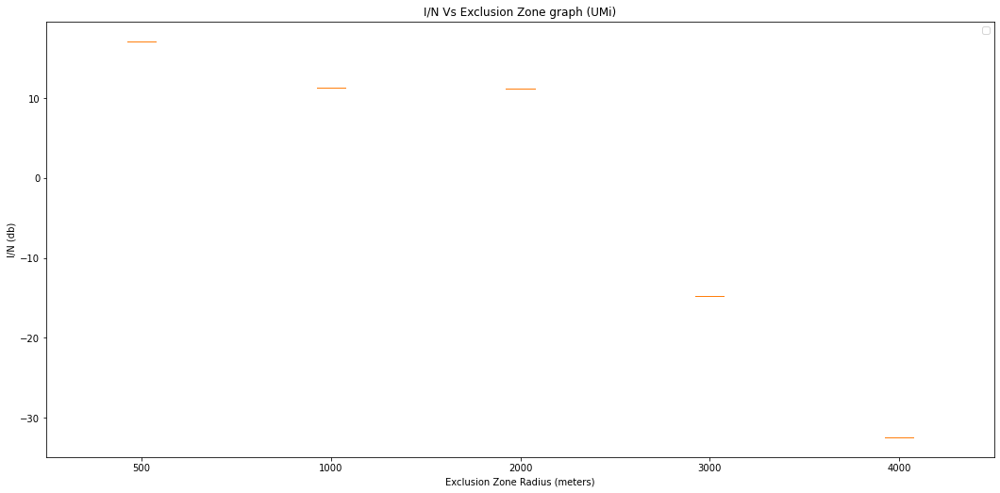

In [33]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
fig.savefig('FSS_8_aggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
# plt.show()

In [34]:
len(pairs_noAverage['UMi'][1][4000] < -15)/10

3.0

In [35]:
len([x for x in pairs_noAverage['UMi'][1][4000] if x < -15])/10

3.0

2022-11-10 18:37:35,978 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


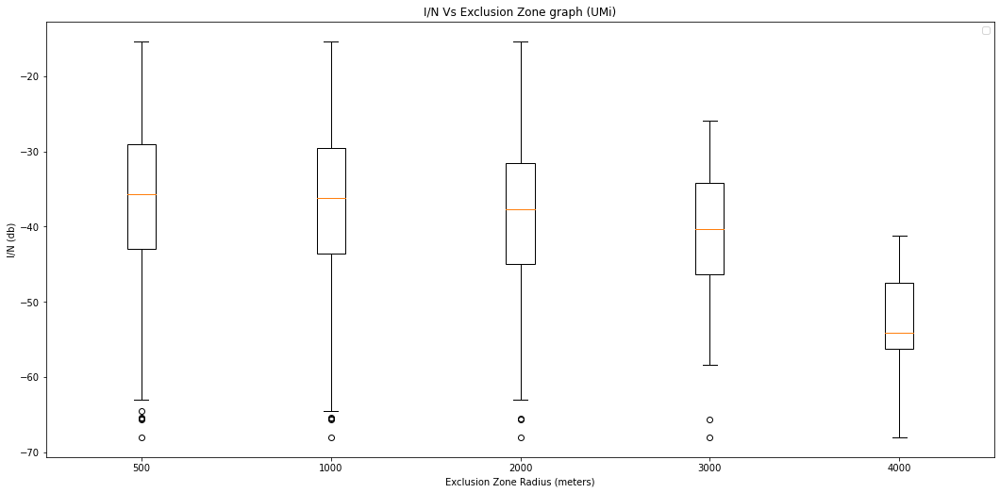

In [36]:
# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -15],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
fig.savefig('FSS_8_-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
# plt.show()

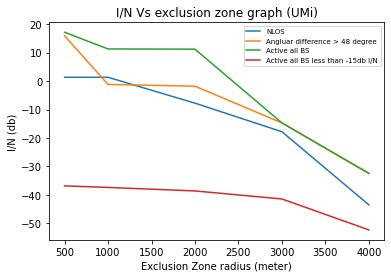

In [37]:
NLOS= {500: 1.3143893456541054,
 1000: 1.3143893456541054,
 2000: -7.76564468265134,
 3000: -17.80716656266888,
 4000: -43.48782797750588}

Higher_48={500: 15.914377772615167,
 1000: -1.191733011056995,
 2000: -1.813963800377728,
 3000: -14.710389512209396,
 4000: -32.43973656906538}

all_BS={500: 17.130176782872827,
 1000: 11.261390934132674,
 2000: 11.191345744750429,
 3000: -14.710389512209396,
 4000: -32.43973656906538}

Neg_5dB = {ex_z: np.mean(np.array([x for x in pairs_noAverage['UMi'][1][ex_z] if x < -15])) for ex_z in pairs_noAverage['UMi'][1] if ex_z > 10}

exclusion_zones = [500, 1000, 2000, 3000, 4000]

plt.plot(exclusion_zones, [NLOS[ex_z] for ex_z in exclusion_zones], label='NLOS')
plt.plot(exclusion_zones, [Higher_48[ex_z] for ex_z in exclusion_zones], label='Angluar difference > 48 degree')
plt.plot(exclusion_zones, [all_BS[ex_z] for ex_z in exclusion_zones], label='Active all BS')
plt.plot(exclusion_zones, [Neg_5dB [ex_z] for ex_z in exclusion_zones] , label='Active all BS less than -15db I/N')

plt.xlabel('Exclusion Zone radius (meter)')
plt.ylabel('I/N (db)')
plt.title('I/N Vs exclusion zone graph (UMi)')
plt.legend(fontsize=7)
# plt.savefig('FSS_8_all_4_together_direc_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [47]:
Neg_5dB = {ex_z: np.mean(np.array([x for x in pairs_noAverage['UMi'][1][ex_z] if x < -15])) for ex_z in pairs_noAverage['UMi'][1] if ex_z > 10}
print(Neg_5dB )

{500: -36.81036671582942, 1000: -37.357758899560174, 2000: -38.58991348829191, 3000: -41.41036891697305, 4000: -52.27658407745132}


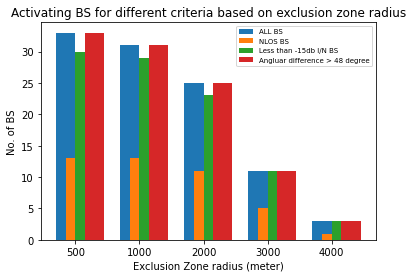

In [38]:
exclusion_zones = [500, 1000, 2000, 3000, 4000]
No_of_BS_NLOS = [13, 13, 11, 5, 1]
No_of_BS_All =[33, 31,25,11,3]
No_of_BS_neg_15db =[30, 29,23,11,3]
No_of_BS_Angular_diff_greater_48= [33, 31,25,11,3]

x = np.arange(len(exclusion_zones))
width = 0.30

rects1= plt.bar(x - width/2 + 0 * width/2, No_of_BS_All, width, label='ALL BS')
rects2 = plt.bar(x - width/2 + 1 * width/2, No_of_BS_NLOS, width, label='NLOS BS')
rects3 = plt.bar(x - width/2 + 2 * width/2, No_of_BS_neg_15db, width, label='Less than -15db I/N BS')
rects4= plt.bar(x - width/2 + 3  * width/2, No_of_BS_Angular_diff_greater_48, width, label='Angluar difference > 48 degree')



# plt.bar_label(rects1, padding=3)
# plt.bar_label(rects2, padding=3

plt.xticks(x, exclusion_zones)
plt.xlabel('Exclusion Zone radius (meter)')
plt.ylabel('No. of BS')
plt.title('Activating BS for different criteria based on exclusion zone radius')
plt.legend(fontsize=7)
# plt.savefig('bar_FSS_8_No_of_BS_VS_EX_Zone_direc_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [39]:
# for key in pairs:
#   plt.scatter(pairs[key][0], pairs[key][1], label=key)

# plt.title('Average I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

In [40]:
# for key in pairs_noAverage:
#   plt.scatter(pairs_noAverage[key][0], pairs_noAverage[key][1], label=key)

# plt.title('I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

2022-11-10 18:37:36,345 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


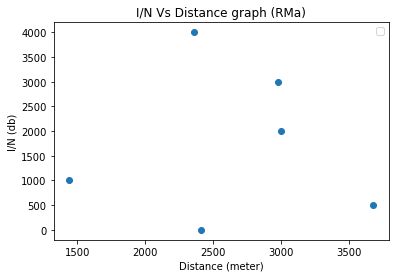

In [41]:
distance, interface_Noise = pairs_noAverage['RMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-10 18:37:36,424 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


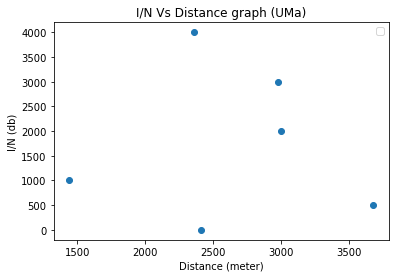

In [42]:
distance, interface_Noise = pairs_noAverage['UMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-10 18:37:36,502 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


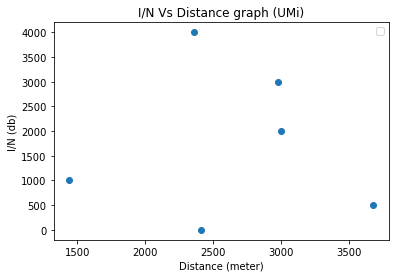

In [43]:
distance, interface_Noise = pairs_noAverage['UMi']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

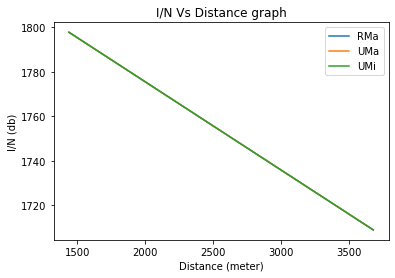

In [44]:
for key in pairs_noAverage:
  distance, interface_Noise = pairs_noAverage[key]
  distance_1D = np.array([])
  for arr in distance:
    distance_1D = np.append(distance_1D, arr)
  interface_Noise_1D = np.array([])
  for arr in interface_Noise:
    interface_Noise_1D = np.append(interface_Noise_1D, arr)
  distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance_1D, interface_Noise_1D)))
  coefficients = np.polyfit(distance_sorted, interface_Noise_sorted,1)
  # y = ax + b, where y is the average of interface_Noise_sorted
  plt.plot(np.array(distance_sorted), np.polyval(coefficients, distance_sorted), label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [45]:
# from matplotlib.lines import Line2D
# output= False
# bs_ue_max_radius = 1000
# bs_ue_min_radius= 1
# base_station_count=33
# fig = plt.figure()
# ax = fig.add_subplot(111)


# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)
# x,y,z = 0,0,0
        
# FSS_X=np.array([])
# FSS_Y=np.array([])
# FSS_Z=np.array([])
# FSS_CHANNELS = []
# for i in range (1):
#     FSS_X = np.append(FSS_X, x)
#     FSS_Y = np.append(FSS_Y, y)
#     FSS_Z = np.append(FSS_Z, z)
#     # 0 means not in use, 1 means in use
#     channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
#     channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
#     FSS_CHANNELS.append(channels_used)
#     if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
# if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)


# BS_X=np.array([])
# BS_Y=np.array([])
# BS_Z=np.array([])

# # Randomly select base stations 
# base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

# for i in base_station_indexes:

#     lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#     bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
#     x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
#     y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
# #         z_BS = R * math.sin(math.radians(lat_BS))

#     BS_X = np.append(BS_X, x_BS - x_FSS)
#     BS_Y = np.append(BS_Y, y_BS - y_FSS)
#     BS_Z = np.append(BS_Z, 0)
#     if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))

# if output: print(BS_X,BS_Y,BS_Z)

# # Create user equipment
# UE_X=np.array([])
# UE_Y=np.array([])
# UE_Z=np.array([])
# UE_CHANNEL=np.array([])
# for p in range (len(BS_X)):
#     UE_X=np.array([])
#     UE_Y=np.array([])
#     UE_Z=np.array([])
#     UE_CHANNEL=np.array([])
#     for i in range(33):
# # number of split regions
# # i is the sector number
#         for j in range(10):
#   # number of UEs per region
#   # j is the number of the UE in one sector
#             bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
#             theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
#             # 0-120, 120-240, 240-360
#             radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

#             x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
#             y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

#             UE_X = np.append(UE_X, x1)
#             UE_Y = np.append(UE_Y, y1)
#             UE_Z = np.append(UE_Z, 1.5)

#             maximum_UEs_per_channel = 4

#             if j > maximum_UEs_per_channel * BS_Channels.channel_count:
#                 raise Exception(f"BS cannot support {j} UEs")

#             count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

#             channel = random.randint(1, BS_Channels.channel_count)

#             while count[channel] >= maximum_UEs_per_channel:
#                 channel = random.randint(1, BS_Channels.channel_count)

#             count[channel] += 1

#             UE_CHANNEL = np.append(UE_CHANNEL, channel)

#             if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
#         if output: print(UE_X,UE_Y,UE_Z)
#     ax.scatter(UE_X,UE_Y,alpha=0.8, s=30,label= 'UE Location', color='green',)
            

# ax.scatter(BS_X,BS_Y,alpha=0.8, s=30,label= 'BS Location', color='red')
# ax.scatter(FSS_X,FSS_Y,alpha=0.8, s=30,label= 'FSS Location',color='yellow')
# legend_handles = [Line2D([0], [0], marker='o', color='w', label='UE Location', markerfacecolor='g'),
#           Line2D([0], [0], marker='o', color='w', label='BS Location', markerfacecolor='r'),
#           Line2D([0], [0], marker='o', color='w', label='FSS Location', markerfacecolor='y')
# ]
          
# plt.legend(handles=legend_handles)

# # plt.legend(loc=2)
# plt.title('FSS, BS and UE Location plot')
# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')

# # fig.savefig('graphcoex.pdf', dpi=100)
# plt.show()


In [46]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
#show plot
plt.show()
# plt.save

KeyError: 1

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
plt.boxplot([box_dict_UMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
# show plot
plt.show()


In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
plt.boxplot([box_dict_RMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('No. of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
# show plot
# plt.show()

 
# show plot
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys][0])
# ax.set_xticklabels([keys[0]])
 
# show plot
plt.show()


In [ ]:
# # Creating dataset
# box_dict_UMi = dict()
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append(interface_Noise[i])

# elevation_dict_UMi = dict()

# for p in range (len(BS_X)):
#     x, y, z = BS_X[p]-FSS_X[0], BS_Y[p]-FSS_Y[0], 10-FSS_Z[0]

#     distance_2D = math.sqrt(((FSS_X[0]-BS_X[p])**2)+((FSS_Y[0]- BS_Y[p])**2)+((FSS_Z[0]-10)**2))

#     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#     fss_phi_difference = abs(15 - phi_bs_es)

    
#     if distance_2D in box_dict_UMi:
#         elevation_dict_UMi[fss_phi_difference] = box_dict_UMi[distance_2D]

# plt.title('I/N Vs Elevation graph (UMi)')
# plt.xlabel('Elevation (degrees)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()


In [ ]:
# elevation_dict_UMi

In [ ]:
#Elevation angles (FSS towards to sky )
fig, ax=plt.subplots()

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

contexts = sorted([context for context in FSS_phi], key=lambda x:FSS_phi[x])
boxplots = []

boxplots=ax.boxplot([pairs_noAverage[context][1] for context in contexts])
# for context in contexts:
#     distance, interface_Noise = pairs_noAverage[context]
#     boxplots.append(plt.boxplot(interface_Noise))

ax.set_xticklabels([FSS_phi[context] for context in contexts])

ax.set_title('I/N Vs Elevation graph')
ax.set_xlabel('Elevation (degrees)')
ax.set_ylabel('I/N (db)')
ax.legend()
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmi.pdf', dpi=100)
plt.show()

In [ ]:
# # Creating dataset
# box_dict_UMa = dict()
# distance, interface_Noise = pairs_noAverage['UMa']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMa:
#         box_dict_UMa[distance[i]] = []
#     box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMa])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMa[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMa)')
# ax.set_xlabel('Distnace of Each BS to FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUMa.pdf', dpi=100)
# plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if not line_of_sight[i]:
        continue   
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi LOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()

In [ ]:
pathloss_UMi